# Свёрточные сети

Сегодня мы детальнее поговорим про общие подходы при обучении нейросетей, и что происходит внутри них.

<img width='400px' src='https://raw.githubusercontent.com/sslotin/universum-dl/43390d26d5f256dcc68a6ba51998bd626b3f6d33/images/cat.png'>

Если попытаться визуализировать то, что выучивает каждый нейрон в нейросети (например, посмотрев, какие входные пиксели на него сильнее всего влияют), то можно увидеть, что чем глубже находится слой, тем более абстрактные фичи он содержит.

Например, в сетях для распознавания картинок первые слои учатся обнаруживать геометрические примитивы: линии, границы, углы. Следующий слой может распознавать простые геометрические фигуры. Следующий распознаёт наличие целых объектов и т. д.

**Weight sharing**. [Эксперименты с дропаутом](https://arxiv.org/abs/1701.05369) показывают, что в линейном слое примерно 99% весов на самом деле можно выкинуть. Логично, что в оптимальной архитектуре не должно быть бесполезных весов — лишние параметры всегда ведут к переобучению. В случае с картинками решение в том, чтобы использовать информацию о расположении пикселей относительно друг друга.

## Свёртки и пуллинги

**Как хранятся картинки**. Когда говорят «изображение», представляйте не прямоугольник, а параллелепипед, высотой которого будет размер каналов. Например, обычные цветные RGB картинки имеют 3 канала: на красный (R), зелёный (G) и синий (B).

0. Введем такую функцию, как **ядро** (англ. **kernel**) — она считает скалярное произведение вектора-входа со своим вектором-параметром.
1. Разобьем исходный паралеллелепипед на сколько-то параллелепипедов одинакового размера вдоль размерности, соответствующей каналам. Они могут пересекаться.
2. Каждый из них «разгладим» в вектор.
3. К кажому такому вектору и применим по очереди каждый кернел (их обычно берут много разных).
4. Положим то, что получилось, в новый параллелепипед.
5. Посчитаем для кажой ячейки какую-нибудь нелинейность. Обычно это ReLU из-за вычислительных причин.

<img width='350px' src='https://raw.githubusercontent.com/sslotin/universum-dl/43390d26d5f256dcc68a6ba51998bd626b3f6d33/images/conv1.png'>

Эта операция называется **свёрткой**. Помимо кернела, в ней есть другие параметры — паддинг (отступ по краям), страйды (шаги по x и y). Также свёртка может быть в 2d и 3d. Посмотрите этот репозиторий, чтобы получше разобраться со свёрточной арифметикой: https://github.com/vdumoulin/conv_arithmetic

![](http://deeplearning.net/software/theano/_images/numerical_padding_strides.gif)

**Пулингом** называют операцию, при которой входной тензор так же разбивается на квадраты (не паралепипеды — операция независима по каждому каналу) и на каждом квадрате считается какая-нибудь редукция (чаще всего максимум или среднее по всем значениям в квадрате), после чего полученные значения записываются на следующий слой в том же порядке.

<img width='400px' src='http://cs231n.github.io/assets/cnn/maxpool.jpeg'>

В свёртках переиспользуется очень много параметров: кернел для каждого фильтра (выходного канала) использует один и тот же вектор-параметр для скалярного умножения. Из-за этого каждый фильтр как правило выучивает какую-то конкретную фичу, вроде наличия какого-либо объекта на своём регионе. Пулинг используют затем для понижения размерности: каждый нейрон после свертки выражает степень уверенности, что на регионе присутствует какой-то объект, и поэтому логично в качестве вероятности наличия объекта на регионе из под-регионов использовать максимум или среднее.

Чаще всего используют свёртки 3x3 со страйдом 2x2 (то есть квадраты перекрываются по 3 крайним пикселям) с пулингом размера 2x2 (не перекрываются).

## Аугментация данных

Аугментацией называется процесс получения новых синтетических данных из имеющихся, чтобы подать в обучение. Это часто (особенно в компьютерном зрении) позволяет улучшить качество модели, не используя дополнительных данных.

Формально, в случае с классификацией, аугментация — это любое преобразование, которое корректно изменяет данные, не меняя их класс.

В случае с картинками, можно попробовать добавить следующие преобразования, которые с какой-то вероятностью будут использоваться во время обучения:

* Поворот на малый угол.
* Добавление шума.
* Обрезание границ и последующее растяжение до исходного размера.
* Горизонтальное отражение (но в нашем случае оно вредно).
* Смещение на небольшое расстояние.

Понятно, что лейбл эти преобразования изменить не должны.

<img src='https://ai2-s2-public.s3.amazonaws.com/figures/2017-08-08/a5da2c3b4174449d13dd746b7d00897c6bc1f334/5-Figure2-1.png' width='500px'>

## Взрывающийся градиент

В сетях происходит очень много чего стохастического: батч формируется случайно, аугментация, рандомизированные слои вроде дропаута, вычислительные ошибки. Это всё может привести к тому, что сеть на какой-то итерации будет очень уверенна в неправильном предсказании и некоторые её параметры получат очень большой градиент. Это может привести к тому, что эти параметры «улетят» куда-то настолько далеко, и после этого сеть будет всегда предсказывать класс, который на этой итерации был правильным. 

Простое решение: просто обрезать градиент в случае, если градиент больше какого-то фиксированного значения. Для этого есть функция `torch.nn.utils.clip_grad_norm_`, которая принимает параметры модели и параметр `threshold`. Она считает норму (длину вектора) градиента и, если она больше `threshold`, нормирует градиенты так, чтобы она была равна `threshold`. Эта функция также возвращает само значение нормы, что может быть очень полезно при анализе обучения (например, если она становится маленькой, то, значит, сеть сходится к какому-то плато).

## Инициализация параметров

Сначала приведем пример плохой инициализации. Пусть мы задали все значения изначально нулями. В таком случае наша модель становится эквивалентна линейной модели — производная по функции потерь одинакова для каждого $w_i$, таким образом, все веса имеют одинаковые значения и в последующей итерации, что делает нейроны в сети симметричными.

Подход получше — инициализировать каждый вес случайно. Но тут нужно быть осторожным — если задать их слишком большими, то сеть может быть изначально очень уверенна в своих предсказаниях, и подвинуть параметры оттуда будет очень трудно.

Решение следующее. С точки зрения слоя, ему на вход подается сэмпл из какого-то распределения, и он под это распределение подстраивается. В нейросетях размеры слоев достаточно большие, чтобы в них работали законы статистики, все разработчики фреймворках условились инициализировать веса всех слоев в предположении, что на вход подаются данные из какого-то распределения со средним 0 и дисперсией 1, и на выходе должно получиться какое-то распределение со средним тоже 0 и дисперсией 1. Чаще всего изначальные веса берут либо из нормального, либо из равномерного распределения, «обрезанного» так, чтобы дисперсия каждого выходного значения получилась единичной.

Аналогично нужно поступать со входными векторными данными: нормализовывать. Это будет важно при работе с изображениями: не надо подавать на вход вектора с элементами от 0 до 255. Самое простое рабочее решение — нормализовать вход, поделив его на 255.

## Минутка физики

Потребляемая энергия в сети с переменным током в единицу времени считается по формуле

$$W = CV^2f$$

где $C$ означает емкость сети, $V$ означает напряжение, а $f$ — частоту. В случае с процессорами, это именно та частота, с которой выполняются элементарные операции, например сложение.

<img width='350px' src='https://i.ibb.co/yhsGRJK/Screenshot-from-2019-02-08-14-52-07.png'>

Однако, если мы сделаем сеть из двух параллельно подключенных процессоров, работающих на половинной частоте, мы можем получить сеть, потребляющую ~40% изначальной энергии, делающую то же количество полезной работы — то же суммарное количество процессорных тактов:

<img width='450px' src='https://i.ibb.co/WgLCxxL/Screenshot-from-2019-02-08-14-52-18.png'>

Поэтому для хорошо распараллеливаемых операций используют другой тип вычислительных устройств, в которых не 4-8 быстрых (3-4 GHz) процессоров, а несколько тысяч медленных (~1GHz).

## Device-agnostic код

К любой модели или тензору в PyTorch можно применить `.cuda()` и `.cpu()`, чтобы перевести тензор на память GPU или в оперативную память соответственно. Но если мы будем писать такой код, нам будет довольно проблематично портировать его на другие машины, где, например, нет GPU (например, если вы хотите скачать тетрадку с colab к себе и запустить).

Многие фреймворки позволяют абстрагироваться от устройства конкретных вычислительных устройств. В PyTorch для этого есть объект `torch.device`, который позволяет явно задавать, на каком устройстве хранить тензор или модель.

In [ ]:
import torch
import torch.nn as nn

from time import time

device = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')  # используй первую GPU (номеруются с нуля)

X = torch.randn(5, 100, device=device)  # создай матрицу на этом устройстве
# альтернативно: X = X.to(device)
print(X.shape)

# создадим какую-нибудь модель
model = nn.Sequential(
    nn.Linear(100, 20),
    nn.ReLU(),
    nn.Linear(20, 8)
)

model = model.to(device)  # переведи параметры модели на это устройство

start = time()
print(model(X))
print(time() - start)

torch.Size([5, 100])
tensor([[-0.0354, -0.1498,  0.1132,  0.4407, -0.6501, -0.4739,  0.3142,  0.1068],
        [ 0.0155, -0.2626, -0.0800,  0.6190, -1.1796, -0.8135,  0.8577,  0.4815],
        [-0.0904, -0.1428, -0.0800,  0.2019, -0.2751, -0.1418,  0.3852,  0.2318],
        [-0.1888, -0.1075,  0.2622,  0.2127, -0.4304, -0.5905,  0.5774,  0.1537],
        [ 0.0898, -0.2340,  0.0419,  0.2121, -0.2996, -0.4641,  0.5775,  0.0205]],
       device='cuda:0', grad_fn=<AddmmBackward0>)
0.1429753303527832


In [ ]:
!nvidia-smi

Fri Nov 12 21:43:55 2021       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 495.44       Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla P100-PCIE...  Off  | 00000000:00:04.0 Off |                    0 |
| N/A   34C    P0    32W / 250W |   1013MiB / 16280MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

# Колоризация изображений

Начнём практическую часть. Обучим autoencoder-like сеть, которая учится восстанавливать изображение по его черно-белой версии. В качестве лосса будем так же использовать какую-нибудь меру расстояния между изображениями (например, l1 или l2).

Тот пайплайн, что у нас получится, с минимальными изменениями можно будет также использовать и для других подобных задач, связанных с восстановлением изображений после каких-либо необратимых преобразований, например после подмешивании шума (denoising autoencoder) или понижения размера (DeepHD).

![](https://camo.githubusercontent.com/c5f95c94d70a3e52561c1d0591e84a5e3b86eb74/687474703a2f2f726963687a68616e672e6769746875622e696f2f636f6c6f72697a6174696f6e2f7265736f75726365732f696d616765732f6e65745f6469616772616d2e6a7067)

In [ ]:
import torch
import torch.nn as nn

from torch.utils.data import Dataset, DataLoader
from torchvision import transforms
import torchvision.models as models

from torchsummary import summary

import numpy as np

import matplotlib.pyplot as plt
%matplotlib inline

Для начала скачаем данные. Годятся вообще любые изображения, не обязательно из какого-то изветсного датасета. Этой командой можно скачать и распакавать фотографии с одной школы по программированию, проходившей этим летом.

In [ ]:
# !wget http://sereja.me/f/universum_compressed.tar
# !tar xf universum_compressed.tar

--2021-11-12 21:43:56--  http://sereja.me/f/universum_compressed.tar
Resolving sereja.me (sereja.me)... 213.159.215.132
Connecting to sereja.me (sereja.me)|213.159.215.132|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 72028160 (69M) [application/x-tar]
Saving to: ‘universum_compressed.tar’

universum_compresse 100%[===================>]  68.69M  5.28MB/s    in 16s     

2021-11-12 21:44:12 (4.37 MB/s) - ‘universum_compressed.tar’ saved [72028160/72028160]



Есть два подхода к работе с данными:

1. Сначала преобразовать все имеющиеся данные к виду, который принимает нейросеть (сразу к тензорам одинакового размера).
2. Хранить сырые данные и преобразование препроцессинга (функцию) и собирать батчи на лету.

Если это не что-то совсем простое, то второй вариант предпочтительнее, так как он не требует дополнительной памяти (датасеты могут быть большими), времени на векторизацию датасета, а так же сбор батча «на лету» позволяет там же делать аугментацию.

Для этого в PyTorch есть две абстракции: `Dataset` и `DataLoader`.

`Dataset` — абстрактный класс, от которого нужно отнаследовать класс датасета, который мы напишем. В нём должны быть определён конструктор (в нём обычно загружаются в память сырые данные, которые лежат где-то на диске, а также сохраняется какая-нибудь другая информация), метод `__len__` (должен вернуть размер датасета) и `__getitem__`, который должен по номеру сэмпла вернуть его в виде тензора (возможно, произведя какой-нибудь препроцессинг).

In [ ]:
# tqdm -- это маленькая библиотечка для прорисовывания progress bar-ов прямо в питоне

from tqdm import tqdm
from time import sleep

# for i in tqdm(range(10)):
#     sleep(0.5)

## ColorizationDataset

In [ ]:
import os
from PIL import Image

class ColorizationDataset(Dataset):
    def __init__(self, path, transform_x, transform_y):
        self.transform_x = transform_x # black-white with augmentation
        self.transform_y = transform_y # colored with augmentation
      
        filenames = []
        for root, dirs, files in os.walk(path):
            for file in files:
                if file.endswith('.jpg') or file.endswith('.JPG'):
                    filenames.append(os.path.join(root, file))

        self.images = []
        for filename in tqdm(filenames):
            try:
                with Image.open(filename) as image:
                    self.images.append(image.copy())
            except:
                pass
                #print('Could not load image:', filename)

    def __len__(self):
        return len(self.images)

    def __getitem__(self, idx):
        img = self.images[idx]
        Y = self.transform_y(img)
        X = self.transform_x(Y)
        return X, Y

## Transform and augmentation 

Чтобы подавать картинки на вход нейросети, нужно их перевести в тензоры, причём одинакового размера.

In [ ]:
transform_all = transforms.Compose([
    # вырежем случайный квадратик
    transforms.RandomResizedCrop(128),
    # горизонтально перевернем -- изображение останется валидным
    # transforms.RandomHorizontalFlip(),
    # что бы ещё поделать, чтобы увеличить размер датасета?
    # Рандомный поворот 
    transforms.RandomRotation(degrees=(-45, 45)),
    # Отражение по вертикали
    transforms.RandomVerticalFlip(p=0.5),
    transforms.ToTensor(),
])

def to_grayscale(x):
    return (x[0] * 0.299 + x[1] * 0.587 + x[2] * 0.114).view(1, 128, 128)

    # минутка эволюционной биологии: как вы думаете, почему коэффициенты именно такие?

Здесь `transform_all` и `to_grayscale` являются функциями (формально, первый является функтором), которые мы передадим дальше в `DataLoader`, который оборачивает датасет и позволяет итерироваться по нему по батчам, а также реализует разные полезные функции вроде перемешивания данных после каждой эпохи.

In [ ]:
dataset = ColorizationDataset('universum-photos', to_grayscale, transform_all)
loader = DataLoader(dataset, batch_size=64, shuffle=True)

100%|██████████| 1254/1254 [00:01<00:00, 877.24it/s]


In [ ]:
val_image = ColorizationDataset('val', to_grayscale, transform_all) 

100%|██████████| 1/1 [00:00<00:00, 490.33it/s]


**Skip-connection**. Иногда бывает полезно присоединить к выходу какого-то слоя его вход, чтобы следующий получил такую же, неизменённую копию. Здесь мы поступим именно так: подадим исходное черно-белое изображение в какую-то одну часть сети, которая сконцентрируется на определении цвета, а затем припишем последним слоем её выход и отправим дальше другому модулю, который уже раскрасит это исходное изображение. От простоты `nn.Sequential`, правда, уже придётся отказаться, и нужно написать свой класс.

Глубокие сети очень часто состоят из повторяющихся блоков, отличающихся только размерностью (в данном случае — количеством фильтров). Чтобы сократить количество кода и уменьшить вероятность багов, блоки можно обернуть в одну функцию, возвращающую мини-модель из нескольких слоев.

Концептуальный пример:

# Base

In [ ]:
def Block_with_pooling(channels_in, channels_out):
    return nn.Sequential(
        nn.Conv2d(channels_in, channels_out, (3, 3), padding=1), # по дефолту stride = 1, а следовательно размерность не меняется
            #                                      # меняем мы только количество каналов
        nn.MaxPool2d((2, 2), stride=(2,2)), # уменьшаем и высоту, и ширину, в два раза
        nn.BatchNorm2d(channels_out), # нормализация градиентов по батчу
        # nn.Dropout(),
        nn.LeakyReLU()
    )

def Block(channels_in, channels_out):
    return nn.Sequential(
        nn.Conv2d(channels_in, channels_out, (3,3), padding=1),
        nn.BatchNorm2d(channels_out), # нормализация градиентов по батчу
        # nn.Dropout(),
        nn.LeakyReLU()
    )

![](https://camo.githubusercontent.com/c5f95c94d70a3e52561c1d0591e84a5e3b86eb74/687474703a2f2f726963687a68616e672e6769746875622e696f2f636f6c6f72697a6174696f6e2f7265736f75726365732f696d616765732f6e65745f6469616772616d2e6a7067)

In [ ]:
class Colorizer(nn.Module):
    def __init__(self):
        super().__init__()
        
        # Преобразования чёрно-белой картинки
        self.preconcat = nn.Sequential(
            Block_with_pooling(1, 64),
            Block_with_pooling(64, 128),
            Block_with_pooling(128, 256),
            Block_with_pooling(256, 512),
            Block(512, 512),
            Block(512, 512),
            Block(512, 512),
            #_______
            nn.Upsample(scale_factor=2), # увеличиваем высоту и ширину в два раза
            Block(512, 256),
            nn.Upsample(scale_factor=2), 
            Block(256, 128),
            nn.Upsample(scale_factor=2),
            Block(128, 64),
            nn.Upsample(scale_factor=2),
            Block(64, 64),
        )
         
        # для раскраски исходной картинки
        self.postconcat = nn.Sequential(         # эту сетку можно особо не увеличивать - она не должна быть очень умной
            nn.Conv2d(65, 32, (3, 3), padding=1),# подумайте, откуда у автора тут 65 -> 128x128x65
            nn.LeakyReLU(), # nn.LeakyRelu()
            nn.Conv2d(32, 3, (3, 3), padding=1),
            nn.Sigmoid()
        )
    
    def forward(self, x):
        # Набором свёрток и пулингов переводич исзодное чб изображение в вектор латентного пространства,
        # потом из этого вектора латентного пространства возращает тензор N числом каналов
        h = self.preconcat(x)
        # исходное чб изображение -- просто дополнительным слоем
        h = torch.cat((h, x), 1) # Конкатинируем тензор h с исходным чб изображением
        # Передаём N+1-канальный тензор, который будеи преобразован в трёхканальное изображение
        h = self.postconcat(h)
        return h

## Weights init

In [ ]:
def weights_init(m):
  classname = m.__class__.__name__

  if classname.find('Conv') != -1:
    torch.nn.init.normal_(m.weight, 0.0, 0.2)
  elif classname.find('BatchNorm') != -1:
    torch.nn.init.normal_(m.weight, 1.0, 0.02)
    torch.nn.init.zeros_(m.bias)

In [ ]:
model = Colorizer().to(device)
model.apply(weights_init)

for X, _ in loader:
  print(X.shape)
  with torch.no_grad():
    x = X.to(device)
    print(model(x)[0])
    del x
    torch.cuda.empty_cache()
    break

torch.Size([64, 1, 128, 128])
tensor([[[1.7343e-01, 7.8545e-03, 3.9349e-04,  ..., 6.4528e-01,
          3.1469e-01, 6.8654e-01],
         [9.3636e-01, 9.9936e-01, 9.9538e-01,  ..., 9.8343e-01,
          5.9658e-01, 5.3203e-01],
         [9.7450e-01, 9.9776e-01, 9.8692e-01,  ..., 9.9662e-01,
          7.8444e-01, 2.6298e-01],
         ...,
         [4.9111e-01, 9.8381e-01, 9.6162e-01,  ..., 9.5134e-01,
          2.9693e-01, 6.1348e-01],
         [9.0226e-01, 9.9845e-01, 9.9952e-01,  ..., 9.9720e-01,
          6.6729e-01, 7.6714e-01],
         [8.4031e-01, 9.4319e-01, 9.8707e-01,  ..., 9.5860e-01,
          8.6440e-01, 9.3590e-01]],

        [[5.4679e-01, 5.4800e-01, 9.1246e-01,  ..., 9.4716e-01,
          7.9088e-01, 3.4253e-01],
         [9.9589e-01, 9.8916e-01, 9.9713e-01,  ..., 9.9731e-01,
          6.0170e-01, 8.7851e-01],
         [9.9847e-01, 8.5623e-01, 9.9614e-01,  ..., 9.9674e-01,
          4.1509e-01, 5.6236e-01],
         ...,
         [9.9198e-01, 9.8704e-01, 9.7214e-01,  ..

В подобных нечётко поставленных задачах важно смотреть не цифры, а на реальные примеры.


In [ ]:
def to_numpy_image(img):
    # tl;dr: PyTorch хочет (3, 128, 128), а plt.imshow хочет (128, 128, 3)
    # есть два популярных формата для цветных картинок:
    #  1. где размерность, соответствующая каналам, идёт последней
    #  2. где размерность, соответствующая каналам, идёт первой
    # при работе с нейросетями удобен первый подход -- так запрашиваемая
    # при вычислениях память идёт последовательно, и из-за кэширования
    # операции свёртки работают быстрее
    # второй подход удобнее при уже работе с устройством, которое эти картинки показывает
    # -- удобно на три лампочки послать сразу три последовательно идущих байта
    return img.detach().cpu().view(3, 128, 128).transpose(0, 1).transpose(1, 2).numpy() # пересносит из формата на gpu в numpy
          # detach - открепляем изображение от графа, чтобы дальше автогадиент торча на неё не смотрел
          # cpu - переносим на cpu, чтобы дальше работать с numpy
          # view(3, 128, 128) - переносим в формат, когда нет первой(батчевой размерности)
          # transpose(0, 1) -> (128, 3, 128) 
          # transpose(1, 2) -> (128, 128, 3)

In [ ]:
def plot_to_compare(model):
  #(  вывести пример колоризации -- см код ниже)
  img_gray, img_true = val_image[0]
  img_pred = model(img_gray.to(device).view(1, 1, 128, 128))
  img_pred = to_numpy_image(img_pred)
  # теперь это numpy-евский ndarray размера (128, 128, 3)
  plt.figure(figsize=(10,10))
        
  plt.subplot(141)
  plt.axis('off')
  plt.set_cmap('Greys')
  plt.imshow(img_gray.reshape((128, 128)))

  plt.subplot(142)
  plt.axis('off')
  plt.imshow(img_pred.reshape((128, 128, 3)))

  plt.subplot(143)
  plt.axis('off')
  plt.imshow(to_numpy_image(img_true))

  plt.show()

## Train

In [ ]:
num_epochs = 2500
lr = 2e-3
device = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')

model = Colorizer().to(device)
model.apply(weights_init)
optimizer = torch.optim.Adam(model.parameters(), lr=lr, betas=(0.5, 0.999))
criterion = nn.SmoothL1Loss() # тут можно поиграться с лоссами

summary(model, input_size=(1, 128, 128))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 64, 128, 128]             640
         MaxPool2d-2           [-1, 64, 64, 64]               0
       BatchNorm2d-3           [-1, 64, 64, 64]             128
         LeakyReLU-4           [-1, 64, 64, 64]               0
            Conv2d-5          [-1, 128, 64, 64]          73,856
         MaxPool2d-6          [-1, 128, 32, 32]               0
       BatchNorm2d-7          [-1, 128, 32, 32]             256
         LeakyReLU-8          [-1, 128, 32, 32]               0
            Conv2d-9          [-1, 256, 32, 32]         295,168
        MaxPool2d-10          [-1, 256, 16, 16]               0
      BatchNorm2d-11          [-1, 256, 16, 16]             512
        LeakyReLU-12          [-1, 256, 16, 16]               0
           Conv2d-13          [-1, 512, 16, 16]       1,180,160
        MaxPool2d-14            [-1, 51

Loaded model
Epoch 4 	 Loss: min = 0.0005730403354391456; average = 0.0006928724105819128; max = 0.0010152580216526985
Epoch 5 	 Loss: min = 0.0005359547212719917; average = 0.0006440687175199855; max = 0.0007272979128174484


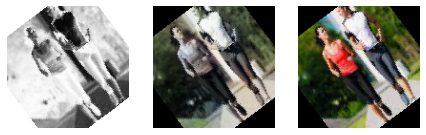

KeyboardInterrupt: ignored

In [ ]:
PATH = "model.pt"

try:
  checkpoint = torch.load(PATH)
  model.load_state_dict(checkpoint['model_state_dict'])
  optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
  last_epoch = checkpoint['epoch']
  history = checkpoint['history']
  print('Loaded model')
except:
  history = {}
  last_epoch = 0

for epoch in range(last_epoch, num_epochs):
    cur_history = []
    for x, y in loader:
        # теперь сами:
        # 0. распакавать данные на нужное устройство
        x = x.to(device)
        y = y.to(device)

        # 1. сбросить градиент
        optimizer.zero_grad()

        # 2. прогнать данные через сеть
        pred = model(x)

        # 3. посчитать loss
        loss = criterion(pred, y)        

        # 4. залоггировать его куда-нибудь
        cur_history.append(loss.item())

        # 5. сделать .backward()
        loss.backward()

        # 6. optimizer.step()
        optimizer.step()
    
        # Освобождение памяти
        del pred
        del x
        del y
        torch.cuda.empty_cache() # Чтобы GPU не заполнялся мусором
    
    history[epoch] = np.average(cur_history)
    print(f'Epoch {epoch} \t Loss: min = {np.min(cur_history)}; average = {np.average(cur_history)}; max = {np.max(cur_history)}')
    # Off dropouts and batchNorm
    model.eval()

    if epoch % 5 == 0:
      plot_to_compare(model)

    # On dropouts and batchNorm
    model.train()

    # save checkpoint
    torch.save({'epoch': epoch + 1,
                'model_state_dict': model.state_dict(),
                'optimizer_state_dict': optimizer.state_dict(),
                'history': history,
                }, PATH)

## Loss graph

Text(0.5, 0, 'Epoch')

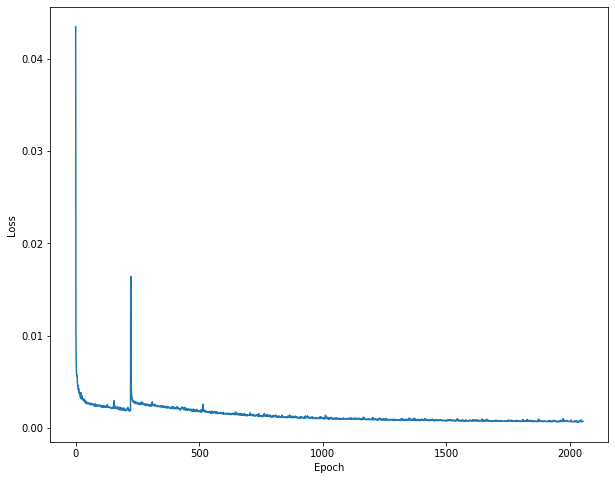

In [ ]:
lists = sorted(history.items()) # sorted by key, return a list of tuples
x, y = zip(*lists)

plt.figure(figsize=(10,8))
plt.plot(x, y)
plt.ylabel('Loss')
plt.xlabel('Epoch')

## Colorize image by base model

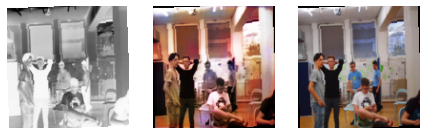

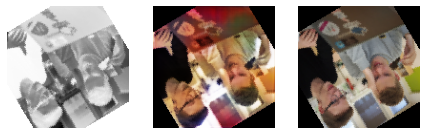

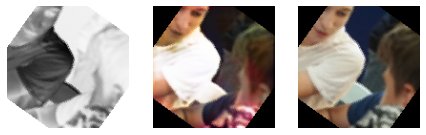

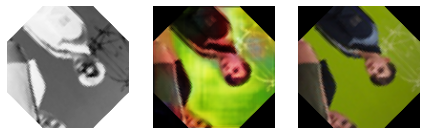

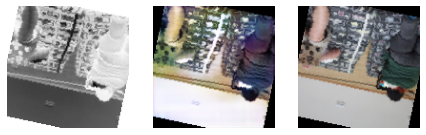

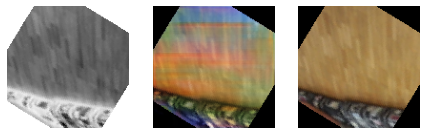

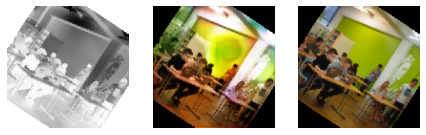

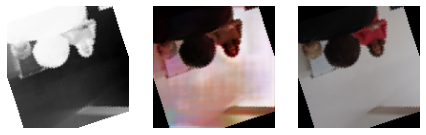

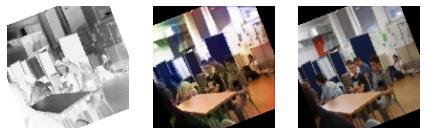

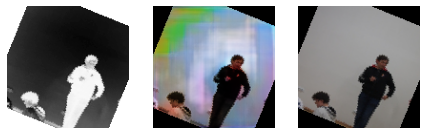

In [ ]:
for t in range(10):
    img_gray, img_true = dataset[t]
    model.eval()
    img_pred = model(img_gray.to(device).view(1, 1, 128, 128))
    img_pred = to_numpy_image(img_pred)
    # теперь это numpy-евский ndarray размера (128, 128, 3)
    plt.figure(figsize=(10,10))
    
    plt.subplot(141)
    plt.axis('off')
    plt.set_cmap('Greys')
    plt.imshow(img_gray.reshape((128, 128)))

    plt.subplot(142)
    plt.axis('off')
    plt.imshow(img_pred.reshape((128, 128, 3)))

    plt.subplot(143)
    plt.axis('off')
    plt.imshow(to_numpy_image(img_true))
    
    plt.show()

***Вроде получилось неплохо, но иногда слишком яркие цвета, иногда получается радужные цвета там, где их быть не должно***

# ResNet

In [ ]:
resnet = models.resnet18(num_classes=111) 
nn.Sequential(*list(resnet.children()))

Sequential(
  (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (2): ReLU(inplace=True)
  (3): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (4): Sequential(
    (0): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    )
    (1): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (conv2): Con

In [ ]:
class ColorizerResNet(nn.Module):
  def __init__(self):
    super().__init__()

    resnet = models.resnet18(num_classes=111) 
    # first layer to accept single-channel (grayscale) input
    resnet.conv1.weight = nn.Parameter(resnet.conv1.weight.sum(dim=1).unsqueeze(1))
    
    self.preconcat = nn.Sequential(  
      nn.Sequential(*list(resnet.children())[0:6]),
      Block(128, 128),
      nn.Upsample(scale_factor=2),
      Block(128, 64),
      nn.Upsample(scale_factor=2),
      Block(64, 64),
      nn.Upsample(scale_factor=2),
    )

    self.postconcat = nn.Sequential(
        nn.Conv2d(65, 32, (3, 3), padding=1),# подумайте, откуда у автора тут 65 -> 128x128x65
        nn.LeakyReLU(),
        nn.Conv2d(32, 3, (3, 3), padding=1),
        nn.Sigmoid()
        )

  def forward(self, x):
    h = self.preconcat(x)
    h = torch.cat((h, x), 1) # Конкатинируем тензор h с исходным чб изображением
    # Передаём N+1-канальный тензор, который будеи преобразован в трёхканальное изображение
    h = self.postconcat(h)
    return h

## Train

In [ ]:
num_epochs = 2500
lr = 2e-3
device = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')

resNet = ColorizerResNet().to(device)
resNet.apply(weights_init)
optimizer = torch.optim.Adam(resNet.parameters(), lr=lr, betas=(0.5, 0.999))
criterion = nn.MSELoss() # тут можно поиграться с лоссами

summary(resNet, input_size=(1, 128, 128))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1           [-1, 64, 64, 64]           3,136
       BatchNorm2d-2           [-1, 64, 64, 64]             128
              ReLU-3           [-1, 64, 64, 64]               0
         MaxPool2d-4           [-1, 64, 32, 32]               0
            Conv2d-5           [-1, 64, 32, 32]          36,864
       BatchNorm2d-6           [-1, 64, 32, 32]             128
              ReLU-7           [-1, 64, 32, 32]               0
            Conv2d-8           [-1, 64, 32, 32]          36,864
       BatchNorm2d-9           [-1, 64, 32, 32]             128
             ReLU-10           [-1, 64, 32, 32]               0
       BasicBlock-11           [-1, 64, 32, 32]               0
           Conv2d-12           [-1, 64, 32, 32]          36,864
      BatchNorm2d-13           [-1, 64, 32, 32]             128
             ReLU-14           [-1, 64,

Loaded resNet
Epoch 688 	 Loss: min = 0.0036275151651352644; average = 0.08358834589307662; max = 0.44874903559684753
Epoch 689 	 Loss: min = 0.007981942035257816; average = 0.037399641587398946; max = 0.18159541487693787
Epoch 690 	 Loss: min = 0.005521388724446297; average = 0.007192141230916604; max = 0.009027198888361454


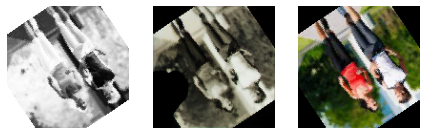

Epoch 691 	 Loss: min = 0.00509685231372714; average = 0.006437742325942963; max = 0.008666398003697395
Epoch 692 	 Loss: min = 0.0049524735659360886; average = 0.005984079441986978; max = 0.008723507635295391
Epoch 693 	 Loss: min = 0.004384650848805904; average = 0.005754196550697088; max = 0.007496801670640707
Epoch 694 	 Loss: min = 0.004461011383682489; average = 0.0057009189913515; max = 0.0075447894632816315
Epoch 695 	 Loss: min = 0.004380817525088787; average = 0.005604809790384024; max = 0.00798163004219532


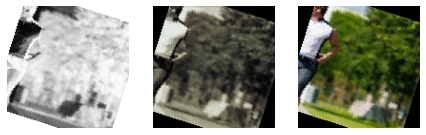

Epoch 696 	 Loss: min = 0.004400854930281639; average = 0.0053026007662992924; max = 0.006932440213859081
Epoch 697 	 Loss: min = 0.003975857049226761; average = 0.005540830286918208; max = 0.008591234683990479
Epoch 698 	 Loss: min = 0.00417944323271513; average = 0.005352874140953645; max = 0.006547273602336645
Epoch 699 	 Loss: min = 0.004152837675064802; average = 0.005446011258754879; max = 0.006740675773471594
Epoch 700 	 Loss: min = 0.004291115328669548; average = 0.0054837457137182355; max = 0.007490179501473904


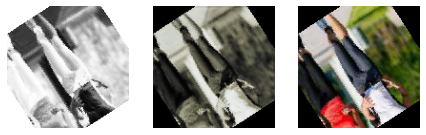

Epoch 701 	 Loss: min = 0.00441309018060565; average = 0.0053328714275266975; max = 0.008389764465391636
Epoch 702 	 Loss: min = 0.003587273880839348; average = 0.005283169593894854; max = 0.007953750900924206
Epoch 703 	 Loss: min = 0.004200999159365892; average = 0.005187277711229399; max = 0.006637352518737316
Epoch 704 	 Loss: min = 0.003948314115405083; average = 0.00516864363453351; max = 0.006635788828134537
Epoch 705 	 Loss: min = 0.003878290532156825; average = 0.005085657016024925; max = 0.006433899514377117


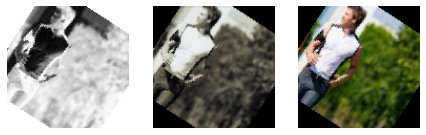

Epoch 706 	 Loss: min = 0.0036269768606871367; average = 0.005054311201092787; max = 0.006456639617681503
Epoch 707 	 Loss: min = 0.003717089304700494; average = 0.00527792471984867; max = 0.006910715252161026
Epoch 708 	 Loss: min = 0.0039011966437101364; average = 0.005072255124105141; max = 0.0067583355121314526
Epoch 709 	 Loss: min = 0.004295460879802704; average = 0.005284104583552107; max = 0.006652585230767727
Epoch 710 	 Loss: min = 0.003785565495491028; average = 0.005281780555378646; max = 0.008135106414556503


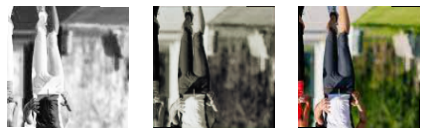

Epoch 711 	 Loss: min = 0.00433643814176321; average = 0.005354554101359099; max = 0.006884870119392872
Epoch 712 	 Loss: min = 0.004309367388486862; average = 0.005043875862611458; max = 0.0062845549546182156
Epoch 713 	 Loss: min = 0.004159336909651756; average = 0.005340066447388381; max = 0.006698803510516882
Epoch 714 	 Loss: min = 0.0036236026789993048; average = 0.005263670391286723; max = 0.006563594099134207
Epoch 715 	 Loss: min = 0.004072428680956364; average = 0.005272521346341819; max = 0.007078885100781918


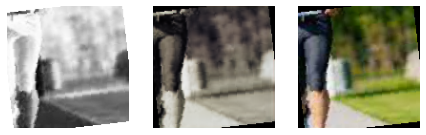

Epoch 716 	 Loss: min = 0.003692891215905547; average = 0.005038714487454854; max = 0.006718456745147705
Epoch 717 	 Loss: min = 0.003739268984645605; average = 0.00523525987227913; max = 0.007677143439650536
Epoch 718 	 Loss: min = 0.0035312464460730553; average = 0.005032453176681884; max = 0.006491838954389095
Epoch 719 	 Loss: min = 0.003994817845523357; average = 0.005407435790402815; max = 0.007876457646489143
Epoch 720 	 Loss: min = 0.003681484144181013; average = 0.005061179195763543; max = 0.0072581893764436245


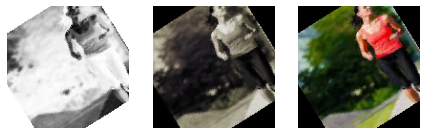

Epoch 721 	 Loss: min = 0.004004232585430145; average = 0.005278946831822395; max = 0.006663547363132238
Epoch 722 	 Loss: min = 0.004234981257468462; average = 0.005177885410375893; max = 0.006655117031186819
Epoch 723 	 Loss: min = 0.004239530302584171; average = 0.005079394934000447; max = 0.006378573831170797
Epoch 724 	 Loss: min = 0.00408434122800827; average = 0.005259628524072468; max = 0.006537958048284054
Epoch 725 	 Loss: min = 0.00409034825861454; average = 0.00516007820260711; max = 0.007221521344035864


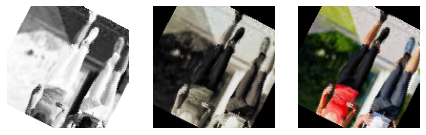

Epoch 726 	 Loss: min = 0.0034255057107657194; average = 0.005039194817072712; max = 0.007075160276144743
Epoch 727 	 Loss: min = 0.0041971998289227486; average = 0.005147519608726725; max = 0.006603302899748087
Epoch 728 	 Loss: min = 0.004187975078821182; average = 0.005098151421407238; max = 0.006587387528270483
Epoch 729 	 Loss: min = 0.003965809475630522; average = 0.005177944607567042; max = 0.008562951348721981
Epoch 730 	 Loss: min = 0.0037373551167547703; average = 0.004979298479156569; max = 0.006944749504327774


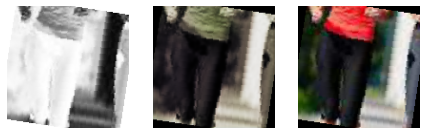

Epoch 731 	 Loss: min = 0.003942007198929787; average = 0.004985068371752277; max = 0.006261828355491161
Epoch 732 	 Loss: min = 0.003587372601032257; average = 0.005196071113459766; max = 0.006829401012510061
Epoch 733 	 Loss: min = 0.003979058470577002; average = 0.005059220653492957; max = 0.006508153863251209
Epoch 734 	 Loss: min = 0.003972935024648905; average = 0.0050335559353698045; max = 0.006908325478434563
Epoch 735 	 Loss: min = 0.0038150735199451447; average = 0.005037033843109384; max = 0.007047384046018124


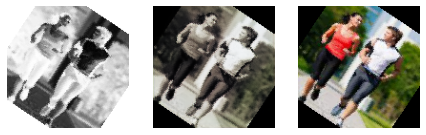

Epoch 736 	 Loss: min = 0.004012451972812414; average = 0.005114510946441442; max = 0.0066177621483802795
Epoch 737 	 Loss: min = 0.0038427552208304405; average = 0.004999351309379563; max = 0.006314971949905157
Epoch 738 	 Loss: min = 0.003129310440272093; average = 0.005012473004171625; max = 0.006567548494786024
Epoch 739 	 Loss: min = 0.0034516050945967436; average = 0.005021512726671062; max = 0.006747662089765072
Epoch 740 	 Loss: min = 0.0034397272393107414; average = 0.0048398361541330814; max = 0.006560905836522579


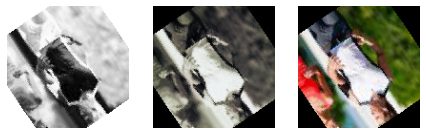

Epoch 741 	 Loss: min = 0.0038066133856773376; average = 0.004991886933567002; max = 0.006679566577076912
Epoch 742 	 Loss: min = 0.003897288581356406; average = 0.004962365739629604; max = 0.006712868809700012
Epoch 743 	 Loss: min = 0.0036955145187675953; average = 0.004870540855336003; max = 0.006969240959733725
Epoch 744 	 Loss: min = 0.003970034886151552; average = 0.004974646552000195; max = 0.0074632070027291775
Epoch 745 	 Loss: min = 0.003662596456706524; average = 0.005015095695853233; max = 0.007751585450023413


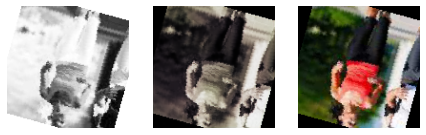

Epoch 746 	 Loss: min = 0.0033362633548676968; average = 0.00492154476523865; max = 0.006758595816791058
Epoch 747 	 Loss: min = 0.0038349293172359467; average = 0.00492091772321146; max = 0.006773245986551046
Epoch 748 	 Loss: min = 0.004139067605137825; average = 0.005007298837881535; max = 0.007133872713893652
Epoch 749 	 Loss: min = 0.003768341150134802; average = 0.005204992921790108; max = 0.010828772559762001
Epoch 750 	 Loss: min = 0.0032504177652299404; average = 0.004914451361401007; max = 0.0066355206072330475


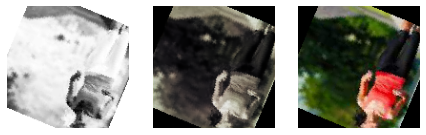

Epoch 751 	 Loss: min = 0.004293437581509352; average = 0.005187891161767766; max = 0.006072194315493107
Epoch 752 	 Loss: min = 0.004048808477818966; average = 0.004886830283794552; max = 0.005927461199462414
Epoch 753 	 Loss: min = 0.0038442332297563553; average = 0.004929199465550482; max = 0.006071718409657478
Epoch 754 	 Loss: min = 0.003893843851983547; average = 0.0049014763499144465; max = 0.006941583007574081
Epoch 755 	 Loss: min = 0.003437285777181387; average = 0.00490432811784558; max = 0.006382888648658991


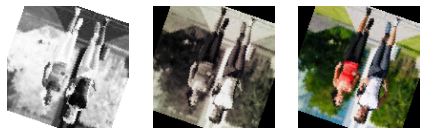

Epoch 756 	 Loss: min = 0.004120801575481892; average = 0.0049389227642677724; max = 0.006478270515799522
Epoch 757 	 Loss: min = 0.0036876078229397535; average = 0.004772441650857218; max = 0.005986474454402924
Epoch 758 	 Loss: min = 0.004019406158477068; average = 0.00502743900869973; max = 0.007703132927417755
Epoch 759 	 Loss: min = 0.003903508884832263; average = 0.004886512921075337; max = 0.006137003656476736
Epoch 760 	 Loss: min = 0.003339312504976988; average = 0.004926939494907856; max = 0.007571623660624027


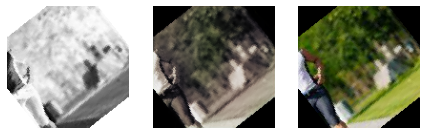

Epoch 761 	 Loss: min = 0.0034479908645153046; average = 0.004876827500993386; max = 0.00748408492654562
Epoch 762 	 Loss: min = 0.0034340841230005026; average = 0.0049164669326273724; max = 0.006882650312036276
Epoch 763 	 Loss: min = 0.003918380476534367; average = 0.004918538761558011; max = 0.006123505532741547
Epoch 764 	 Loss: min = 0.00377030111849308; average = 0.004886930255452171; max = 0.00642000325024128
Epoch 765 	 Loss: min = 0.003360385773703456; average = 0.004930562543449923; max = 0.006250221282243729


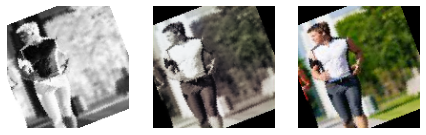

Epoch 766 	 Loss: min = 0.0033633585553616285; average = 0.004723538528196514; max = 0.005735465791076422
Epoch 767 	 Loss: min = 0.004126893822103739; average = 0.004957987694069743; max = 0.006132292561233044
Epoch 768 	 Loss: min = 0.003434848738834262; average = 0.0049546064547030255; max = 0.0061899335123598576
Epoch 769 	 Loss: min = 0.0036450803745537996; average = 0.004784806762472726; max = 0.006731358822435141
Epoch 770 	 Loss: min = 0.0035825937520712614; average = 0.0048266220692312345; max = 0.0063222795724868774


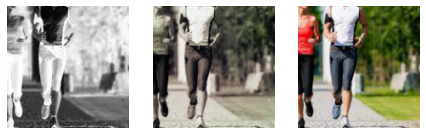

Epoch 771 	 Loss: min = 0.0036655068397521973; average = 0.004861463079578243; max = 0.007864126935601234
Epoch 772 	 Loss: min = 0.0036355170886963606; average = 0.004933184260153212; max = 0.006329053547233343
Epoch 773 	 Loss: min = 0.0034332326613366604; average = 0.004883685658569448; max = 0.006949248723685741
Epoch 774 	 Loss: min = 0.003155732061713934; average = 0.004705281317001209; max = 0.006510238628834486
Epoch 775 	 Loss: min = 0.0037060286849737167; average = 0.004668868059525266; max = 0.005645406898111105


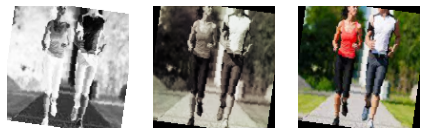

Epoch 776 	 Loss: min = 0.0037491093389689922; average = 0.004881472268607467; max = 0.006735167466104031
Epoch 777 	 Loss: min = 0.003887160448357463; average = 0.004842789945541881; max = 0.006300033535808325
Epoch 778 	 Loss: min = 0.003708313684910536; average = 0.004765777528518811; max = 0.0074914125725626945
Epoch 779 	 Loss: min = 0.0037543883081525564; average = 0.004897802878986113; max = 0.0065089864656329155
Epoch 780 	 Loss: min = 0.003344794735312462; average = 0.004833249549847096; max = 0.007310112472623587


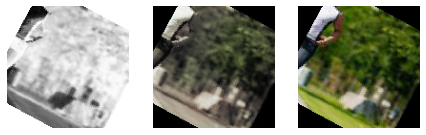

Epoch 781 	 Loss: min = 0.0034138623159378767; average = 0.004793272586539388; max = 0.007011139299720526
Epoch 782 	 Loss: min = 0.003686887212097645; average = 0.004936342098517343; max = 0.006731159053742886
Epoch 783 	 Loss: min = 0.0032396006863564253; average = 0.004781441588420421; max = 0.006822474300861359
Epoch 784 	 Loss: min = 0.003420810215175152; average = 0.004790530874743126; max = 0.007229918148368597
Epoch 785 	 Loss: min = 0.0034168511629104614; average = 0.004738388757687062; max = 0.0063336556777358055


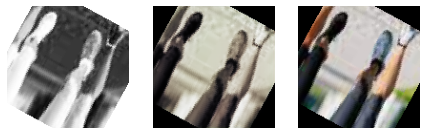

Epoch 786 	 Loss: min = 0.003543522674590349; average = 0.004879427549894899; max = 0.007600012235343456
Epoch 787 	 Loss: min = 0.0037481202743947506; average = 0.004784679869771935; max = 0.00867444183677435
Epoch 788 	 Loss: min = 0.00374537892639637; average = 0.004712344438303262; max = 0.00684667332097888
Epoch 789 	 Loss: min = 0.0038010282441973686; average = 0.004659446640289389; max = 0.00597624946385622
Epoch 790 	 Loss: min = 0.003703482449054718; average = 0.004779650014825165; max = 0.007055425550788641


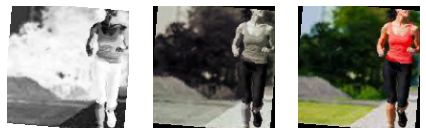

Epoch 791 	 Loss: min = 0.0035815476439893246; average = 0.004783951662830077; max = 0.006256109103560448
Epoch 792 	 Loss: min = 0.003813134040683508; average = 0.004684763902332634; max = 0.005775569938123226
Epoch 793 	 Loss: min = 0.0032158365938812494; average = 0.004771536128828302; max = 0.007031933404505253
Epoch 794 	 Loss: min = 0.0038940459489822388; average = 0.004613479861291125; max = 0.005590585060417652
Epoch 795 	 Loss: min = 0.003682680195197463; average = 0.004777537222253159; max = 0.007229264359921217


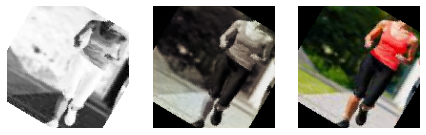

Epoch 796 	 Loss: min = 0.003698063548654318; average = 0.0047180866240523756; max = 0.006165848579257727
Epoch 797 	 Loss: min = 0.0035022287629544735; average = 0.004805592179764062; max = 0.00720750167965889
Epoch 798 	 Loss: min = 0.0038328568916767836; average = 0.004613394077750854; max = 0.006013095378875732
Epoch 799 	 Loss: min = 0.003684893948957324; average = 0.004664692489313893; max = 0.007861161604523659
Epoch 800 	 Loss: min = 0.003845520317554474; average = 0.004762493394082412; max = 0.006235572509467602


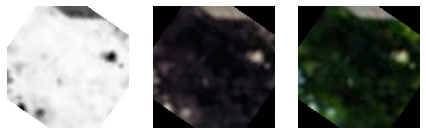

Epoch 801 	 Loss: min = 0.00344621273688972; average = 0.004578383974148892; max = 0.0056913141161203384
Epoch 802 	 Loss: min = 0.0038821338675916195; average = 0.004763606848428026; max = 0.006390466820448637
Epoch 803 	 Loss: min = 0.0033782217651605606; average = 0.004688301865826361; max = 0.006982471793889999
Epoch 804 	 Loss: min = 0.003499313723295927; average = 0.004797238827450201; max = 0.006312946788966656
Epoch 805 	 Loss: min = 0.003423149697482586; average = 0.004703840328147635; max = 0.0062621040269732475


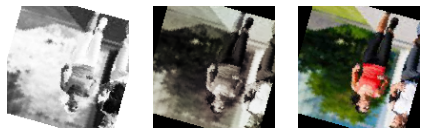

Epoch 806 	 Loss: min = 0.0038793522398918867; average = 0.004843430026085116; max = 0.005939925089478493
Epoch 807 	 Loss: min = 0.003675484796985984; average = 0.004661016530008055; max = 0.006085516419261694
Epoch 808 	 Loss: min = 0.0036667543463408947; average = 0.004592265613609925; max = 0.006361453793942928
Epoch 809 	 Loss: min = 0.0034015621058642864; average = 0.004673040355555713; max = 0.0062553780153393745
Epoch 810 	 Loss: min = 0.003304865909740329; average = 0.004681455480749719; max = 0.00646749883890152


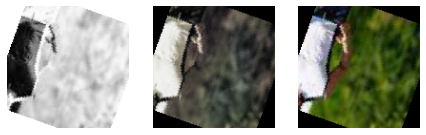

Epoch 811 	 Loss: min = 0.003385161515325308; average = 0.00470282333844807; max = 0.006516881287097931
Epoch 812 	 Loss: min = 0.003835430135950446; average = 0.00480747788969893; max = 0.0065819863229990005
Epoch 813 	 Loss: min = 0.0030098198913037777; average = 0.004459709525690414; max = 0.00610142108052969
Epoch 814 	 Loss: min = 0.0036559919826686382; average = 0.004767761274706572; max = 0.006288575939834118
Epoch 815 	 Loss: min = 0.003353836014866829; average = 0.004693579961895011; max = 0.0074868532828986645


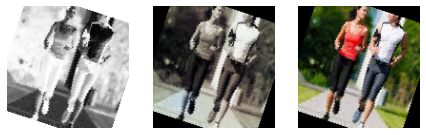

Epoch 816 	 Loss: min = 0.003470753785222769; average = 0.004589726609992795; max = 0.006695599295198917
Epoch 817 	 Loss: min = 0.0038723365869373083; average = 0.0049464537733001634; max = 0.006867679767310619
Epoch 818 	 Loss: min = 0.003585961414501071; average = 0.004687672117142938; max = 0.0059048174880445
Epoch 819 	 Loss: min = 0.004102165810763836; average = 0.004646682500606403; max = 0.00610972847789526
Epoch 820 	 Loss: min = 0.003602896584197879; average = 0.0046522511838702485; max = 0.005851571448147297


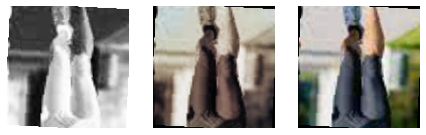

Epoch 821 	 Loss: min = 0.003622590098530054; average = 0.004618832317646593; max = 0.007097728084772825
Epoch 822 	 Loss: min = 0.0032465034164488316; average = 0.004764013196108863; max = 0.006569018121808767
Epoch 823 	 Loss: min = 0.003328999038785696; average = 0.004642386396881193; max = 0.0063827442936599255
Epoch 824 	 Loss: min = 0.0037398606073111296; average = 0.004706411244114861; max = 0.0062307617627084255
Epoch 825 	 Loss: min = 0.0034494674764573574; average = 0.00453628710238263; max = 0.006211946718394756


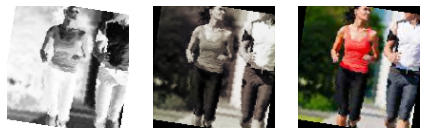

Epoch 826 	 Loss: min = 0.003400049638003111; average = 0.0047972924512578174; max = 0.006371463183313608
Epoch 827 	 Loss: min = 0.0033983378671109676; average = 0.004655208540498279; max = 0.007552025374025106
Epoch 828 	 Loss: min = 0.0029235631227493286; average = 0.004567811585729942; max = 0.0073472885414958
Epoch 829 	 Loss: min = 0.0034602321684360504; average = 0.004515181164606474; max = 0.00577756529673934
Epoch 830 	 Loss: min = 0.0034346419852226973; average = 0.004543823728454299; max = 0.005823700688779354


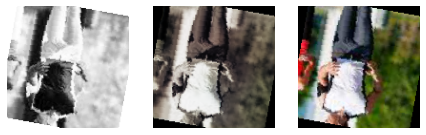

Epoch 831 	 Loss: min = 0.0036620665341615677; average = 0.004595097198034637; max = 0.006516225170344114
Epoch 832 	 Loss: min = 0.0035805734805762768; average = 0.004522966119111516; max = 0.007004700601100922
Epoch 833 	 Loss: min = 0.003564008977264166; average = 0.004685471911216155; max = 0.00632378039881587
Epoch 834 	 Loss: min = 0.003136532846838236; average = 0.004715708433650434; max = 0.005972092505544424
Epoch 835 	 Loss: min = 0.0028470992110669613; average = 0.00457338873820845; max = 0.005328459199517965


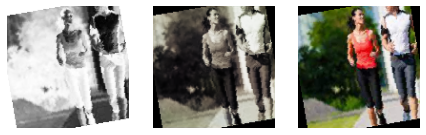

Epoch 836 	 Loss: min = 0.0035296319983899593; average = 0.0047392676351591945; max = 0.007196062710136175
Epoch 837 	 Loss: min = 0.003613583277910948; average = 0.004720531054772437; max = 0.007482025772333145
Epoch 838 	 Loss: min = 0.003614285960793495; average = 0.0045816152123734355; max = 0.006133083254098892
Epoch 839 	 Loss: min = 0.0030738641507923603; average = 0.004530292979325168; max = 0.00642991391941905
Epoch 840 	 Loss: min = 0.0034940175246447325; average = 0.004566912815789692; max = 0.00728302076458931


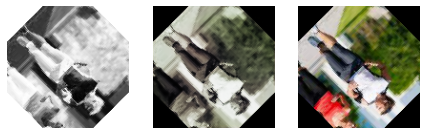

Epoch 841 	 Loss: min = 0.003650109050795436; average = 0.004680035606725141; max = 0.006566900294274092
Epoch 842 	 Loss: min = 0.003595657180994749; average = 0.004548494660411961; max = 0.0051667881198227406
Epoch 843 	 Loss: min = 0.0035097773652523756; average = 0.004633231423213147; max = 0.005927592050284147
Epoch 844 	 Loss: min = 0.0035939612425863743; average = 0.004551621037535369; max = 0.006040014326572418
Epoch 845 	 Loss: min = 0.003934671636670828; average = 0.00458882242674008; max = 0.005635564681142569


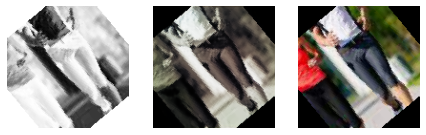

Epoch 846 	 Loss: min = 0.003713182872161269; average = 0.004682776736444794; max = 0.0062056658789515495
Epoch 847 	 Loss: min = 0.003262890502810478; average = 0.004427655410836451; max = 0.005975629203021526
Epoch 848 	 Loss: min = 0.003225047141313553; average = 0.004790800434420817; max = 0.006741927471011877
Epoch 849 	 Loss: min = 0.0036403208505362272; average = 0.0044073659082641825; max = 0.004979126155376434
Epoch 850 	 Loss: min = 0.003428754862397909; average = 0.004569787051877938; max = 0.005888746585696936


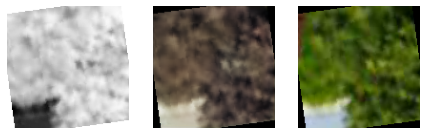

Epoch 851 	 Loss: min = 0.0033046132884919643; average = 0.004607329217833467; max = 0.0060293953865766525
Epoch 852 	 Loss: min = 0.003569412976503372; average = 0.004610755058820359; max = 0.006118312478065491
Epoch 853 	 Loss: min = 0.0031844093464314938; average = 0.004753990739118308; max = 0.006659537088125944
Epoch 854 	 Loss: min = 0.003683988004922867; average = 0.0047774909471627325; max = 0.005993375554680824
Epoch 855 	 Loss: min = 0.0032150414772331715; average = 0.004469144143513404; max = 0.005526742897927761


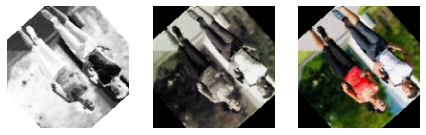

Epoch 856 	 Loss: min = 0.0034371616784483194; average = 0.004599561667419039; max = 0.006266000680625439
Epoch 857 	 Loss: min = 0.003358513815328479; average = 0.004716574258054607; max = 0.007224078290164471
Epoch 858 	 Loss: min = 0.0033001049887388945; average = 0.0046327492309501395; max = 0.005217810161411762
Epoch 859 	 Loss: min = 0.003121765097603202; average = 0.004529289115453139; max = 0.00622510863468051
Epoch 860 	 Loss: min = 0.0036543053574860096; average = 0.004600425250828266; max = 0.006872089114040136


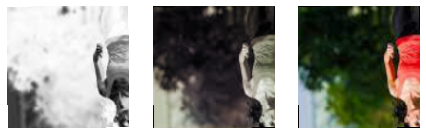

Epoch 861 	 Loss: min = 0.0031652699690312147; average = 0.004657388722989708; max = 0.006695943884551525
Epoch 862 	 Loss: min = 0.0033808033913373947; average = 0.004521112525253557; max = 0.0057444265112280846
Epoch 863 	 Loss: min = 0.00345255876891315; average = 0.004492948850383982; max = 0.006546704098582268
Epoch 864 	 Loss: min = 0.003044686745852232; average = 0.004479696930502541; max = 0.006348656490445137
Epoch 865 	 Loss: min = 0.003275531344115734; average = 0.004500713024754077; max = 0.005398809909820557


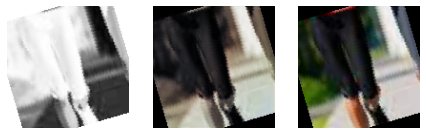

Epoch 866 	 Loss: min = 0.003225655062124133; average = 0.0045754430902889; max = 0.006292044185101986
Epoch 867 	 Loss: min = 0.003663844196125865; average = 0.0045737530454061925; max = 0.006411069538444281
Epoch 868 	 Loss: min = 0.0037111900746822357; average = 0.004530564532615244; max = 0.005684306845068932
Epoch 869 	 Loss: min = 0.002900380175560713; average = 0.004544267430901527; max = 0.006019446533173323
Epoch 870 	 Loss: min = 0.003317810595035553; average = 0.004563621201668866; max = 0.005895163398236036


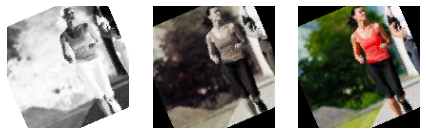

Epoch 871 	 Loss: min = 0.0029296916909515858; average = 0.004535041414783336; max = 0.0066051185131073
Epoch 872 	 Loss: min = 0.003943614661693573; average = 0.0047724234173074365; max = 0.0071016824804246426
Epoch 873 	 Loss: min = 0.0034171054139733315; average = 0.004610577976563945; max = 0.0065194773487746716
Epoch 874 	 Loss: min = 0.003418905660510063; average = 0.004542855473118834; max = 0.006119164638221264
Epoch 875 	 Loss: min = 0.003197654150426388; average = 0.00457548355916515; max = 0.005841534584760666


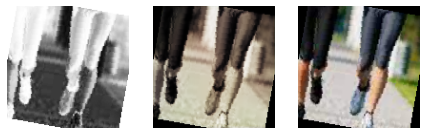

Epoch 876 	 Loss: min = 0.0032393818255513906; average = 0.004633102347725071; max = 0.006823659874498844
Epoch 877 	 Loss: min = 0.003364830743521452; average = 0.0044307220668997616; max = 0.0066609811037778854
Epoch 878 	 Loss: min = 0.0037236593198031187; average = 0.004492875799769536; max = 0.0062851374968886375
Epoch 879 	 Loss: min = 0.0031852354295551777; average = 0.004611829499481246; max = 0.007057023700326681
Epoch 880 	 Loss: min = 0.003719191998243332; average = 0.00451460869226139; max = 0.005643710494041443


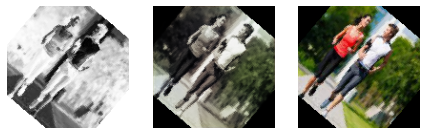

Epoch 881 	 Loss: min = 0.0036229174584150314; average = 0.004529563069809228; max = 0.006223028060048819
Epoch 882 	 Loss: min = 0.003554009599611163; average = 0.004541916496236809; max = 0.005951122846454382
Epoch 883 	 Loss: min = 0.003297423478215933; average = 0.004556968779070303; max = 0.005572255700826645
Epoch 884 	 Loss: min = 0.0033715355675667524; average = 0.004372322742710821; max = 0.005699717905372381
Epoch 885 	 Loss: min = 0.0035344604402780533; average = 0.004588293377310038; max = 0.006485489662736654


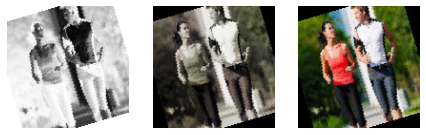

Epoch 886 	 Loss: min = 0.0034042559564113617; average = 0.004444449848961085; max = 0.005955727305263281
Epoch 887 	 Loss: min = 0.003493757452815771; average = 0.004628029593732208; max = 0.006304997019469738
Epoch 888 	 Loss: min = 0.003077059518545866; average = 0.0045348747371463105; max = 0.006067692767828703
Epoch 889 	 Loss: min = 0.0034201662056148052; average = 0.004383099498227239; max = 0.006117076613008976
Epoch 890 	 Loss: min = 0.0034780639689415693; average = 0.0045029531174805015; max = 0.006294208578765392


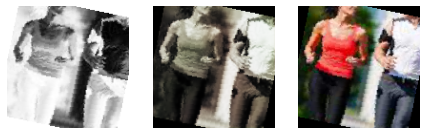

Epoch 891 	 Loss: min = 0.0032598930411040783; average = 0.004417878168169409; max = 0.005569562781602144
Epoch 892 	 Loss: min = 0.0037708254531025887; average = 0.004488476522965357; max = 0.005533634684979916
Epoch 893 	 Loss: min = 0.003548750188201666; average = 0.004460199023014866; max = 0.005744653753936291
Epoch 894 	 Loss: min = 0.003326036036014557; average = 0.004302925997762941; max = 0.006239916663616896
Epoch 895 	 Loss: min = 0.0035779327154159546; average = 0.004276899620890617; max = 0.005146607756614685


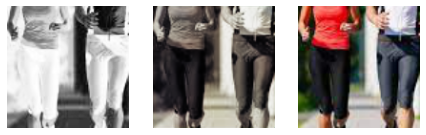

Epoch 896 	 Loss: min = 0.0036289000418037176; average = 0.004382803424960002; max = 0.0056598000228405
Epoch 897 	 Loss: min = 0.0032670102082192898; average = 0.004472427201108076; max = 0.007444694172590971
Epoch 898 	 Loss: min = 0.003538236953318119; average = 0.004369393267552368; max = 0.0055310348980128765
Epoch 899 	 Loss: min = 0.0034833517856895924; average = 0.004278146312572062; max = 0.00512640131637454
Epoch 900 	 Loss: min = 0.0036025159060955048; average = 0.004346326444647275; max = 0.005926623474806547


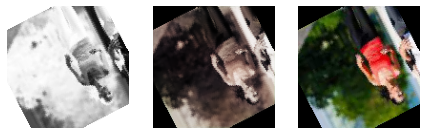

Epoch 901 	 Loss: min = 0.0036373946350067854; average = 0.004516602115472779; max = 0.006954616867005825
Epoch 902 	 Loss: min = 0.0033650563564151525; average = 0.004529398676822893; max = 0.005631906446069479
Epoch 903 	 Loss: min = 0.003473819000646472; average = 0.004503275573370047; max = 0.005676690489053726
Epoch 904 	 Loss: min = 0.0033042598515748978; average = 0.004300757005694322; max = 0.005537773482501507
Epoch 905 	 Loss: min = 0.0035299318842589855; average = 0.004466036436497234; max = 0.005937607027590275


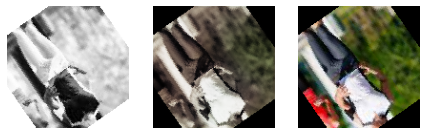

Epoch 906 	 Loss: min = 0.0034022866748273373; average = 0.004281211571651511; max = 0.0052675120532512665
Epoch 907 	 Loss: min = 0.0034022878389805555; average = 0.0043762678251368925; max = 0.005542564671486616
Epoch 908 	 Loss: min = 0.0032263926696032286; average = 0.00446980343258474; max = 0.006685513071715832
Epoch 909 	 Loss: min = 0.003368925303220749; average = 0.004346533300122246; max = 0.006657351739704609
Epoch 910 	 Loss: min = 0.0035204687155783176; average = 0.004605903086485341; max = 0.0060906000435352325


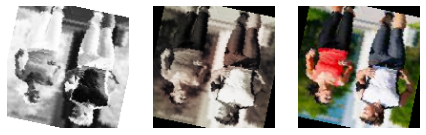

Epoch 911 	 Loss: min = 0.003622866701334715; average = 0.0047614604263799265; max = 0.007506589405238628
Epoch 912 	 Loss: min = 0.003289727494120598; average = 0.004414595096022822; max = 0.006202788557857275
Epoch 913 	 Loss: min = 0.0035153250209987164; average = 0.004387419612612575; max = 0.005777313839644194
Epoch 914 	 Loss: min = 0.003549833782017231; average = 0.0045364785473793745; max = 0.006077880039811134
Epoch 915 	 Loss: min = 0.0032569430768489838; average = 0.0044294119434198365; max = 0.006803023628890514


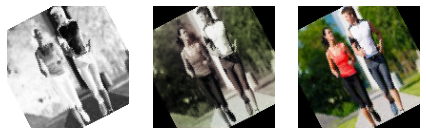

Epoch 916 	 Loss: min = 0.0031793599482625723; average = 0.004572497884510085; max = 0.006987564265727997
Epoch 917 	 Loss: min = 0.003440455300733447; average = 0.004499421309446916; max = 0.006633712910115719
Epoch 918 	 Loss: min = 0.003676376072689891; average = 0.004327915899921209; max = 0.004804960452020168
Epoch 919 	 Loss: min = 0.0035900012589991093; average = 0.004522892166278325; max = 0.006407569162547588
Epoch 920 	 Loss: min = 0.003355839056894183; average = 0.004441234996193089; max = 0.005773479118943214


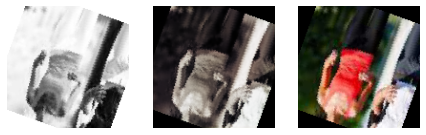

Epoch 921 	 Loss: min = 0.003689319361001253; average = 0.004440032542333938; max = 0.0055567859672009945
Epoch 922 	 Loss: min = 0.003197069512680173; average = 0.004361142549896613; max = 0.006743184290826321
Epoch 923 	 Loss: min = 0.003291665343567729; average = 0.004593261386617087; max = 0.006843342911452055
Epoch 924 	 Loss: min = 0.003236386924982071; average = 0.004365149303339422; max = 0.006030993070453405
Epoch 925 	 Loss: min = 0.0035320683382451534; average = 0.004253667910234071; max = 0.005175293888896704


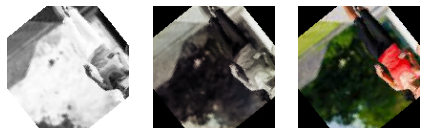

Epoch 926 	 Loss: min = 0.003042778931558132; average = 0.004605814712704159; max = 0.005842262879014015
Epoch 927 	 Loss: min = 0.003211626084521413; average = 0.004526240925770253; max = 0.006899700965732336
Epoch 928 	 Loss: min = 0.0034273513592779636; average = 0.004375832955702208; max = 0.005946319550275803
Epoch 929 	 Loss: min = 0.0031150411814451218; average = 0.004267688069376163; max = 0.005179846193641424
Epoch 930 	 Loss: min = 0.0036827358417212963; average = 0.004440016855369322; max = 0.006215580739080906


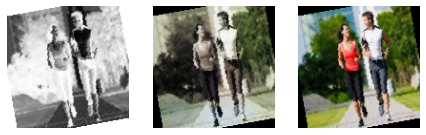

Epoch 931 	 Loss: min = 0.0035059533547610044; average = 0.004273536062100902; max = 0.005309147760272026
Epoch 932 	 Loss: min = 0.0032025265973061323; average = 0.004369167058030143; max = 0.0071554407477378845
Epoch 933 	 Loss: min = 0.003389745717868209; average = 0.004339330902439542; max = 0.005596782546490431
Epoch 934 	 Loss: min = 0.0033348998986184597; average = 0.004317499857279472; max = 0.005838537588715553
Epoch 935 	 Loss: min = 0.0031432504765689373; average = 0.0042091205541510135; max = 0.005579560529440641


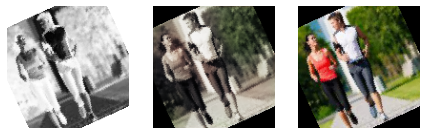

Epoch 936 	 Loss: min = 0.0030748220160603523; average = 0.004284162918338552; max = 0.006397709250450134
Epoch 937 	 Loss: min = 0.003589400788769126; average = 0.004472406901186332; max = 0.006811426021158695
Epoch 938 	 Loss: min = 0.0037671606987714767; average = 0.004350672068540007; max = 0.0059119826182723045
Epoch 939 	 Loss: min = 0.003337362315505743; average = 0.004329349525505677; max = 0.005897358059883118
Epoch 940 	 Loss: min = 0.0036677501630038023; average = 0.004348660877440125; max = 0.005647270008921623


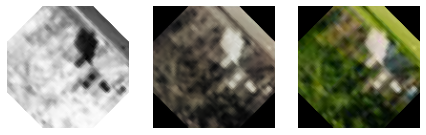

Epoch 941 	 Loss: min = 0.003396135289222002; average = 0.0043817801924888045; max = 0.005800282116979361
Epoch 942 	 Loss: min = 0.0032031205482780933; average = 0.004299163352698088; max = 0.005521333776414394
Epoch 943 	 Loss: min = 0.003257481148466468; average = 0.004214592947391793; max = 0.005572048481553793
Epoch 944 	 Loss: min = 0.0032791707199066877; average = 0.004186888996628113; max = 0.005532274954020977
Epoch 945 	 Loss: min = 0.0034955653827637434; average = 0.004247429867973551; max = 0.00655716797336936


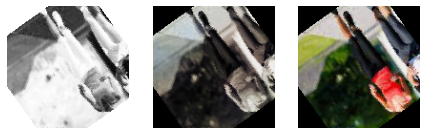

Epoch 946 	 Loss: min = 0.0033007084857672453; average = 0.004329101138864644; max = 0.0073435669764876366
Epoch 947 	 Loss: min = 0.0033231929410248995; average = 0.004260370347765274; max = 0.005055335350334644
Epoch 948 	 Loss: min = 0.0035112786572426558; average = 0.004124113940633833; max = 0.005749892443418503
Epoch 949 	 Loss: min = 0.0034141000360250473; average = 0.004386929052998312; max = 0.005512888543307781
Epoch 950 	 Loss: min = 0.0033701318316161633; average = 0.004313204510253854; max = 0.005459445528686047


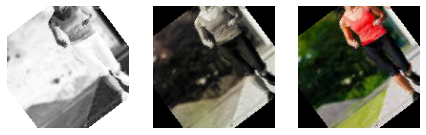

Epoch 951 	 Loss: min = 0.0034864204935729504; average = 0.0042506034224061295; max = 0.004890141077339649
Epoch 952 	 Loss: min = 0.0033752149902284145; average = 0.0042573749960865825; max = 0.005305256694555283
Epoch 953 	 Loss: min = 0.003227316541597247; average = 0.004338582613854669; max = 0.006021793931722641
Epoch 954 	 Loss: min = 0.0035828612744808197; average = 0.004299255582736805; max = 0.005138109903782606
Epoch 955 	 Loss: min = 0.003125141141936183; average = 0.004346523186541162; max = 0.005600180476903915


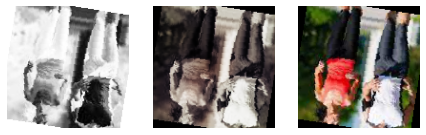

Epoch 956 	 Loss: min = 0.0034326575696468353; average = 0.00431631799438037; max = 0.005598658230155706
Epoch 957 	 Loss: min = 0.0035272929817438126; average = 0.0042331774602644145; max = 0.005300517193973064
Epoch 958 	 Loss: min = 0.0033530499786138535; average = 0.00424750882666558; max = 0.005140967667102814
Epoch 959 	 Loss: min = 0.003680724650621414; average = 0.0044325837516225874; max = 0.005120905581861734
Epoch 960 	 Loss: min = 0.003322075819596648; average = 0.004291304343496449; max = 0.005253709387034178


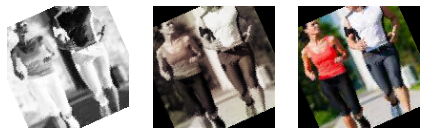

Epoch 961 	 Loss: min = 0.003218904137611389; average = 0.004186540478258394; max = 0.0053651658818125725
Epoch 962 	 Loss: min = 0.003364548785611987; average = 0.004352063435362652; max = 0.005547867156565189
Epoch 963 	 Loss: min = 0.003317713737487793; average = 0.004500014576478861; max = 0.006523839198052883
Epoch 964 	 Loss: min = 0.00318351062014699; average = 0.004268570482963696; max = 0.005548636429011822
Epoch 965 	 Loss: min = 0.0033620751928538084; average = 0.004197247908450663; max = 0.005057409405708313


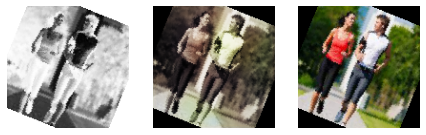

Epoch 966 	 Loss: min = 0.0034604626707732677; average = 0.004255474806996062; max = 0.005589514970779419
Epoch 967 	 Loss: min = 0.0034249830059707165; average = 0.00411843869369477; max = 0.005210744217038155
Epoch 968 	 Loss: min = 0.003251252230256796; average = 0.004079943188116886; max = 0.005532846786081791
Epoch 969 	 Loss: min = 0.0033263592049479485; average = 0.00417088002723176; max = 0.004957969766110182
Epoch 970 	 Loss: min = 0.0031332597136497498; average = 0.004138817384955473; max = 0.005860193632543087


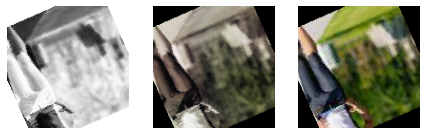

Epoch 971 	 Loss: min = 0.0034302277490496635; average = 0.004316030608606525; max = 0.00567471981048584
Epoch 972 	 Loss: min = 0.003187691792845726; average = 0.004327137605287135; max = 0.007886511273682117
Epoch 973 	 Loss: min = 0.00301836128346622; average = 0.004274359307601117; max = 0.005264693405479193
Epoch 974 	 Loss: min = 0.003368073608726263; average = 0.004083175794221461; max = 0.005047610029578209
Epoch 975 	 Loss: min = 0.0034751147031784058; average = 0.0042339445353718475; max = 0.004787583835422993


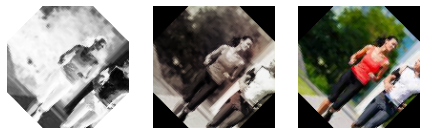

Epoch 976 	 Loss: min = 0.0032635387033224106; average = 0.004204574695904739; max = 0.006267298012971878
Epoch 977 	 Loss: min = 0.0036000474356114864; average = 0.00419569383666385; max = 0.005373125430196524
Epoch 978 	 Loss: min = 0.0034286517184227705; average = 0.004248214201652445; max = 0.005545216612517834
Epoch 979 	 Loss: min = 0.003523088525980711; average = 0.004257041466189548; max = 0.005585969891399145
Epoch 980 	 Loss: min = 0.003064405871555209; average = 0.004309673327952623; max = 0.005836000200361013


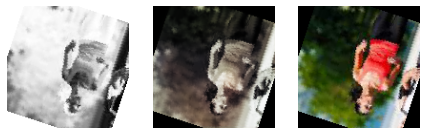

Epoch 981 	 Loss: min = 0.0032764002680778503; average = 0.004007550436654128; max = 0.0050185807049274445
Epoch 982 	 Loss: min = 0.003254024311900139; average = 0.004043753448058851; max = 0.0049517336301505566
Epoch 983 	 Loss: min = 0.003552057547494769; average = 0.004180799558525905; max = 0.005843707825988531
Epoch 984 	 Loss: min = 0.003291188506409526; average = 0.00409476768982131; max = 0.004915005527436733
Epoch 985 	 Loss: min = 0.0034133701119571924; average = 0.00428473693318665; max = 0.006214892491698265


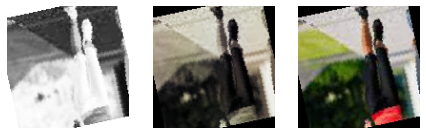

Epoch 986 	 Loss: min = 0.0031850370578467846; average = 0.0043461025634314865; max = 0.005378630943596363
Epoch 987 	 Loss: min = 0.0033692612778395414; average = 0.004239829024299979; max = 0.006290118675678968
Epoch 988 	 Loss: min = 0.0033050812780857086; average = 0.004220192771754228; max = 0.005350753664970398
Epoch 989 	 Loss: min = 0.0032602716237306595; average = 0.004350578208686784; max = 0.005435831379145384
Epoch 990 	 Loss: min = 0.003163533052429557; average = 0.0043814436794491485; max = 0.006564546376466751


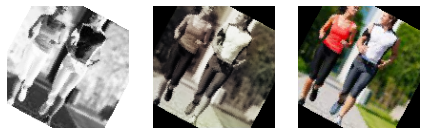

Epoch 991 	 Loss: min = 0.0030577066354453564; average = 0.004058437640196644; max = 0.00489480746909976
Epoch 992 	 Loss: min = 0.003077872097492218; average = 0.004255581297911704; max = 0.005943480879068375
Epoch 993 	 Loss: min = 0.0030460578855127096; average = 0.004238680689013563; max = 0.006205633748322725
Epoch 994 	 Loss: min = 0.0032562557607889175; average = 0.004125348059460521; max = 0.005091096740216017
Epoch 995 	 Loss: min = 0.0033456175588071346; average = 0.004130040004383773; max = 0.005860750563442707


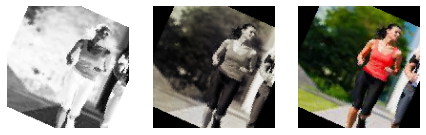

Epoch 996 	 Loss: min = 0.003265906823799014; average = 0.004318078266805969; max = 0.005698190536350012
Epoch 997 	 Loss: min = 0.0033294400200247765; average = 0.004151544504566118; max = 0.004754341673105955
Epoch 998 	 Loss: min = 0.0031399279832839966; average = 0.0041209158807760105; max = 0.005059241317212582
Epoch 999 	 Loss: min = 0.003375991713255644; average = 0.0042372249299660325; max = 0.005733827129006386
Epoch 1000 	 Loss: min = 0.0031215446069836617; average = 0.004067994756042026; max = 0.005291268229484558


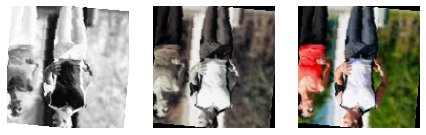

Epoch 1001 	 Loss: min = 0.002735087415203452; average = 0.003915940033039078; max = 0.004745000973343849
Epoch 1002 	 Loss: min = 0.0034512884449213743; average = 0.004167027189396322; max = 0.004784644581377506
Epoch 1003 	 Loss: min = 0.0035145010333508253; average = 0.0040423744794679806; max = 0.00460526067763567
Epoch 1004 	 Loss: min = 0.003301341785117984; average = 0.004284809154341929; max = 0.0066772447898983955
Epoch 1005 	 Loss: min = 0.0034105374943464994; average = 0.0040648352151038125; max = 0.0054395683109760284


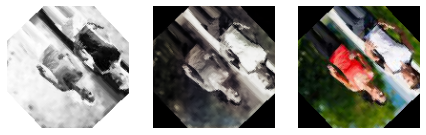

Epoch 1006 	 Loss: min = 0.003210169728845358; average = 0.004094230316695757; max = 0.006095478311181068
Epoch 1007 	 Loss: min = 0.0035894133616238832; average = 0.004251157282851636; max = 0.0052463216707110405
Epoch 1008 	 Loss: min = 0.0034988485276699066; average = 0.004262449918314815; max = 0.005360167473554611
Epoch 1009 	 Loss: min = 0.0028266075532883406; average = 0.004071087736519985; max = 0.005204980727285147
Epoch 1010 	 Loss: min = 0.003319906070828438; average = 0.004011291530332528; max = 0.005205524154007435


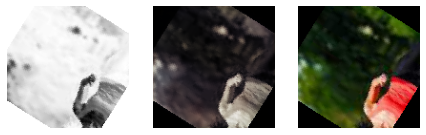

Epoch 1011 	 Loss: min = 0.0035090285819023848; average = 0.004077494173543528; max = 0.0048430548049509525
Epoch 1012 	 Loss: min = 0.0031214277260005474; average = 0.004145785307628103; max = 0.005538440775126219
Epoch 1013 	 Loss: min = 0.002777165500447154; average = 0.003998623229563236; max = 0.004613630007952452
Epoch 1014 	 Loss: min = 0.0033476995304226875; average = 0.0041252415685448796; max = 0.00555364228785038
Epoch 1015 	 Loss: min = 0.0032937414944171906; average = 0.003960757996537723; max = 0.00572378933429718


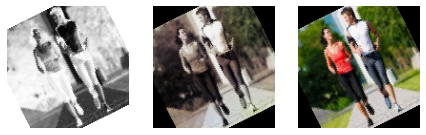

Epoch 1016 	 Loss: min = 0.0028163734823465347; average = 0.004329309027525596; max = 0.005789383314549923
Epoch 1017 	 Loss: min = 0.002991920802742243; average = 0.004187846105196513; max = 0.0054651228711009026
Epoch 1018 	 Loss: min = 0.0031886808574199677; average = 0.004043040826218203; max = 0.005526963621377945
Epoch 1019 	 Loss: min = 0.003432429861277342; average = 0.004057406753418036; max = 0.005830036476254463
Epoch 1020 	 Loss: min = 0.0031761834397912025; average = 0.004060853359987959; max = 0.004747580736875534


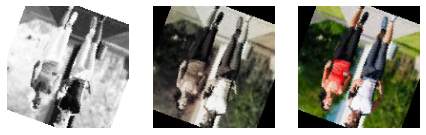

Epoch 1021 	 Loss: min = 0.003463833360001445; average = 0.004032904747873545; max = 0.00548930000513792
Epoch 1022 	 Loss: min = 0.003268792061135173; average = 0.0040100600745063275; max = 0.004958709701895714
Epoch 1023 	 Loss: min = 0.0033077881671488285; average = 0.004054948789416812; max = 0.005011920817196369
Epoch 1024 	 Loss: min = 0.003029193729162216; average = 0.004021630913484842; max = 0.004849377553910017
Epoch 1025 	 Loss: min = 0.003261480014771223; average = 0.0040520320035284385; max = 0.0052665285766124725


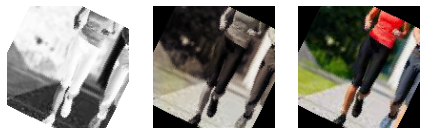

Epoch 1026 	 Loss: min = 0.0030290852300822735; average = 0.0040702458209125325; max = 0.00524982949718833
Epoch 1027 	 Loss: min = 0.0028708558529615402; average = 0.004123510283534415; max = 0.006667410954833031
Epoch 1028 	 Loss: min = 0.0033822364639490843; average = 0.004198782815365121; max = 0.005809847265481949
Epoch 1029 	 Loss: min = 0.0028280275873839855; average = 0.00419752077141311; max = 0.005718944128602743
Epoch 1030 	 Loss: min = 0.003183686640113592; average = 0.003944185344153084; max = 0.0057810223661363125


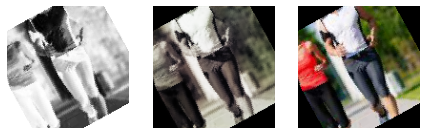

Epoch 1031 	 Loss: min = 0.0030972007662057877; average = 0.0040321574051631615; max = 0.005011076107621193
Epoch 1032 	 Loss: min = 0.0032952353358268738; average = 0.004183953089523129; max = 0.005443213507533073
Epoch 1033 	 Loss: min = 0.0031082495115697384; average = 0.004088403657078743; max = 0.005223413463681936
Epoch 1034 	 Loss: min = 0.0033050701022148132; average = 0.004047383743454702; max = 0.005399825517088175
Epoch 1035 	 Loss: min = 0.003233907278627157; average = 0.00407187215751037; max = 0.0049408916383981705


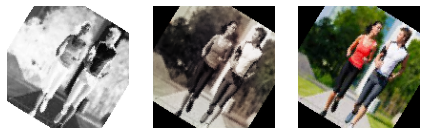

Epoch 1036 	 Loss: min = 0.003231234848499298; average = 0.00404853698273655; max = 0.00569254532456398
Epoch 1037 	 Loss: min = 0.0034776448737829924; average = 0.004056345147546381; max = 0.004782277159392834
Epoch 1038 	 Loss: min = 0.00308978371322155; average = 0.004046537462272681; max = 0.0049795107915997505
Epoch 1039 	 Loss: min = 0.0031704946886748075; average = 0.004026639013318345; max = 0.004927752073854208
Epoch 1040 	 Loss: min = 0.003354059299454093; average = 0.004012037257780321; max = 0.005291934125125408


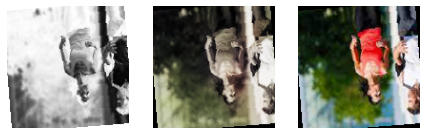

Epoch 1041 	 Loss: min = 0.003042364027351141; average = 0.004037033751956187; max = 0.004934429656714201
Epoch 1042 	 Loss: min = 0.003150573931634426; average = 0.0039673650317126885; max = 0.005091178696602583
Epoch 1043 	 Loss: min = 0.0032963778357952833; average = 0.0040898598235799; max = 0.006605548318475485
Epoch 1044 	 Loss: min = 0.0033755518961697817; average = 0.004042017084429972; max = 0.005239315330982208
Epoch 1045 	 Loss: min = 0.0031252922490239143; average = 0.004027833216241561; max = 0.005459462758153677


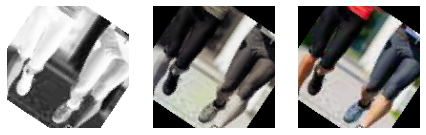

Epoch 1046 	 Loss: min = 0.0031523422803729773; average = 0.004015213795355521; max = 0.005100348498672247
Epoch 1047 	 Loss: min = 0.003158129518851638; average = 0.003931541214114986; max = 0.00515113677829504
Epoch 1048 	 Loss: min = 0.0030944347381591797; average = 0.0038822757196612656; max = 0.0046228752471506596
Epoch 1049 	 Loss: min = 0.003170499112457037; average = 0.003956372020184062; max = 0.005650901701301336
Epoch 1050 	 Loss: min = 0.002998800715431571; average = 0.004273072903743014; max = 0.005461846478283405


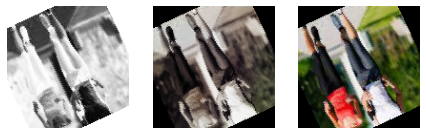

Epoch 1051 	 Loss: min = 0.0031868950463831425; average = 0.0038941613893257454; max = 0.00437203561887145
Epoch 1052 	 Loss: min = 0.0030764283146709204; average = 0.0038032682350603864; max = 0.004762895405292511
Epoch 1053 	 Loss: min = 0.003046206198632717; average = 0.004247016433509998; max = 0.0059003932401537895
Epoch 1054 	 Loss: min = 0.00289294496178627; average = 0.003898430280969478; max = 0.004421906545758247
Epoch 1055 	 Loss: min = 0.003081308677792549; average = 0.0041804332577157766; max = 0.005584127269685268


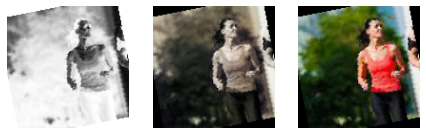

Epoch 1056 	 Loss: min = 0.0029644444584846497; average = 0.003978311448008753; max = 0.004749741405248642
Epoch 1057 	 Loss: min = 0.003370788646861911; average = 0.003874218848068267; max = 0.004964696243405342
Epoch 1058 	 Loss: min = 0.003147635143250227; average = 0.003962293529184535; max = 0.0050141047686338425
Epoch 1059 	 Loss: min = 0.0031048296950757504; average = 0.0039761894586263224; max = 0.005928877741098404
Epoch 1060 	 Loss: min = 0.0031544682569801807; average = 0.003944918003981002; max = 0.005340767093002796


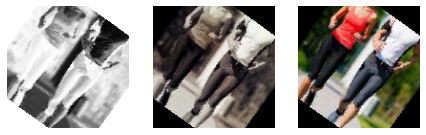

Epoch 1061 	 Loss: min = 0.0026832292787730694; average = 0.003994231126853265; max = 0.005453982390463352
Epoch 1062 	 Loss: min = 0.003433339297771454; average = 0.004235037369653583; max = 0.005774509161710739
Epoch 1063 	 Loss: min = 0.0032701115123927593; average = 0.003935279295546934; max = 0.005114316008985043
Epoch 1064 	 Loss: min = 0.003243647515773773; average = 0.003990401470218785; max = 0.004742409568279982
Epoch 1065 	 Loss: min = 0.0031089417170733213; average = 0.00402011931873858; max = 0.005186502821743488


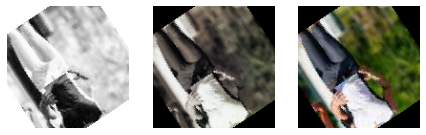

Epoch 1066 	 Loss: min = 0.00300373206846416; average = 0.004066261099069379; max = 0.005716077983379364
Epoch 1067 	 Loss: min = 0.0031859311275184155; average = 0.0038788139063399285; max = 0.004861125722527504
Epoch 1068 	 Loss: min = 0.0030202767811715603; average = 0.003954845538828522; max = 0.00465872697532177
Epoch 1069 	 Loss: min = 0.0032387999817728996; average = 0.003988858312368393; max = 0.00547639187425375
Epoch 1070 	 Loss: min = 0.0028102255892008543; average = 0.00391436017525848; max = 0.004766617901623249


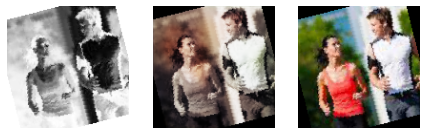

Epoch 1071 	 Loss: min = 0.003169698640704155; average = 0.003968791032093577; max = 0.005059113260358572
Epoch 1072 	 Loss: min = 0.003009313717484474; average = 0.003937420624424703; max = 0.0048065511509776115
Epoch 1073 	 Loss: min = 0.003090791404247284; average = 0.004039254956296645; max = 0.005371063947677612
Epoch 1074 	 Loss: min = 0.0029475565534085035; average = 0.0038461698568426073; max = 0.00504367146641016
Epoch 1075 	 Loss: min = 0.002742632059380412; average = 0.003908228827640414; max = 0.004944519605487585


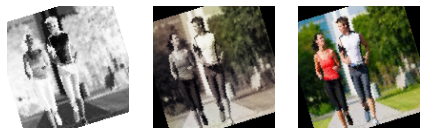

Epoch 1076 	 Loss: min = 0.0030871741473674774; average = 0.00389775526127778; max = 0.004796044435352087
Epoch 1077 	 Loss: min = 0.003244273364543915; average = 0.003922950709238648; max = 0.004999002441763878
Epoch 1078 	 Loss: min = 0.0036822061520069838; average = 0.004228003730531782; max = 0.0051702167838811874
Epoch 1079 	 Loss: min = 0.003190395189449191; average = 0.00398947145731654; max = 0.0046617076732218266
Epoch 1080 	 Loss: min = 0.002756461501121521; average = 0.004109172718017362; max = 0.005306515842676163


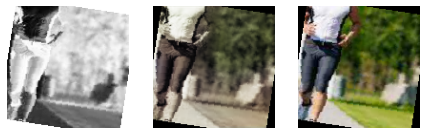

Epoch 1081 	 Loss: min = 0.0031353530939668417; average = 0.0038793444691691548; max = 0.005010704975575209
Epoch 1082 	 Loss: min = 0.0035563046112656593; average = 0.004092933246283792; max = 0.005048415623605251
Epoch 1083 	 Loss: min = 0.0030060461722314358; average = 0.0038471523439511657; max = 0.005018765572458506
Epoch 1084 	 Loss: min = 0.003063252894207835; average = 0.0039605039928574115; max = 0.005176974460482597
Epoch 1085 	 Loss: min = 0.0030630899127572775; average = 0.0038904248795006424; max = 0.0054095773957669735


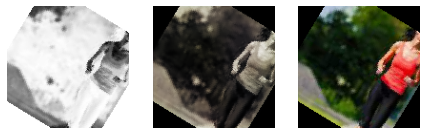

Epoch 1086 	 Loss: min = 0.0031488339882344007; average = 0.003936874360078946; max = 0.00559847429394722
Epoch 1087 	 Loss: min = 0.0031740169506520033; average = 0.004079211052157916; max = 0.005498883780092001
Epoch 1088 	 Loss: min = 0.003008257132023573; average = 0.003866451428621076; max = 0.004827365279197693
Epoch 1089 	 Loss: min = 0.0029149765614420176; average = 0.003819819394266233; max = 0.00502092856913805
Epoch 1090 	 Loss: min = 0.003325898200273514; average = 0.003827478372841142; max = 0.004593834280967712


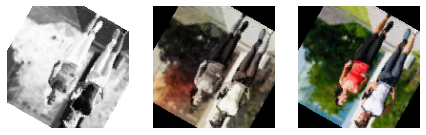

Epoch 1091 	 Loss: min = 0.0030941495206207037; average = 0.0038287771894829348; max = 0.004603203386068344
Epoch 1092 	 Loss: min = 0.0028424090705811977; average = 0.003914204266038723; max = 0.005414375104010105
Epoch 1093 	 Loss: min = 0.0033469400368630886; average = 0.0038356004370143637; max = 0.005292030051350594
Epoch 1094 	 Loss: min = 0.003022795310243964; average = 0.0038754421984776855; max = 0.005580774508416653
Epoch 1095 	 Loss: min = 0.003182071726769209; average = 0.003797721932642162; max = 0.0044563631527125835


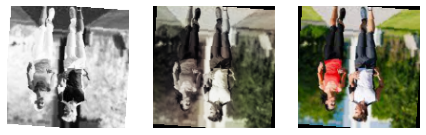

Epoch 1096 	 Loss: min = 0.0032727725338190794; average = 0.0038934649637667462; max = 0.005055595189332962
Epoch 1097 	 Loss: min = 0.0030626680236309767; average = 0.003751662588911131; max = 0.004848049022257328
Epoch 1098 	 Loss: min = 0.003020595759153366; average = 0.004007958399597555; max = 0.006502450443804264
Epoch 1099 	 Loss: min = 0.0031228787265717983; average = 0.0040177891933126375; max = 0.0052713616751134396
Epoch 1100 	 Loss: min = 0.0031369305215775967; average = 0.003859044096316211; max = 0.004930601455271244


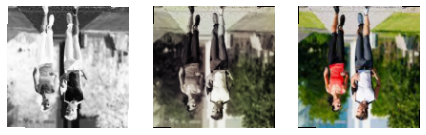

Epoch 1101 	 Loss: min = 0.0030987849459052086; average = 0.0038251186488196254; max = 0.005129142664372921
Epoch 1102 	 Loss: min = 0.0030327439308166504; average = 0.003977633925387636; max = 0.005570968147367239
Epoch 1103 	 Loss: min = 0.002903339918702841; average = 0.003970670979470015; max = 0.005453938152641058
Epoch 1104 	 Loss: min = 0.0033135246485471725; average = 0.004095161537406966; max = 0.0053215911611914635
Epoch 1105 	 Loss: min = 0.0029107662849128246; average = 0.0038809606339782476; max = 0.004871130920946598


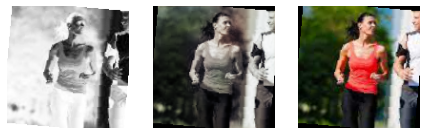

Epoch 1106 	 Loss: min = 0.003014372196048498; average = 0.0037668780860258266; max = 0.004855725914239883
Epoch 1107 	 Loss: min = 0.0029239472933113575; average = 0.0038119029632071033; max = 0.004900353495031595
Epoch 1108 	 Loss: min = 0.0030334852635860443; average = 0.003691682912176475; max = 0.004590543918311596
Epoch 1109 	 Loss: min = 0.003253165166825056; average = 0.0038904600660316646; max = 0.004664957523345947
Epoch 1110 	 Loss: min = 0.003091957187280059; average = 0.003978493710746989; max = 0.005827661138027906


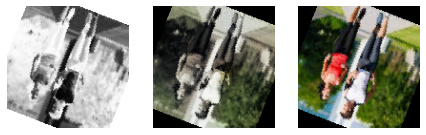

Epoch 1111 	 Loss: min = 0.003234569914638996; average = 0.003933435582439415; max = 0.0049136304296553135
Epoch 1112 	 Loss: min = 0.002727574435994029; average = 0.0039153350226115435; max = 0.005413586273789406
Epoch 1113 	 Loss: min = 0.0030928566120564938; average = 0.003886949401930906; max = 0.004644447471946478
Epoch 1114 	 Loss: min = 0.0028071440756320953; average = 0.004073395495652221; max = 0.006165558006614447
Epoch 1115 	 Loss: min = 0.0030000254046171904; average = 0.0037833432579645887; max = 0.004662577528506517


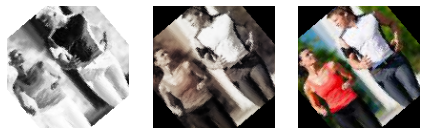

Epoch 1116 	 Loss: min = 0.0030095954425632954; average = 0.0036332270683487877; max = 0.004615923389792442
Epoch 1117 	 Loss: min = 0.0031734779477119446; average = 0.0039243962382897735; max = 0.0053844209760427475
Epoch 1118 	 Loss: min = 0.0029255168046802282; average = 0.003895742309396155; max = 0.0057273684069514275
Epoch 1119 	 Loss: min = 0.0031550254207104445; average = 0.0038982019905233756; max = 0.005475526675581932
Epoch 1120 	 Loss: min = 0.002701484365388751; average = 0.0038431153807323426; max = 0.00483432924374938


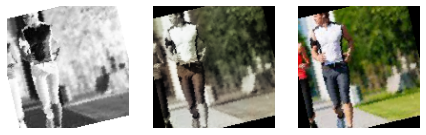

Epoch 1121 	 Loss: min = 0.0031038234010338783; average = 0.0037475861608982086; max = 0.004903282504528761
Epoch 1122 	 Loss: min = 0.003139834851026535; average = 0.0038093541224952787; max = 0.005055357236415148
Epoch 1123 	 Loss: min = 0.0028471052646636963; average = 0.003639357106294483; max = 0.004991939291357994
Epoch 1124 	 Loss: min = 0.0031038352753967047; average = 0.003918709073332138; max = 0.005515042692422867
Epoch 1125 	 Loss: min = 0.003044209908694029; average = 0.0037185018736636266; max = 0.00438518775627017


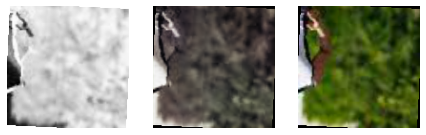

Epoch 1126 	 Loss: min = 0.003203661646693945; average = 0.003723146131960675; max = 0.004744431935250759
Epoch 1127 	 Loss: min = 0.0027118425350636244; average = 0.003826349537121132; max = 0.004713799338787794
Epoch 1128 	 Loss: min = 0.002984786406159401; average = 0.0037534355506068096; max = 0.00586800929158926
Epoch 1129 	 Loss: min = 0.0030524267349392176; average = 0.0037737410893896595; max = 0.004483713768422604
Epoch 1130 	 Loss: min = 0.0029379017651081085; average = 0.0036425100115593523; max = 0.004740333184599876


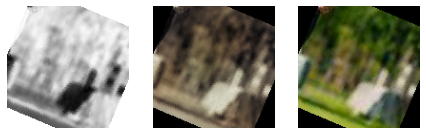

Epoch 1131 	 Loss: min = 0.003151464741677046; average = 0.003627257130574435; max = 0.004162827506661415
Epoch 1132 	 Loss: min = 0.0029943406116217375; average = 0.003799430836807005; max = 0.004738897085189819
Epoch 1133 	 Loss: min = 0.003113407175987959; average = 0.0038056513585615903; max = 0.0047013903968036175
Epoch 1134 	 Loss: min = 0.0027293087914586067; average = 0.0037095138686709106; max = 0.004622097592800856
Epoch 1135 	 Loss: min = 0.003182826330885291; average = 0.003884255711454898; max = 0.005373529624193907


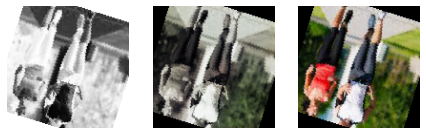

Epoch 1136 	 Loss: min = 0.0029739728197455406; average = 0.0036763387615792453; max = 0.004281304776668549
Epoch 1137 	 Loss: min = 0.00318924430757761; average = 0.00374718417879194; max = 0.004251421894878149
Epoch 1138 	 Loss: min = 0.002904775319620967; average = 0.003644905431428924; max = 0.004731372464448214
Epoch 1139 	 Loss: min = 0.002980635268613696; average = 0.0036395232018548995; max = 0.0042946538887917995
Epoch 1140 	 Loss: min = 0.0027553343679755926; average = 0.0038525942363776267; max = 0.005635104142129421


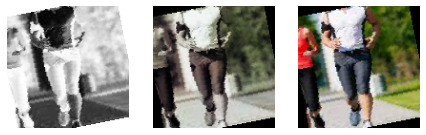

Epoch 1141 	 Loss: min = 0.0028356611728668213; average = 0.003699620545376092; max = 0.004976771771907806
Epoch 1142 	 Loss: min = 0.0028141257353127003; average = 0.0038835312152514234; max = 0.005255293101072311
Epoch 1143 	 Loss: min = 0.0029216096736490726; average = 0.0036816038482356817; max = 0.004577500279992819
Epoch 1144 	 Loss: min = 0.0029745798092335463; average = 0.003803039187914692; max = 0.005479866173118353
Epoch 1145 	 Loss: min = 0.0026277995202690363; average = 0.003691693433211185; max = 0.004067927598953247


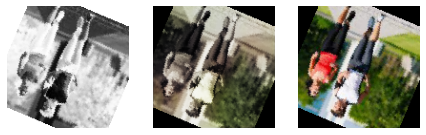

Epoch 1146 	 Loss: min = 0.0032517206855118275; average = 0.0038052807794883847; max = 0.0054807839915156364
Epoch 1147 	 Loss: min = 0.0031404118053615093; average = 0.003712028614245355; max = 0.004769548773765564
Epoch 1148 	 Loss: min = 0.0032308287918567657; average = 0.0038316190330078825; max = 0.005020732060074806
Epoch 1149 	 Loss: min = 0.002974304836243391; average = 0.003712025994900614; max = 0.005503893829882145
Epoch 1150 	 Loss: min = 0.003046975238248706; average = 0.0036889988114126027; max = 0.0046919891610741615


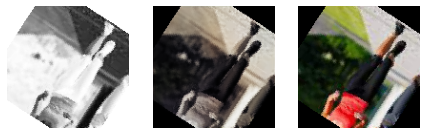

Epoch 1151 	 Loss: min = 0.003062351606786251; average = 0.003599961899453774; max = 0.004064933396875858
Epoch 1152 	 Loss: min = 0.0030329194851219654; average = 0.0036672233254648745; max = 0.004602957982569933
Epoch 1153 	 Loss: min = 0.0030009644106030464; average = 0.00362372089875862; max = 0.004523900803178549
Epoch 1154 	 Loss: min = 0.0029433313757181168; average = 0.003722121036844328; max = 0.005244307219982147
Epoch 1155 	 Loss: min = 0.002962312661111355; average = 0.0036431925545912236; max = 0.004326279740780592


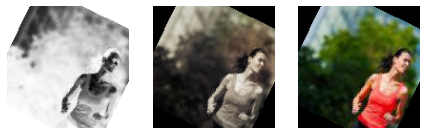

Epoch 1156 	 Loss: min = 0.0031252200715243816; average = 0.0037662850227206945; max = 0.0050325896590948105
Epoch 1157 	 Loss: min = 0.0029847929254174232; average = 0.003852310066577047; max = 0.006541721522808075
Epoch 1158 	 Loss: min = 0.002908766269683838; average = 0.003889697778504342; max = 0.005127346608787775
Epoch 1159 	 Loss: min = 0.0032239719294011593; average = 0.003815815973212011; max = 0.005493964999914169
Epoch 1160 	 Loss: min = 0.0032960723619908094; average = 0.003776040321099572; max = 0.004515914246439934


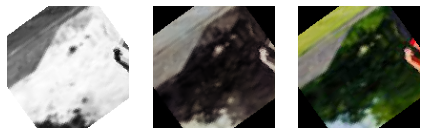

Epoch 1161 	 Loss: min = 0.003084608819335699; average = 0.003821382168098353; max = 0.005303196609020233
Epoch 1162 	 Loss: min = 0.0029990822076797485; average = 0.0037243786064209417; max = 0.0047789341770112514
Epoch 1163 	 Loss: min = 0.0031511951237916946; average = 0.0037137581675779074; max = 0.004603578243404627
Epoch 1164 	 Loss: min = 0.0028431813698261976; average = 0.0037060937174828723; max = 0.00515274191275239
Epoch 1165 	 Loss: min = 0.0027820789255201817; average = 0.003723313202499412; max = 0.004755767062306404


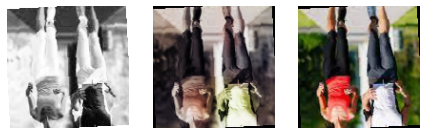

Epoch 1166 	 Loss: min = 0.0031827378552407026; average = 0.003787460271269083; max = 0.004588116891682148
Epoch 1167 	 Loss: min = 0.0024807013105601072; average = 0.0038346516812453046; max = 0.004991872236132622
Epoch 1168 	 Loss: min = 0.002978729084134102; average = 0.0037645165575668216; max = 0.004577428102493286
Epoch 1169 	 Loss: min = 0.0030648044776171446; average = 0.0038016139005776495; max = 0.005146653391420841
Epoch 1170 	 Loss: min = 0.002904266817495227; average = 0.0036207295925123617; max = 0.005335280206054449


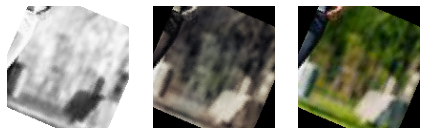

Epoch 1171 	 Loss: min = 0.0030186434742063284; average = 0.0037380691792350262; max = 0.0046573542058467865
Epoch 1172 	 Loss: min = 0.003003666875883937; average = 0.0036045242741238326; max = 0.004781210329383612
Epoch 1173 	 Loss: min = 0.0028953920118510723; average = 0.003921576324501075; max = 0.004856699146330357
Epoch 1174 	 Loss: min = 0.002869612304493785; average = 0.0037182891683187336; max = 0.0044435360468924046
Epoch 1175 	 Loss: min = 0.0027835979126393795; average = 0.003826623971690424; max = 0.005617454182356596


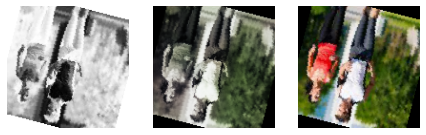

Epoch 1176 	 Loss: min = 0.003153730882331729; average = 0.0036215525615261868; max = 0.004472778178751469
Epoch 1177 	 Loss: min = 0.0028826259076595306; average = 0.0036765433324035257; max = 0.004486524499952793
Epoch 1178 	 Loss: min = 0.003037446178495884; average = 0.0035784409701591358; max = 0.004326820373535156
Epoch 1179 	 Loss: min = 0.0027939733117818832; average = 0.0035186637978767976; max = 0.004607894457876682
Epoch 1180 	 Loss: min = 0.0029158988036215305; average = 0.0038067384157329798; max = 0.00463611725717783


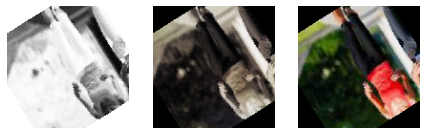

Epoch 1181 	 Loss: min = 0.003138042753562331; average = 0.0037376552645582706; max = 0.005275005009025335
Epoch 1182 	 Loss: min = 0.0027711428701877594; average = 0.003977438362198882; max = 0.006537021603435278
Epoch 1183 	 Loss: min = 0.002517488319426775; average = 0.0037668502773158252; max = 0.004512868821620941
Epoch 1184 	 Loss: min = 0.003093207720667124; average = 0.0036765667609870434; max = 0.004415992181748152
Epoch 1185 	 Loss: min = 0.002955903997644782; average = 0.0038140146934892982; max = 0.005319114774465561


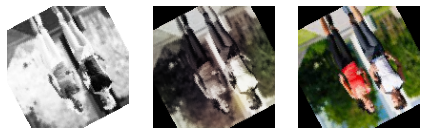

Epoch 1186 	 Loss: min = 0.0029475062619894743; average = 0.003769866467337124; max = 0.004967833869159222
Epoch 1187 	 Loss: min = 0.0029283142648637295; average = 0.0036782855167984962; max = 0.004351714625954628
Epoch 1188 	 Loss: min = 0.0026118215173482895; average = 0.0037164001842029393; max = 0.0067091877572238445
Epoch 1189 	 Loss: min = 0.0026615001261234283; average = 0.003586566206649877; max = 0.004440376069396734
Epoch 1190 	 Loss: min = 0.0028291642665863037; average = 0.0036994423862779513; max = 0.004983756225556135


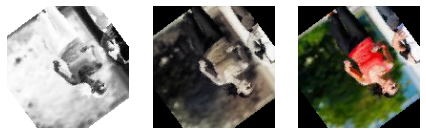

Epoch 1191 	 Loss: min = 0.0027447405736893415; average = 0.003802591614658013; max = 0.005412346683442593
Epoch 1192 	 Loss: min = 0.002608068287372589; average = 0.00360994492075406; max = 0.0069050174206495285
Epoch 1193 	 Loss: min = 0.002736937254667282; average = 0.0035490430891513824; max = 0.004667661152780056
Epoch 1194 	 Loss: min = 0.0028183774556964636; average = 0.0036068684130441397; max = 0.004858789034187794
Epoch 1195 	 Loss: min = 0.0029407318215817213; average = 0.0036795975611312315; max = 0.005050992593169212


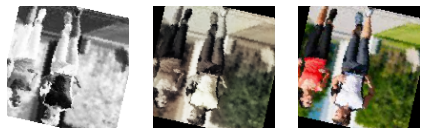

Epoch 1196 	 Loss: min = 0.00304354727268219; average = 0.0036664025392383337; max = 0.005632469896227121
Epoch 1197 	 Loss: min = 0.0030388932209461927; average = 0.0037034939596196637; max = 0.004847564734518528
Epoch 1198 	 Loss: min = 0.0028068895917385817; average = 0.003709301963681355; max = 0.004444542340934277
Epoch 1199 	 Loss: min = 0.0029754757415503263; average = 0.003609619874623604; max = 0.004695747513324022
Epoch 1200 	 Loss: min = 0.002573613775894046; average = 0.003591929897083901; max = 0.0044137099757790565


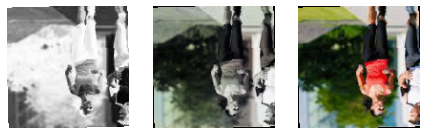

Epoch 1201 	 Loss: min = 0.002946276916190982; average = 0.003547366810380481; max = 0.004698306322097778
Epoch 1202 	 Loss: min = 0.0026948521845042706; average = 0.0036117438576184213; max = 0.004329105839133263
Epoch 1203 	 Loss: min = 0.0028898974414914846; average = 0.003348193713463843; max = 0.004027511924505234
Epoch 1204 	 Loss: min = 0.002608158392831683; average = 0.0037260951212374493; max = 0.0047568101435899734
Epoch 1205 	 Loss: min = 0.002825793344527483; average = 0.003442215980612673; max = 0.004228487145155668


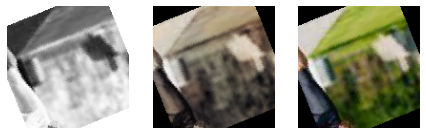

Epoch 1206 	 Loss: min = 0.0026045176200568676; average = 0.0035652073565870523; max = 0.004277966450899839
Epoch 1207 	 Loss: min = 0.002828028053045273; average = 0.003652939252788201; max = 0.004610437899827957
Epoch 1208 	 Loss: min = 0.0027293702587485313; average = 0.0035442982625681907; max = 0.004411227069795132
Epoch 1209 	 Loss: min = 0.00301562063395977; average = 0.0036640141624957323; max = 0.004388868343085051
Epoch 1210 	 Loss: min = 0.0030169046949595213; average = 0.0035523679107427597; max = 0.004325630143284798


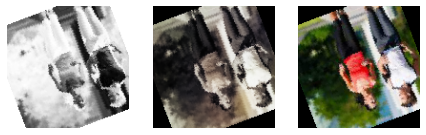

Epoch 1211 	 Loss: min = 0.0029786848463118076; average = 0.0036155171983409673; max = 0.004707610234618187
Epoch 1212 	 Loss: min = 0.0030433654319494963; average = 0.003675025553093292; max = 0.004743652418255806
Epoch 1213 	 Loss: min = 0.002773523796349764; average = 0.0035473821335472167; max = 0.004134664312005043
Epoch 1214 	 Loss: min = 0.002985212020576; average = 0.003607074191677384; max = 0.004119083285331726
Epoch 1215 	 Loss: min = 0.0026916456408798695; average = 0.0035560845280997455; max = 0.004355958662927151


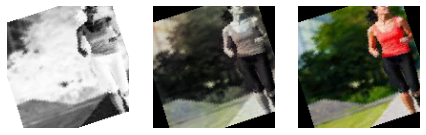

Epoch 1216 	 Loss: min = 0.003216593759134412; average = 0.003740302985534072; max = 0.004362875130027533
Epoch 1217 	 Loss: min = 0.0027501913718879223; average = 0.003609728053561412; max = 0.004407425876706839
Epoch 1218 	 Loss: min = 0.0027594193816184998; average = 0.0035046207485720515; max = 0.004344821907579899
Epoch 1219 	 Loss: min = 0.0028755273669958115; average = 0.003454569130553864; max = 0.0043930672109127045
Epoch 1220 	 Loss: min = 0.00272624334320426; average = 0.0035703680041478947; max = 0.004643281921744347


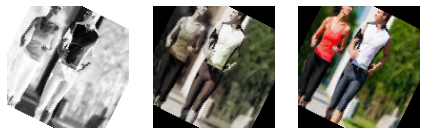

Epoch 1221 	 Loss: min = 0.0026825699023902416; average = 0.0034125355450669304; max = 0.0045217666774988174
Epoch 1222 	 Loss: min = 0.002898380858823657; average = 0.0036398912634467706; max = 0.00503257242962718
Epoch 1223 	 Loss: min = 0.003051220206543803; average = 0.003626238991273567; max = 0.004631256218999624
Epoch 1224 	 Loss: min = 0.002782639116048813; average = 0.0037932608101982623; max = 0.0047623999416828156
Epoch 1225 	 Loss: min = 0.0029269433580338955; average = 0.0034840078587876633; max = 0.004798701032996178


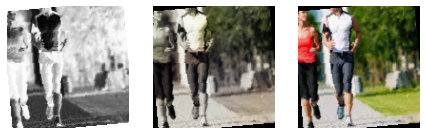

Epoch 1226 	 Loss: min = 0.0029204103630036116; average = 0.0034873594413511455; max = 0.004026481416076422
Epoch 1227 	 Loss: min = 0.002716726390644908; average = 0.0034402161836624146; max = 0.0040542567148804665
Epoch 1228 	 Loss: min = 0.002883149776607752; average = 0.003557719406671822; max = 0.0045126378536224365
Epoch 1229 	 Loss: min = 0.0029162566643208265; average = 0.0036559139552991837; max = 0.004616498481482267
Epoch 1230 	 Loss: min = 0.002824122551828623; average = 0.0035206168104195967; max = 0.004091850947588682


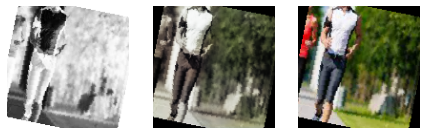

Epoch 1231 	 Loss: min = 0.002591429278254509; average = 0.0035423159424681216; max = 0.004529774188995361
Epoch 1232 	 Loss: min = 0.00300023821182549; average = 0.0038681756268488243; max = 0.0059083374217152596
Epoch 1233 	 Loss: min = 0.002933623269200325; average = 0.0037238656514091417; max = 0.005127157084643841
Epoch 1234 	 Loss: min = 0.0028268310707062483; average = 0.0035412868892308325; max = 0.004271048121154308
Epoch 1235 	 Loss: min = 0.00252131512388587; average = 0.0037678646040149033; max = 0.005207634065300226


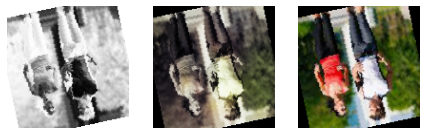

Epoch 1236 	 Loss: min = 0.0029901049565523863; average = 0.003449561365414411; max = 0.003910456318408251
Epoch 1237 	 Loss: min = 0.00294121028855443; average = 0.0035971643665106967; max = 0.0047631035558879375
Epoch 1238 	 Loss: min = 0.0027604997158050537; average = 0.003489638154860586; max = 0.004026634152978659
Epoch 1239 	 Loss: min = 0.002811647020280361; average = 0.0034969623666256666; max = 0.004346243571490049
Epoch 1240 	 Loss: min = 0.002856158185750246; average = 0.0034488457022234797; max = 0.004569443874061108


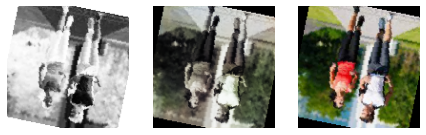

Epoch 1241 	 Loss: min = 0.002900717779994011; average = 0.003641737101133913; max = 0.005018280819058418
Epoch 1242 	 Loss: min = 0.003059079870581627; average = 0.0035550868924474344; max = 0.004554398357868195
Epoch 1243 	 Loss: min = 0.0029220758005976677; average = 0.0036780727823497728; max = 0.005367039702832699
Epoch 1244 	 Loss: min = 0.002693312242627144; average = 0.003549949571606703; max = 0.004276681691408157
Epoch 1245 	 Loss: min = 0.002695702947676182; average = 0.0034328478504903615; max = 0.004181688651442528


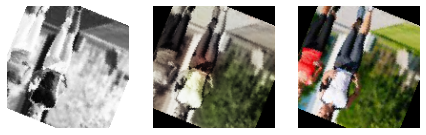

Epoch 1246 	 Loss: min = 0.0029279100708663464; average = 0.003540668563800864; max = 0.0045759426429867744
Epoch 1247 	 Loss: min = 0.0029014465399086475; average = 0.00332820531912148; max = 0.0038528903387486935
Epoch 1248 	 Loss: min = 0.0027261674404144287; average = 0.0038157280068844557; max = 0.0056751929223537445
Epoch 1249 	 Loss: min = 0.00281544285826385; average = 0.0034967295359820127; max = 0.0043070362880826
Epoch 1250 	 Loss: min = 0.0029899354558438063; average = 0.003728291383595206; max = 0.004664227366447449


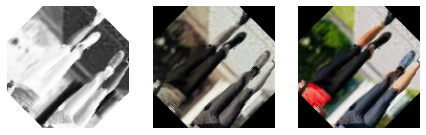

Epoch 1251 	 Loss: min = 0.0026128804311156273; average = 0.0035204734303988516; max = 0.005979110021144152
Epoch 1252 	 Loss: min = 0.002896518912166357; average = 0.0033047075412468985; max = 0.004551549442112446
Epoch 1253 	 Loss: min = 0.002859781961888075; average = 0.0035495473857736215; max = 0.005251983180642128
Epoch 1254 	 Loss: min = 0.0029307741206139326; average = 0.0035609092301456258; max = 0.004628710448741913
Epoch 1255 	 Loss: min = 0.003044035052880645; average = 0.003385917210835032; max = 0.0038799396716058254


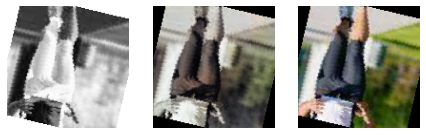

Epoch 1256 	 Loss: min = 0.0026281687896698713; average = 0.003630876279203221; max = 0.004553199280053377
Epoch 1257 	 Loss: min = 0.0025626979768276215; average = 0.0034406778286211193; max = 0.004214468412101269
Epoch 1258 	 Loss: min = 0.0028029175009578466; average = 0.0034785988100338727; max = 0.004350087605416775
Epoch 1259 	 Loss: min = 0.0027878384571522474; average = 0.0035165598237654194; max = 0.004174890927970409
Epoch 1260 	 Loss: min = 0.0027592794504016638; average = 0.0035135201615048572; max = 0.004658866673707962


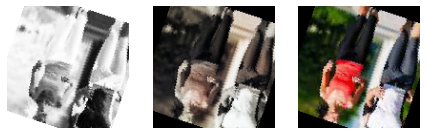

Epoch 1261 	 Loss: min = 0.0029265719931572676; average = 0.003627801444963552; max = 0.004748969338834286
Epoch 1262 	 Loss: min = 0.002854983089491725; average = 0.003546286156051792; max = 0.004371206276118755
Epoch 1263 	 Loss: min = 0.0025850136298686266; average = 0.0033549747604411095; max = 0.0039182668551802635
Epoch 1264 	 Loss: min = 0.0028670155443251133; average = 0.0034694923233473673; max = 0.004320697858929634
Epoch 1265 	 Loss: min = 0.002908949740231037; average = 0.0035272897948743775; max = 0.004354247357696295


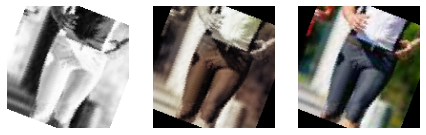

Epoch 1266 	 Loss: min = 0.002514767227694392; average = 0.003540613965014927; max = 0.0041903057135641575
Epoch 1267 	 Loss: min = 0.002550196833908558; average = 0.0033221635967493057; max = 0.004209103528410196
Epoch 1268 	 Loss: min = 0.0029218229465186596; average = 0.003611078587709926; max = 0.004574992228299379
Epoch 1269 	 Loss: min = 0.0028571784496307373; average = 0.003528732486302033; max = 0.00476632546633482
Epoch 1270 	 Loss: min = 0.002580955158919096; average = 0.0034377810661680996; max = 0.004573606885969639


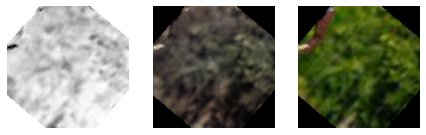

Epoch 1271 	 Loss: min = 0.0027975148987025023; average = 0.003616704445448704; max = 0.004965130239725113
Epoch 1272 	 Loss: min = 0.0026076696813106537; average = 0.003583417579648085; max = 0.005672091152518988
Epoch 1273 	 Loss: min = 0.003083702176809311; average = 0.003492678821203299; max = 0.004604489542543888
Epoch 1274 	 Loss: min = 0.0028809476643800735; average = 0.0036216404259903356; max = 0.00446634367108345
Epoch 1275 	 Loss: min = 0.00292326882481575; average = 0.0035471819282975048; max = 0.0048854467459023


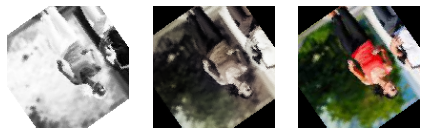

Epoch 1276 	 Loss: min = 0.002468379680067301; average = 0.003540460063959472; max = 0.0047905463725328445
Epoch 1277 	 Loss: min = 0.0027859369292855263; average = 0.0034559671476017684; max = 0.004354813136160374
Epoch 1278 	 Loss: min = 0.0027738530188798904; average = 0.003329096856759861; max = 0.004590220749378204
Epoch 1279 	 Loss: min = 0.002760303905233741; average = 0.003471211064606905; max = 0.004213255364447832
Epoch 1280 	 Loss: min = 0.002528256503865123; average = 0.0034299121325602755; max = 0.004257651977241039


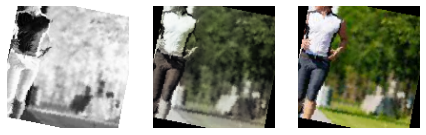

Epoch 1281 	 Loss: min = 0.00255404319614172; average = 0.003348153564729728; max = 0.004070622380822897
Epoch 1282 	 Loss: min = 0.0029199887067079544; average = 0.0034412824170431122; max = 0.00453209038823843
Epoch 1283 	 Loss: min = 0.0026648766361176968; average = 0.003359079360961914; max = 0.0045907869935035706
Epoch 1284 	 Loss: min = 0.002923217136412859; average = 0.003501847095321864; max = 0.0048142001032829285
Epoch 1285 	 Loss: min = 0.0029905899427831173; average = 0.0033789669832913205; max = 0.004143673460930586


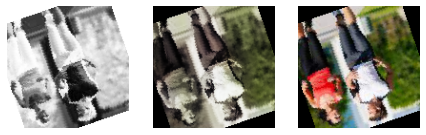

Epoch 1286 	 Loss: min = 0.0026303324848413467; average = 0.0032176663080463186; max = 0.004652116447687149
Epoch 1287 	 Loss: min = 0.0028811469674110413; average = 0.003493484895443544; max = 0.004994979128241539
Epoch 1288 	 Loss: min = 0.002619500271975994; average = 0.0034117182658519596; max = 0.004262874368578196
Epoch 1289 	 Loss: min = 0.0028888429515063763; average = 0.0035274153779027984; max = 0.004649203270673752
Epoch 1290 	 Loss: min = 0.002598826540634036; average = 0.0032764889765530825; max = 0.004752545617520809


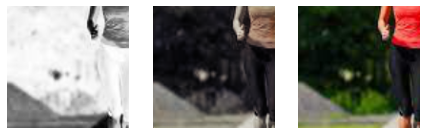

Epoch 1291 	 Loss: min = 0.0027863136492669582; average = 0.0033890722988871858; max = 0.004050503484904766
Epoch 1292 	 Loss: min = 0.0030352319590747356; average = 0.003570548171410337; max = 0.004507047589868307
Epoch 1293 	 Loss: min = 0.002713348250836134; average = 0.0033733315067365766; max = 0.003968854434788227
Epoch 1294 	 Loss: min = 0.0027294177561998367; average = 0.003407426120247692; max = 0.0038063954561948776
Epoch 1295 	 Loss: min = 0.002816425636410713; average = 0.0033676736493362114; max = 0.004359233193099499


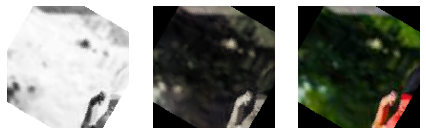

Epoch 1296 	 Loss: min = 0.002741335891187191; average = 0.003575618829927407; max = 0.005090888123959303
Epoch 1297 	 Loss: min = 0.0028714011423289776; average = 0.003660489179310389; max = 0.005384601652622223
Epoch 1298 	 Loss: min = 0.002970503643155098; average = 0.003512038485496305; max = 0.004438718315213919
Epoch 1299 	 Loss: min = 0.0026902954559773207; average = 0.0032902917155297473; max = 0.004043226595968008
Epoch 1300 	 Loss: min = 0.0027017106767743826; average = 0.003468434573733248; max = 0.004736373201012611


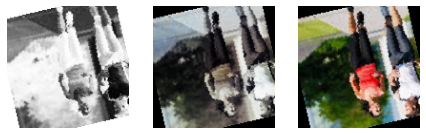

Epoch 1301 	 Loss: min = 0.002643695566803217; average = 0.0035435532336123288; max = 0.004248317331075668
Epoch 1302 	 Loss: min = 0.0027694860473275185; average = 0.0035139761021127924; max = 0.004583688918501139
Epoch 1303 	 Loss: min = 0.0027690939605236053; average = 0.003461972199147567; max = 0.0046591321006417274
Epoch 1304 	 Loss: min = 0.0026864930987358093; average = 0.0033371570898452774; max = 0.004271131008863449
Epoch 1305 	 Loss: min = 0.002511289669200778; average = 0.0034844572219299152; max = 0.004903975408524275


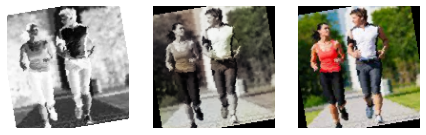

Epoch 1306 	 Loss: min = 0.0029087145812809467; average = 0.0033152884134324268; max = 0.0038446951657533646
Epoch 1307 	 Loss: min = 0.0026779468171298504; average = 0.0033712730946717784; max = 0.004010498058050871
Epoch 1308 	 Loss: min = 0.0028087571263313293; average = 0.0033942056325031444; max = 0.004123173654079437
Epoch 1309 	 Loss: min = 0.0026876237243413925; average = 0.003467694521532394; max = 0.00464852899312973
Epoch 1310 	 Loss: min = 0.002801325637847185; average = 0.0034119080810341984; max = 0.004470729734748602


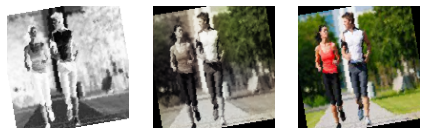

Epoch 1311 	 Loss: min = 0.002864646492525935; average = 0.0035405137605266646; max = 0.0054994020611047745
Epoch 1312 	 Loss: min = 0.002884855028241873; average = 0.003422915324335918; max = 0.004020375199615955
Epoch 1313 	 Loss: min = 0.002739319112151861; average = 0.0034077553427778184; max = 0.0041593401692807674
Epoch 1314 	 Loss: min = 0.0026743407361209393; average = 0.0032349489483749494; max = 0.0040057385340332985
Epoch 1315 	 Loss: min = 0.0026742711197584867; average = 0.003395547464606352; max = 0.004883431829512119


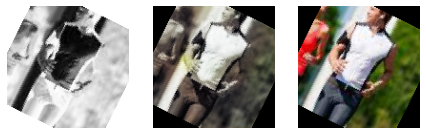

Epoch 1316 	 Loss: min = 0.00287814624607563; average = 0.003348248515976593; max = 0.00418378971517086
Epoch 1317 	 Loss: min = 0.0024574033450335264; average = 0.003353700856678188; max = 0.004125771578401327
Epoch 1318 	 Loss: min = 0.002481961390003562; average = 0.0033424593275412917; max = 0.00431956397369504
Epoch 1319 	 Loss: min = 0.002704286715015769; average = 0.003520669910358265; max = 0.005345083773136139
Epoch 1320 	 Loss: min = 0.0028593875467777252; average = 0.003388932571397163; max = 0.004294527694582939


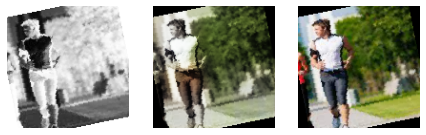

Epoch 1321 	 Loss: min = 0.0024839751422405243; average = 0.003362743358593434; max = 0.004368369467556477
Epoch 1322 	 Loss: min = 0.0030167773365974426; average = 0.0034692684857873246; max = 0.004020794294774532
Epoch 1323 	 Loss: min = 0.0027346729766577482; average = 0.003458528022747487; max = 0.004514947533607483
Epoch 1324 	 Loss: min = 0.002618705853819847; average = 0.0033454200311098248; max = 0.004028446041047573
Epoch 1325 	 Loss: min = 0.0027575574349611998; average = 0.0033957957930397242; max = 0.004630366340279579


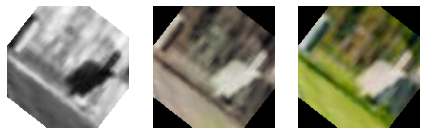

Epoch 1326 	 Loss: min = 0.0027900272980332375; average = 0.0033903281728271395; max = 0.004349060822278261
Epoch 1327 	 Loss: min = 0.0027594834100455046; average = 0.00323456474870909; max = 0.003808512818068266
Epoch 1328 	 Loss: min = 0.0028818014543503523; average = 0.0034799111308529973; max = 0.004433280788362026
Epoch 1329 	 Loss: min = 0.002676003612577915; average = 0.003583153069484979; max = 0.004576602019369602
Epoch 1330 	 Loss: min = 0.002813562750816345; average = 0.0033266197715420276; max = 0.003971902187913656


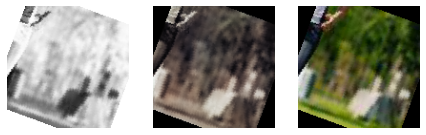

Epoch 1331 	 Loss: min = 0.002689475892111659; average = 0.0031799790303921327; max = 0.004059924278408289
Epoch 1332 	 Loss: min = 0.002793710445985198; average = 0.003235079158912413; max = 0.0042260074988007545
Epoch 1333 	 Loss: min = 0.0028101622592657804; average = 0.003426828989177011; max = 0.004515102133154869
Epoch 1334 	 Loss: min = 0.002723459852859378; average = 0.0033605264325160533; max = 0.00421128561720252
Epoch 1335 	 Loss: min = 0.0027519138529896736; average = 0.0032210602366831154; max = 0.00437852181494236


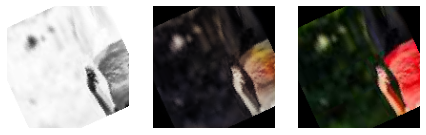

Epoch 1336 	 Loss: min = 0.0025251859333366156; average = 0.0034387144405627623; max = 0.004129464738070965
Epoch 1337 	 Loss: min = 0.002663418184965849; average = 0.0033229457767447457; max = 0.003697669832035899
Epoch 1338 	 Loss: min = 0.002812707331031561; average = 0.0034018549195025116; max = 0.00398615188896656
Epoch 1339 	 Loss: min = 0.002879283158108592; average = 0.0032861154613783583; max = 0.004136780276894569
Epoch 1340 	 Loss: min = 0.002544575138017535; average = 0.003384767915122211; max = 0.004633861593902111


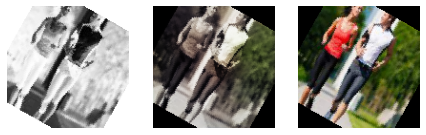

Epoch 1341 	 Loss: min = 0.0026848148554563522; average = 0.0033947185147553682; max = 0.0047006756067276
Epoch 1342 	 Loss: min = 0.0025961617939174175; average = 0.0031876418506726623; max = 0.0037234786432236433
Epoch 1343 	 Loss: min = 0.0025049573741853237; average = 0.0033581798779778183; max = 0.004087542649358511
Epoch 1344 	 Loss: min = 0.002931373193860054; average = 0.0033282878866884857; max = 0.004509250167757273
Epoch 1345 	 Loss: min = 0.002762982388958335; average = 0.0032602920109638944; max = 0.004061293788254261


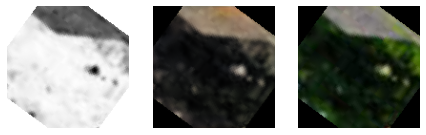

Epoch 1346 	 Loss: min = 0.0028102514334023; average = 0.0034611821320140734; max = 0.004476543981581926
Epoch 1347 	 Loss: min = 0.0028420202434062958; average = 0.00329816821613349; max = 0.004162119701504707
Epoch 1348 	 Loss: min = 0.002825260628014803; average = 0.0033601339091546834; max = 0.004166538827121258
Epoch 1349 	 Loss: min = 0.002635347191244364; average = 0.0033211310219485313; max = 0.004478521645069122
Epoch 1350 	 Loss: min = 0.002660454250872135; average = 0.003176227110088803; max = 0.004266473930329084


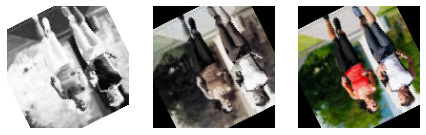

Epoch 1351 	 Loss: min = 0.0024797834921628237; average = 0.00327701419882942; max = 0.0039718737825751305
Epoch 1352 	 Loss: min = 0.002827052026987076; average = 0.003361635928740725; max = 0.00407036580145359
Epoch 1353 	 Loss: min = 0.002581285312771797; average = 0.003250227600801736; max = 0.0042811790481209755
Epoch 1354 	 Loss: min = 0.002784657059237361; average = 0.0033922631992027164; max = 0.004249898716807365
Epoch 1355 	 Loss: min = 0.0027003204450011253; average = 0.0032612083887215704; max = 0.0038092825561761856


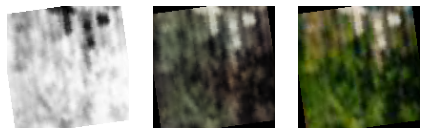

Epoch 1356 	 Loss: min = 0.0029682680033147335; average = 0.0035173475480405614; max = 0.004406298976391554
Epoch 1357 	 Loss: min = 0.0026377614121884108; average = 0.003189588795066811; max = 0.0040617212653160095
Epoch 1358 	 Loss: min = 0.0027400373946875334; average = 0.0033142046158900484; max = 0.004429277963936329
Epoch 1359 	 Loss: min = 0.0026120953261852264; average = 0.0032666688930476084; max = 0.004186859354376793
Epoch 1360 	 Loss: min = 0.0024469667114317417; average = 0.0033027899189619347; max = 0.004969201982021332


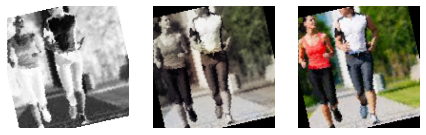

Epoch 1361 	 Loss: min = 0.0026106941513717175; average = 0.0032663710153428838; max = 0.004229809623211622
Epoch 1362 	 Loss: min = 0.0027136895805597305; average = 0.0032479088549735025; max = 0.003710795659571886
Epoch 1363 	 Loss: min = 0.0024803520645946264; average = 0.003101042879279703; max = 0.003475611563771963
Epoch 1364 	 Loss: min = 0.002312438329681754; average = 0.0032968744781101122; max = 0.0038577946834266186
Epoch 1365 	 Loss: min = 0.0026114298962056637; average = 0.0033251423737965524; max = 0.0044861119240522385


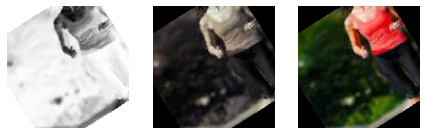

Epoch 1366 	 Loss: min = 0.002784691285341978; average = 0.003309613821329549; max = 0.003700727131217718
Epoch 1367 	 Loss: min = 0.0025241649709641933; average = 0.003247671091230586; max = 0.00438171811401844
Epoch 1368 	 Loss: min = 0.002606893889605999; average = 0.0032736262801336125; max = 0.004048475064337254
Epoch 1369 	 Loss: min = 0.002782879862934351; average = 0.003355131470016204; max = 0.004077415447682142
Epoch 1370 	 Loss: min = 0.0026750992983579636; average = 0.003189847484463826; max = 0.004030195530503988


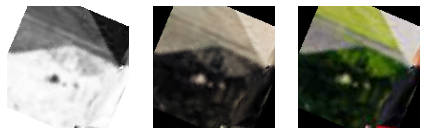

Epoch 1371 	 Loss: min = 0.002721584402024746; average = 0.003416935069253668; max = 0.0050949109718203545
Epoch 1372 	 Loss: min = 0.0027208486571907997; average = 0.003301961871329695; max = 0.004136109258979559
Epoch 1373 	 Loss: min = 0.002671365160495043; average = 0.0032257157436106354; max = 0.003668758552521467
Epoch 1374 	 Loss: min = 0.002855009399354458; average = 0.003218081488739699; max = 0.003971652127802372
Epoch 1375 	 Loss: min = 0.00248876865953207; average = 0.0033114046236732975; max = 0.004393198527395725


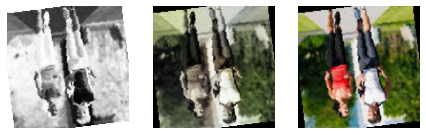

Epoch 1376 	 Loss: min = 0.0027572172693908215; average = 0.0033677456085570157; max = 0.004594710655510426
Epoch 1377 	 Loss: min = 0.002759695053100586; average = 0.0032846904068719596; max = 0.0038396231830120087
Epoch 1378 	 Loss: min = 0.002485642209649086; average = 0.0032584871514700353; max = 0.0037774730008095503
Epoch 1379 	 Loss: min = 0.00277261552400887; average = 0.003313713285024278; max = 0.0038386359810829163
Epoch 1380 	 Loss: min = 0.0024536706041544676; average = 0.0029666237969649956; max = 0.003958531655371189


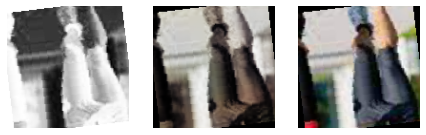

Epoch 1381 	 Loss: min = 0.0026063581462949514; average = 0.0031385940237669274; max = 0.003658900037407875
Epoch 1382 	 Loss: min = 0.002616747049614787; average = 0.0033059883426176384; max = 0.00403232965618372
Epoch 1383 	 Loss: min = 0.002565754111856222; average = 0.00320491760794539; max = 0.004334344062954187
Epoch 1384 	 Loss: min = 0.0025270008482038975; average = 0.0032744465861469507; max = 0.004110407084226608
Epoch 1385 	 Loss: min = 0.002569215139374137; average = 0.0032048237917479128; max = 0.004083222709596157


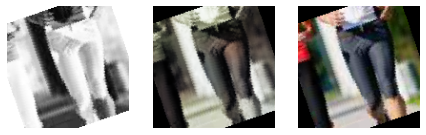

Epoch 1386 	 Loss: min = 0.0027714460156857967; average = 0.003217584337107837; max = 0.00395247433334589
Epoch 1387 	 Loss: min = 0.002653071191161871; average = 0.003349238249938935; max = 0.004241848364472389
Epoch 1388 	 Loss: min = 0.0025157583877444267; average = 0.0034636632772162557; max = 0.004845994524657726
Epoch 1389 	 Loss: min = 0.002684575505554676; average = 0.0032067556312540546; max = 0.00424910057336092
Epoch 1390 	 Loss: min = 0.0026694615371525288; average = 0.0032300982711603865; max = 0.0037861461751163006


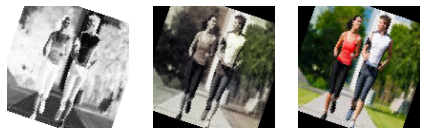

Epoch 1391 	 Loss: min = 0.002610253170132637; average = 0.0032174356892937794; max = 0.0038018557243049145
Epoch 1392 	 Loss: min = 0.0029103029519319534; average = 0.003281558441813104; max = 0.0041496832855045795
Epoch 1393 	 Loss: min = 0.002608282957226038; average = 0.003108225922915153; max = 0.003940234892070293
Epoch 1394 	 Loss: min = 0.0027525341138243675; average = 0.003200521896360442; max = 0.0036457590758800507
Epoch 1395 	 Loss: min = 0.002367829903960228; average = 0.003401150504942052; max = 0.0045011648908257484


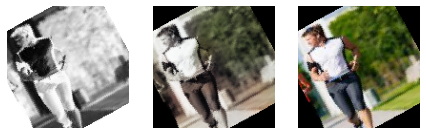

Epoch 1396 	 Loss: min = 0.0027705389074981213; average = 0.003171270145685412; max = 0.003780731465667486
Epoch 1397 	 Loss: min = 0.0026305802166461945; average = 0.0033002879208652303; max = 0.004762369208037853
Epoch 1398 	 Loss: min = 0.002824456198140979; average = 0.0033305253891739994; max = 0.0043025449849665165
Epoch 1399 	 Loss: min = 0.0026579410769045353; average = 0.003384013267350383; max = 0.004726701881736517
Epoch 1400 	 Loss: min = 0.0026550216134637594; average = 0.003383268660400063; max = 0.004551754333078861


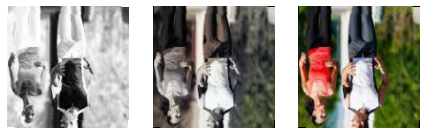

Epoch 1401 	 Loss: min = 0.0027327975258231163; average = 0.003369550031493418; max = 0.004735028371214867
Epoch 1402 	 Loss: min = 0.0026274777483195066; average = 0.003376326130819507; max = 0.00393957132473588
Epoch 1403 	 Loss: min = 0.002632811665534973; average = 0.003317525508464314; max = 0.004163344390690327
Epoch 1404 	 Loss: min = 0.00256742094643414; average = 0.003249111381592229; max = 0.004087486304342747
Epoch 1405 	 Loss: min = 0.0026954577770084143; average = 0.0031897451844997704; max = 0.004115171264857054


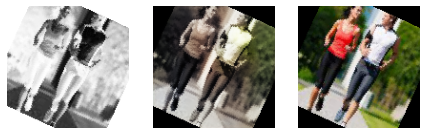

Epoch 1406 	 Loss: min = 0.0027451857458800077; average = 0.003289381813374348; max = 0.004197489470243454
Epoch 1407 	 Loss: min = 0.002626307774335146; average = 0.0032231922377832234; max = 0.004060258623212576
Epoch 1408 	 Loss: min = 0.002653063042089343; average = 0.0032223871676251292; max = 0.0042314687743783
Epoch 1409 	 Loss: min = 0.0027056909166276455; average = 0.0031739316909806803; max = 0.004022175446152687
Epoch 1410 	 Loss: min = 0.0027327612042427063; average = 0.003225237946026027; max = 0.003899921430274844


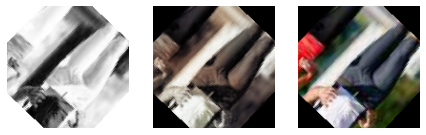

Epoch 1411 	 Loss: min = 0.002383508486673236; average = 0.003368415462318808; max = 0.004178121220320463
Epoch 1412 	 Loss: min = 0.0026875778567045927; average = 0.003236094897147268; max = 0.00381329283118248
Epoch 1413 	 Loss: min = 0.0027114572003483772; average = 0.00314484337286558; max = 0.003795927157625556
Epoch 1414 	 Loss: min = 0.002503302413970232; average = 0.0031077179446583614; max = 0.004307526629418135
Epoch 1415 	 Loss: min = 0.002697921823710203; average = 0.0032161425187950954; max = 0.004006804898381233


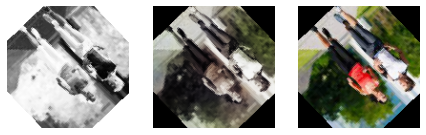

Epoch 1416 	 Loss: min = 0.002602881286293268; average = 0.0032102439436130226; max = 0.004604732617735863
Epoch 1417 	 Loss: min = 0.0026207342743873596; average = 0.0033804832346504554; max = 0.00433915201574564
Epoch 1418 	 Loss: min = 0.002592800185084343; average = 0.003167686620145105; max = 0.0039058388210833073
Epoch 1419 	 Loss: min = 0.0025191744789481163; average = 0.003139023363473825; max = 0.004322448279708624
Epoch 1420 	 Loss: min = 0.002805212279781699; average = 0.0031801698642084375; max = 0.00368970213457942


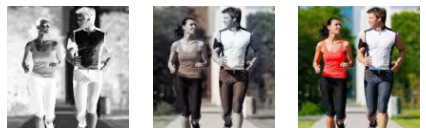

Epoch 1421 	 Loss: min = 0.0026365946978330612; average = 0.003178137500071898; max = 0.003935581538826227
Epoch 1422 	 Loss: min = 0.0027042622677981853; average = 0.0031837003480177373; max = 0.004911276511847973
Epoch 1423 	 Loss: min = 0.0025093192234635353; average = 0.0031537016766378656; max = 0.0037838402204215527
Epoch 1424 	 Loss: min = 0.0026681243907660246; average = 0.003128799391561188; max = 0.005083550699055195
Epoch 1425 	 Loss: min = 0.0025946544483304024; average = 0.003135409322567284; max = 0.00394779397174716


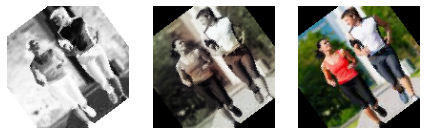

Epoch 1426 	 Loss: min = 0.002694401890039444; average = 0.0032580266997683793; max = 0.004591511096805334
Epoch 1427 	 Loss: min = 0.002755599794909358; average = 0.0034473392443032935; max = 0.004873340949416161
Epoch 1428 	 Loss: min = 0.002407342428341508; average = 0.003085159827605821; max = 0.0036580227315425873
Epoch 1429 	 Loss: min = 0.002664279891178012; average = 0.0035032645100727677; max = 0.004377888049930334
Epoch 1430 	 Loss: min = 0.0025011368561536074; average = 0.0032088408042909577; max = 0.004167630337178707


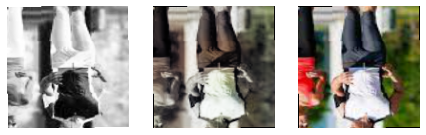

Epoch 1431 	 Loss: min = 0.002538681961596012; average = 0.0031663258705521002; max = 0.003972506150603294
Epoch 1432 	 Loss: min = 0.002566412789747119; average = 0.0032227639167103916; max = 0.003952798433601856
Epoch 1433 	 Loss: min = 0.0025967794936150312; average = 0.0033801937388489023; max = 0.004164686426520348
Epoch 1434 	 Loss: min = 0.002487808233126998; average = 0.0030902136641088873; max = 0.003711532335728407
Epoch 1435 	 Loss: min = 0.0028214561752974987; average = 0.0031340740679297596; max = 0.003657619236037135


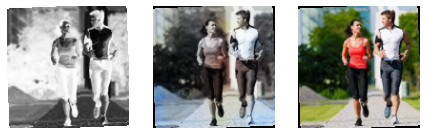

Epoch 1436 	 Loss: min = 0.0025302942376583815; average = 0.0032583115535089746; max = 0.004213566891849041
Epoch 1437 	 Loss: min = 0.002169744810089469; average = 0.003150598771753721; max = 0.004314965568482876
Epoch 1438 	 Loss: min = 0.0025440736208111048; average = 0.003296499839052558; max = 0.00478184362873435
Epoch 1439 	 Loss: min = 0.002793447580188513; average = 0.0032581116538494825; max = 0.004301238805055618
Epoch 1440 	 Loss: min = 0.0024738251231610775; average = 0.0029490773158613592; max = 0.003385003190487623


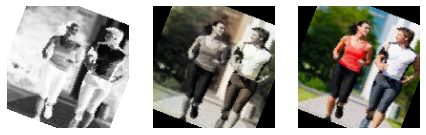

Epoch 1441 	 Loss: min = 0.002377126831561327; average = 0.0030938159179640934; max = 0.00352436862885952
Epoch 1442 	 Loss: min = 0.0026693912222981453; average = 0.003298085110145621; max = 0.004122299142181873
Epoch 1443 	 Loss: min = 0.002508149016648531; average = 0.002990611785207875; max = 0.0036082814913243055
Epoch 1444 	 Loss: min = 0.0024681524373590946; average = 0.0032177854154724628; max = 0.004237828776240349
Epoch 1445 	 Loss: min = 0.002604124369099736; average = 0.003254634255426936; max = 0.004374716430902481


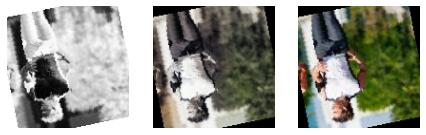

Epoch 1446 	 Loss: min = 0.0024712313897907734; average = 0.0030455548112513497; max = 0.004127075430005789
Epoch 1447 	 Loss: min = 0.002718378556892276; average = 0.00320322196057532; max = 0.004331581760197878
Epoch 1448 	 Loss: min = 0.0026514807250350714; average = 0.003123973758192733; max = 0.0038666657637804747
Epoch 1449 	 Loss: min = 0.0024838950484991074; average = 0.003035726971575059; max = 0.0038136837538331747
Epoch 1450 	 Loss: min = 0.0026239980943500996; average = 0.003082556926528923; max = 0.003707815892994404


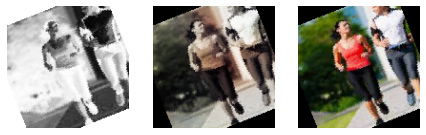

Epoch 1451 	 Loss: min = 0.002655396703630686; average = 0.003111393118160777; max = 0.004144764970988035
Epoch 1452 	 Loss: min = 0.002483863616362214; average = 0.003174045545165427; max = 0.004065307788550854
Epoch 1453 	 Loss: min = 0.0028348283376544714; average = 0.0031465973443118855; max = 0.0040557668544352055
Epoch 1454 	 Loss: min = 0.0024825651198625565; average = 0.0032119751267600805; max = 0.003927312791347504
Epoch 1455 	 Loss: min = 0.002620702376589179; average = 0.0030405192082980648; max = 0.0036925552412867546


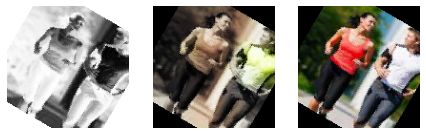

Epoch 1456 	 Loss: min = 0.002567566931247711; average = 0.0031104159425012767; max = 0.003932157065719366
Epoch 1457 	 Loss: min = 0.002698739990592003; average = 0.0030906924075679854; max = 0.0036861717235296965
Epoch 1458 	 Loss: min = 0.0025773474480956793; average = 0.0031245810678228736; max = 0.004151135683059692
Epoch 1459 	 Loss: min = 0.0028133662417531013; average = 0.003265072955400683; max = 0.0043272217735648155
Epoch 1460 	 Loss: min = 0.002480139257386327; average = 0.0032517963409190997; max = 0.004122097045183182


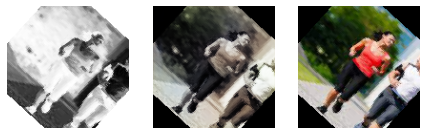

Epoch 1461 	 Loss: min = 0.0026841077487915754; average = 0.003147148323478177; max = 0.0035821967758238316
Epoch 1462 	 Loss: min = 0.002473000902682543; average = 0.0030864960135659203; max = 0.003883001860231161
Epoch 1463 	 Loss: min = 0.0023257723078131676; average = 0.0031216359639074653; max = 0.003975847270339727
Epoch 1464 	 Loss: min = 0.002606163499876857; average = 0.003145957089145668; max = 0.0039581842720508575
Epoch 1465 	 Loss: min = 0.002271408913657069; average = 0.003017248716787435; max = 0.0035770870745182037


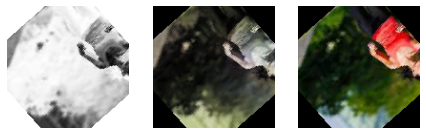

Epoch 1466 	 Loss: min = 0.0024102325551211834; average = 0.0031089602125575766; max = 0.0044246213510632515
Epoch 1467 	 Loss: min = 0.0024939950089901686; average = 0.0031707041489426047; max = 0.004755240865051746
Epoch 1468 	 Loss: min = 0.00236455793492496; average = 0.003009466512594372; max = 0.003768435912206769
Epoch 1469 	 Loss: min = 0.0027098506689071655; average = 0.0031613467435818166; max = 0.003792577888816595
Epoch 1470 	 Loss: min = 0.0026403572410345078; average = 0.003051241408684291; max = 0.0035974818747490644


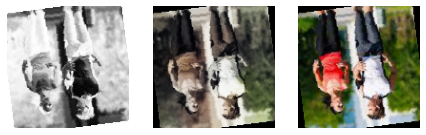

Epoch 1471 	 Loss: min = 0.002516098553314805; average = 0.003006485741934739; max = 0.003494312521070242
Epoch 1472 	 Loss: min = 0.0025956816971302032; average = 0.0030305341497296467; max = 0.0040326304733753204
Epoch 1473 	 Loss: min = 0.0024241418577730656; average = 0.0030655260488856584; max = 0.003600744064897299
Epoch 1474 	 Loss: min = 0.002469324041157961; average = 0.003154547870508395; max = 0.004229597747325897
Epoch 1475 	 Loss: min = 0.002735067857429385; average = 0.0032060171506600454; max = 0.004000048618763685


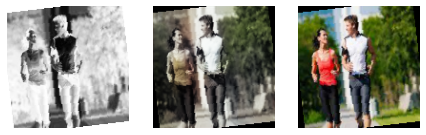

Epoch 1476 	 Loss: min = 0.0027857969980686903; average = 0.0031672099139541388; max = 0.0037900700699537992
Epoch 1477 	 Loss: min = 0.002580429660156369; average = 0.0030351745226653293; max = 0.003969610668718815
Epoch 1478 	 Loss: min = 0.002585170790553093; average = 0.0031266742444131523; max = 0.004326016642153263
Epoch 1479 	 Loss: min = 0.0025529563426971436; average = 0.003079619418713264; max = 0.003679787740111351
Epoch 1480 	 Loss: min = 0.0023773671127855778; average = 0.00309971155365929; max = 0.004999805241823196


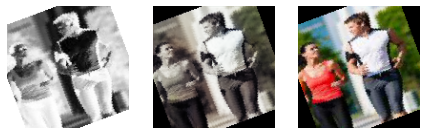

Epoch 1481 	 Loss: min = 0.0025788452476263046; average = 0.003082850424107164; max = 0.0035192137584090233
Epoch 1482 	 Loss: min = 0.002709910972043872; average = 0.0031187769200187176; max = 0.004525505937635899
Epoch 1483 	 Loss: min = 0.002731424756348133; average = 0.0031594723695889115; max = 0.004095568787306547
Epoch 1484 	 Loss: min = 0.0025342830922454596; average = 0.003168596333125606; max = 0.004285155795514584
Epoch 1485 	 Loss: min = 0.0025920639745891094; average = 0.0029655062971869484; max = 0.003517146222293377


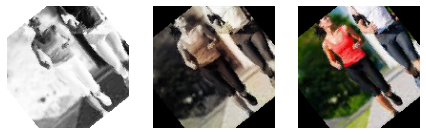

Epoch 1486 	 Loss: min = 0.002517575165256858; average = 0.00302135938545689; max = 0.003867854131385684
Epoch 1487 	 Loss: min = 0.002437056042253971; average = 0.00302440018276684; max = 0.00410093367099762
Epoch 1488 	 Loss: min = 0.002779539441689849; average = 0.003077487926930189; max = 0.0039006106089800596
Epoch 1489 	 Loss: min = 0.002446727827191353; average = 0.002948625769931823; max = 0.003967217169702053
Epoch 1490 	 Loss: min = 0.00245912978425622; average = 0.003007259700098075; max = 0.003718163352459669


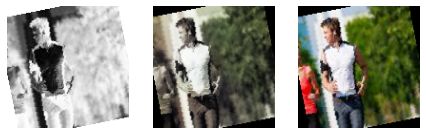

Epoch 1491 	 Loss: min = 0.0023310098331421614; average = 0.002946121952845715; max = 0.003565901890397072
Epoch 1492 	 Loss: min = 0.0024387703742831945; average = 0.00303866236936301; max = 0.0037587592378258705
Epoch 1493 	 Loss: min = 0.0024016143288463354; average = 0.003264677827246487; max = 0.004263522103428841
Epoch 1494 	 Loss: min = 0.0025846154894679785; average = 0.0031315735686803237; max = 0.0038895055186003447
Epoch 1495 	 Loss: min = 0.0026154133956879377; average = 0.0031108803814277053; max = 0.003991390578448772


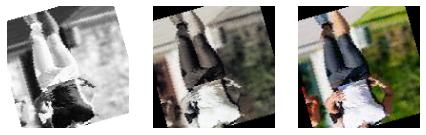

Epoch 1496 	 Loss: min = 0.002584245288744569; average = 0.0030588657973567024; max = 0.00431993929669261
Epoch 1497 	 Loss: min = 0.0025763283483684063; average = 0.0031527547544101253; max = 0.004015953280031681
Epoch 1498 	 Loss: min = 0.0027047067414969206; average = 0.0030768001306569204; max = 0.0040575722232460976
Epoch 1499 	 Loss: min = 0.0023617532569915056; average = 0.003020360309164971; max = 0.003576050978153944
Epoch 1500 	 Loss: min = 0.002482188865542412; average = 0.0030618932360084727; max = 0.0035300329327583313


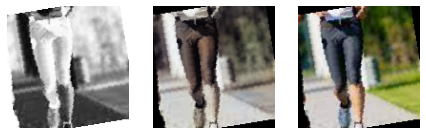

Epoch 1501 	 Loss: min = 0.002615563338622451; average = 0.003221197650418617; max = 0.004018980544060469
Epoch 1502 	 Loss: min = 0.00229612085968256; average = 0.0030797365034231916; max = 0.0038492046296596527
Epoch 1503 	 Loss: min = 0.0025934106670320034; average = 0.0030030308553250507; max = 0.0034590321592986584
Epoch 1504 	 Loss: min = 0.0023004612885415554; average = 0.003155817379592918; max = 0.00409161439165473
Epoch 1505 	 Loss: min = 0.0024329754523932934; average = 0.0029740503669017926; max = 0.0037264488637447357


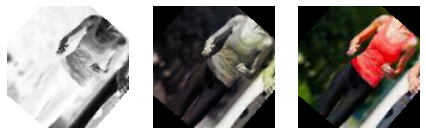

Epoch 1506 	 Loss: min = 0.002417103387415409; average = 0.0030983322649262846; max = 0.0051314556039869785
Epoch 1507 	 Loss: min = 0.0024133161641657352; average = 0.0032077688520075753; max = 0.004439357202500105
Epoch 1508 	 Loss: min = 0.0023558458779007196; average = 0.003029995918041095; max = 0.003788052126765251
Epoch 1509 	 Loss: min = 0.0026721241883933544; average = 0.003101283044088632; max = 0.003460338106378913
Epoch 1510 	 Loss: min = 0.002462527249008417; average = 0.0031594000611221418; max = 0.004008084535598755


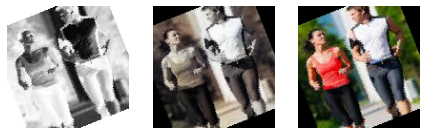

Epoch 1511 	 Loss: min = 0.002535745268687606; average = 0.0032068805012386292; max = 0.0042001414112746716
Epoch 1512 	 Loss: min = 0.0025840611197054386; average = 0.003048024285817519; max = 0.003662950126454234
Epoch 1513 	 Loss: min = 0.0024033254012465477; average = 0.0032370238477597013; max = 0.003961286973208189
Epoch 1514 	 Loss: min = 0.00259308866225183; average = 0.0031052016420289874; max = 0.003818557132035494
Epoch 1515 	 Loss: min = 0.0025829568039625883; average = 0.0029903136746725067; max = 0.003405932802706957


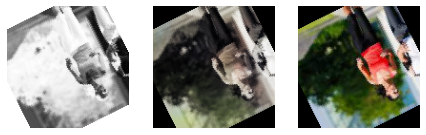

Epoch 1516 	 Loss: min = 0.0023257057182490826; average = 0.0028934513975400478; max = 0.0037834353279322386
Epoch 1517 	 Loss: min = 0.002441232791170478; average = 0.002938181714853272; max = 0.003998005762696266
Epoch 1518 	 Loss: min = 0.0024200386833399534; average = 0.003079720481764525; max = 0.004211378283798695
Epoch 1519 	 Loss: min = 0.0021944879554212093; average = 0.003233067982364446; max = 0.0042605153284966946
Epoch 1520 	 Loss: min = 0.002569456584751606; average = 0.0032331111578969285; max = 0.004217705223709345


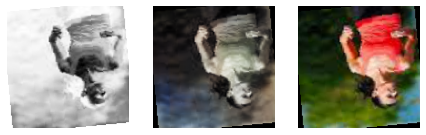

Epoch 1521 	 Loss: min = 0.0024795341305434704; average = 0.003012908680830151; max = 0.0034770905040204525
Epoch 1522 	 Loss: min = 0.0026544686406850815; average = 0.0031081810157047585; max = 0.004440168384462595
Epoch 1523 	 Loss: min = 0.002445769961923361; average = 0.0031106857204576954; max = 0.0038099929224699736
Epoch 1524 	 Loss: min = 0.0023443708196282387; average = 0.003003861813340336; max = 0.003676503896713257
Epoch 1525 	 Loss: min = 0.0026178378611803055; average = 0.0031356465915450826; max = 0.003977352753281593


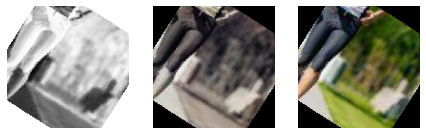

Epoch 1526 	 Loss: min = 0.0026212434750050306; average = 0.0032687931961845607; max = 0.004404214210808277
Epoch 1527 	 Loss: min = 0.0024726027622818947; average = 0.0031930197728797793; max = 0.004708780907094479
Epoch 1528 	 Loss: min = 0.0026711607351899147; average = 0.0030642070341855288; max = 0.003750138683244586
Epoch 1529 	 Loss: min = 0.0024906378239393234; average = 0.002957210672320798; max = 0.0038756486028432846
Epoch 1530 	 Loss: min = 0.0024351216852664948; average = 0.0029747459338977933; max = 0.0038020543288439512


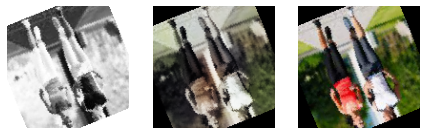

Epoch 1531 	 Loss: min = 0.002484880154952407; average = 0.002994584239786491; max = 0.003440642496570945
Epoch 1532 	 Loss: min = 0.0023209776263684034; average = 0.0030614337738370523; max = 0.004030306823551655
Epoch 1533 	 Loss: min = 0.0024873653892427683; average = 0.003033842527656816; max = 0.004682453814893961
Epoch 1534 	 Loss: min = 0.0024946904741227627; average = 0.002972269125166349; max = 0.0033923215232789516
Epoch 1535 	 Loss: min = 0.0025155970361083746; average = 0.0030624617502326146; max = 0.0036997750867158175


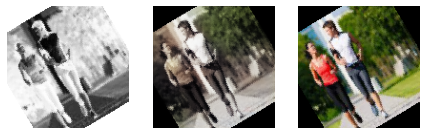

Epoch 1536 	 Loss: min = 0.0026444117538630962; average = 0.0031486705847783014; max = 0.004283004440367222
Epoch 1537 	 Loss: min = 0.0023990056943148375; average = 0.0029150145855965093; max = 0.0037415269762277603
Epoch 1538 	 Loss: min = 0.002648361958563328; average = 0.0031968425755621865; max = 0.0038147922605276108
Epoch 1539 	 Loss: min = 0.0026072748005390167; average = 0.003122552312561311; max = 0.0037450692616403103
Epoch 1540 	 Loss: min = 0.0024587870575487614; average = 0.0029307310469448566; max = 0.0038602985441684723


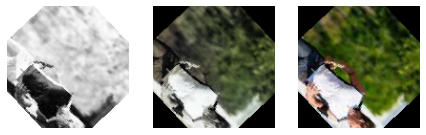

Epoch 1541 	 Loss: min = 0.0024761962704360485; average = 0.0030051306093810126; max = 0.003626973135396838
Epoch 1542 	 Loss: min = 0.0024833434727042913; average = 0.002974261122290045; max = 0.0036380672827363014
Epoch 1543 	 Loss: min = 0.0023652436211705208; average = 0.0031305519660236314; max = 0.003967821132391691
Epoch 1544 	 Loss: min = 0.0024266988039016724; average = 0.002952929527964443; max = 0.0036698412150144577
Epoch 1545 	 Loss: min = 0.002206242410466075; average = 0.0030086762126302347; max = 0.00417919410392642


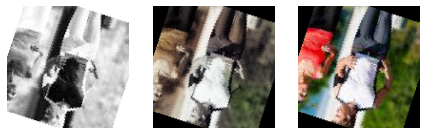

Epoch 1546 	 Loss: min = 0.0024513602256774902; average = 0.003084701398620382; max = 0.004536831751465797
Epoch 1547 	 Loss: min = 0.002430328633636236; average = 0.003034877954632975; max = 0.005163662135601044
Epoch 1548 	 Loss: min = 0.002271111123263836; average = 0.0029790054686600342; max = 0.003732742741703987
Epoch 1549 	 Loss: min = 0.00258332840166986; average = 0.0030378056108020246; max = 0.0037422082386910915
Epoch 1550 	 Loss: min = 0.002456052228808403; average = 0.0030808537267148495; max = 0.004043359309434891


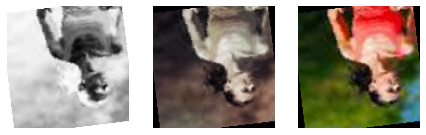

Epoch 1551 	 Loss: min = 0.002543375361710787; average = 0.003032392283785157; max = 0.003839700948446989
Epoch 1552 	 Loss: min = 0.0024180186446756124; average = 0.0029450297151925042; max = 0.0035536966752260923
Epoch 1553 	 Loss: min = 0.0025326786562800407; average = 0.002992346737300977; max = 0.0035498589277267456
Epoch 1554 	 Loss: min = 0.002445199294015765; average = 0.00297473871614784; max = 0.0036991098895668983
Epoch 1555 	 Loss: min = 0.0025556012988090515; average = 0.00301123209646903; max = 0.0036034625954926014


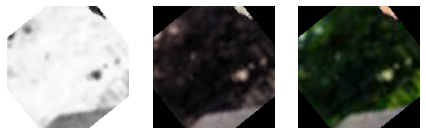

Epoch 1556 	 Loss: min = 0.0023184639867395163; average = 0.003058432790567167; max = 0.0040094549767673016
Epoch 1557 	 Loss: min = 0.0024104046169668436; average = 0.0029142429411876947; max = 0.0035177587997168303
Epoch 1558 	 Loss: min = 0.0025765986647456884; average = 0.0030509258940583095; max = 0.0035367475356906652
Epoch 1559 	 Loss: min = 0.0027330927550792694; average = 0.0030035502568352968; max = 0.0034769224002957344
Epoch 1560 	 Loss: min = 0.0023237201385200024; average = 0.002971555615658872; max = 0.003923923708498478


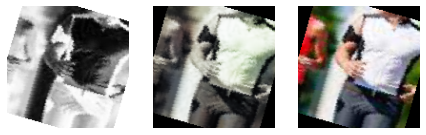

Epoch 1561 	 Loss: min = 0.002297057770192623; average = 0.0030832058255327865; max = 0.0037928950041532516
Epoch 1562 	 Loss: min = 0.0024125641211867332; average = 0.00312481596483849; max = 0.004455165006220341
Epoch 1563 	 Loss: min = 0.0024225676897913218; average = 0.0029491703025996685; max = 0.003905076067894697
Epoch 1564 	 Loss: min = 0.0025820452719926834; average = 0.0029588956967927516; max = 0.0037307206075638533
Epoch 1565 	 Loss: min = 0.002632210962474346; average = 0.003100907153566368; max = 0.003800976788625121


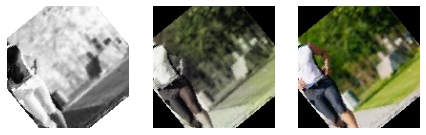

Epoch 1566 	 Loss: min = 0.002571103163063526; average = 0.0030549476359738037; max = 0.003630967577919364
Epoch 1567 	 Loss: min = 0.0023562090937048197; average = 0.0029024652467342094; max = 0.003373781917616725
Epoch 1568 	 Loss: min = 0.002484590047970414; average = 0.002973828712129034; max = 0.00378918694332242
Epoch 1569 	 Loss: min = 0.0024149594828486443; average = 0.0029848132689949125; max = 0.0034399288706481457
Epoch 1570 	 Loss: min = 0.002637052908539772; average = 0.0031331638747360557; max = 0.003960825502872467


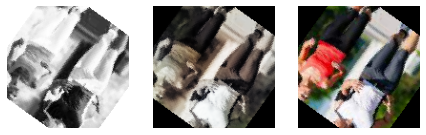

Epoch 1571 	 Loss: min = 0.002401696052402258; average = 0.002852900914149359; max = 0.0039013808127492666
Epoch 1572 	 Loss: min = 0.002336501609534025; average = 0.0029570276819868013; max = 0.0036981224548071623
Epoch 1573 	 Loss: min = 0.002496905392035842; average = 0.0028982863732380792; max = 0.003472255077213049
Epoch 1574 	 Loss: min = 0.0026051511522382498; average = 0.0030071813380345702; max = 0.004201116506010294
Epoch 1575 	 Loss: min = 0.0026140871923416853; average = 0.0029663204186363146; max = 0.0035123617853969336


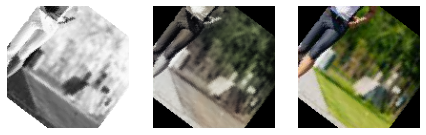

Epoch 1576 	 Loss: min = 0.002605462446808815; average = 0.00302416124031879; max = 0.003944092895835638
Epoch 1577 	 Loss: min = 0.00266810180619359; average = 0.0030468344048131257; max = 0.003566243452951312
Epoch 1578 	 Loss: min = 0.0024318795185536146; average = 0.0029301764152478427; max = 0.0037392056547105312
Epoch 1579 	 Loss: min = 0.0024044581223279238; average = 0.002849719487130642; max = 0.003214757889509201
Epoch 1580 	 Loss: min = 0.002382150385528803; average = 0.0029369235562626272; max = 0.0037415605038404465


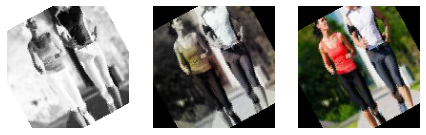

Epoch 1581 	 Loss: min = 0.002600838430225849; average = 0.00292204154538922; max = 0.0032606094609946012
Epoch 1582 	 Loss: min = 0.0025795723777264357; average = 0.0029821101197740063; max = 0.0034346245229244232
Epoch 1583 	 Loss: min = 0.002425975864753127; average = 0.0028134569147368893; max = 0.0033107842318713665
Epoch 1584 	 Loss: min = 0.0025813416577875614; average = 0.0030483697628369555; max = 0.00409600418061018
Epoch 1585 	 Loss: min = 0.0025075224693864584; average = 0.0030904763261787593; max = 0.0036963578313589096


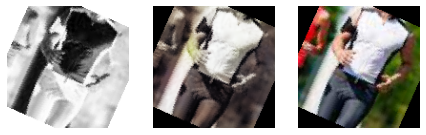

Epoch 1586 	 Loss: min = 0.002297887811437249; average = 0.003016765127540566; max = 0.0041736336424946785
Epoch 1587 	 Loss: min = 0.0024782223626971245; average = 0.0029268340003909543; max = 0.0033155090641230345
Epoch 1588 	 Loss: min = 0.002493067178875208; average = 0.0029476235358742997; max = 0.003880887757986784
Epoch 1589 	 Loss: min = 0.002455725334584713; average = 0.002971704539959319; max = 0.003514400450512767
Epoch 1590 	 Loss: min = 0.0024444505106657743; average = 0.0029995251388754696; max = 0.004057345911860466


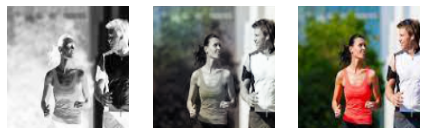

Epoch 1591 	 Loss: min = 0.00237779738381505; average = 0.003066456629312597; max = 0.003855504095554352
Epoch 1592 	 Loss: min = 0.0024505285546183586; average = 0.003155514903482981; max = 0.004181926138699055
Epoch 1593 	 Loss: min = 0.0024797290097922087; average = 0.002911356234108098; max = 0.003402548609301448
Epoch 1594 	 Loss: min = 0.0024873127695173025; average = 0.0028957026515854523; max = 0.0036316774785518646
Epoch 1595 	 Loss: min = 0.0025207684375345707; average = 0.003255141753470525; max = 0.004299544729292393


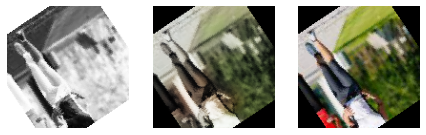

Epoch 1596 	 Loss: min = 0.002420311328023672; average = 0.003003003861522302; max = 0.004164665937423706
Epoch 1597 	 Loss: min = 0.002457799855619669; average = 0.0029389165138127282; max = 0.003528829663991928
Epoch 1598 	 Loss: min = 0.0025582776870578527; average = 0.0031362613226519898; max = 0.005481509026139975
Epoch 1599 	 Loss: min = 0.0024590007960796356; average = 0.0030864633881719783; max = 0.00381984980776906
Epoch 1600 	 Loss: min = 0.002578360727056861; average = 0.003115599465672858; max = 0.004233138170093298


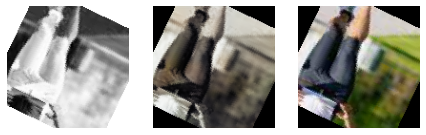

Epoch 1601 	 Loss: min = 0.0023516900837421417; average = 0.0029628337651956826; max = 0.0034517168533056974
Epoch 1602 	 Loss: min = 0.002551318146288395; average = 0.0031084167712833732; max = 0.003681567031890154
Epoch 1603 	 Loss: min = 0.0023226141929626465; average = 0.0029957032966194674; max = 0.003715934930369258
Epoch 1604 	 Loss: min = 0.002319110557436943; average = 0.0029004936368437484; max = 0.003605953650549054
Epoch 1605 	 Loss: min = 0.002396129537373781; average = 0.0030212532001314685; max = 0.003716137260198593


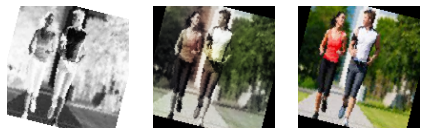

Epoch 1606 	 Loss: min = 0.0022174399346113205; average = 0.0029056369967292994; max = 0.0037039266899228096
Epoch 1607 	 Loss: min = 0.002460506744682789; average = 0.0029359130712691694; max = 0.00395986158400774
Epoch 1608 	 Loss: min = 0.002293891040608287; average = 0.002916325451224111; max = 0.0034493226557970047
Epoch 1609 	 Loss: min = 0.002289963886141777; average = 0.0029918986547272652; max = 0.003975444007664919
Epoch 1610 	 Loss: min = 0.0024530100636184216; average = 0.0031465731881326064; max = 0.005338125862181187


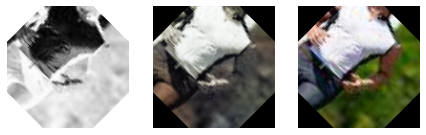

Epoch 1611 	 Loss: min = 0.002491942374035716; average = 0.003002546014613472; max = 0.0036455332301557064
Epoch 1612 	 Loss: min = 0.002440833253785968; average = 0.0031554438901366666; max = 0.004830425605177879
Epoch 1613 	 Loss: min = 0.0025363676249980927; average = 0.0030886842141626403; max = 0.0035238114651292562
Epoch 1614 	 Loss: min = 0.0024149189703166485; average = 0.0030194390565156937; max = 0.004887020215392113
Epoch 1615 	 Loss: min = 0.002289780182763934; average = 0.0028995362226851285; max = 0.0037372165825217962


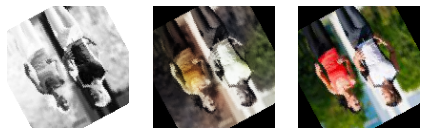

Epoch 1616 	 Loss: min = 0.0025869314558804035; average = 0.0031904393254080787; max = 0.004288021009415388
Epoch 1617 	 Loss: min = 0.0024630960542708635; average = 0.003015834648977034; max = 0.0053831483237445354
Epoch 1618 	 Loss: min = 0.0023576279636472464; average = 0.003173990422510542; max = 0.005456307902932167
Epoch 1619 	 Loss: min = 0.002669644309207797; average = 0.0030712914158357307; max = 0.0038375109434127808
Epoch 1620 	 Loss: min = 0.002586147515103221; average = 0.003116803796729073; max = 0.0043037328869104385


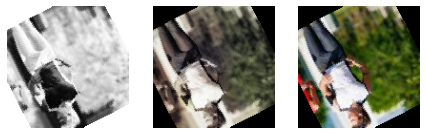

Epoch 1621 	 Loss: min = 0.002517691347748041; average = 0.0029006598342675716; max = 0.003595880698412657
Epoch 1622 	 Loss: min = 0.002411868190392852; average = 0.0028388175705913454; max = 0.003311971900984645
Epoch 1623 	 Loss: min = 0.00237120408564806; average = 0.0029469011642504483; max = 0.003810787107795477
Epoch 1624 	 Loss: min = 0.002408167812973261; average = 0.0031376655388157815; max = 0.00472269207239151
Epoch 1625 	 Loss: min = 0.0025093229487538338; average = 0.0028050527471350506; max = 0.003189530223608017


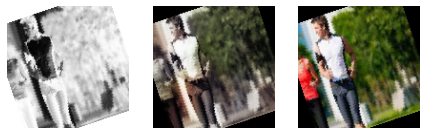

Epoch 1626 	 Loss: min = 0.0023850267753005028; average = 0.0030530992662534118; max = 0.004099477082490921
Epoch 1627 	 Loss: min = 0.002427687169983983; average = 0.0029721690953010693; max = 0.00373450736515224
Epoch 1628 	 Loss: min = 0.0026130385231226683; average = 0.0029058085492579266; max = 0.0034897159785032272
Epoch 1629 	 Loss: min = 0.0023007390554994345; average = 0.002858172287233174; max = 0.00416386965662241
Epoch 1630 	 Loss: min = 0.002469564788043499; average = 0.0030020462727406994; max = 0.0034299879334867


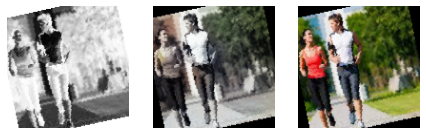

Epoch 1631 	 Loss: min = 0.002552927006036043; average = 0.002899250845075585; max = 0.0033770049922168255
Epoch 1632 	 Loss: min = 0.0024335887283086777; average = 0.0029919869848527014; max = 0.0035367696546018124
Epoch 1633 	 Loss: min = 0.0025535328313708305; average = 0.003095117484917864; max = 0.004781057126820087
Epoch 1634 	 Loss: min = 0.0025245724245905876; average = 0.0028478872845880687; max = 0.0034805089235305786
Epoch 1635 	 Loss: min = 0.0021759280934929848; average = 0.0028425836499081925; max = 0.0034011825919151306


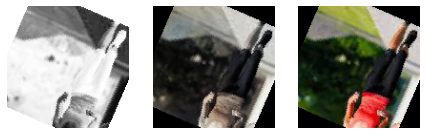

Epoch 1636 	 Loss: min = 0.002178100636228919; average = 0.002843479160219431; max = 0.0039082965813577175
Epoch 1637 	 Loss: min = 0.002579048275947571; average = 0.002985442682984285; max = 0.003849409520626068
Epoch 1638 	 Loss: min = 0.00250539043918252; average = 0.002915157485404052; max = 0.0035851341672241688
Epoch 1639 	 Loss: min = 0.002358577214181423; average = 0.0029455943731591105; max = 0.0035342867486178875
Epoch 1640 	 Loss: min = 0.0023509690072387457; average = 0.0028828342765336856; max = 0.0034613392781466246


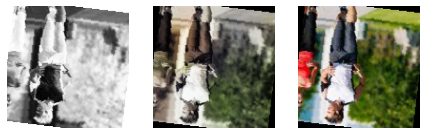

Epoch 1641 	 Loss: min = 0.0023550731129944324; average = 0.0029281369352247566; max = 0.003687618300318718
Epoch 1642 	 Loss: min = 0.0025070998817682266; average = 0.0028751022764481604; max = 0.003248470602557063
Epoch 1643 	 Loss: min = 0.002346141031011939; average = 0.0029047740827081725; max = 0.0036733211018145084
Epoch 1644 	 Loss: min = 0.00230140658095479; average = 0.0029078376246616244; max = 0.003268270520493388
Epoch 1645 	 Loss: min = 0.0023590312339365482; average = 0.0030285272368928418; max = 0.004429108928889036


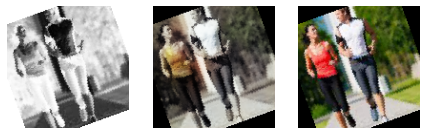

Epoch 1646 	 Loss: min = 0.002582029439508915; average = 0.0030084870086284354; max = 0.004323513712733984
Epoch 1647 	 Loss: min = 0.00247980747371912; average = 0.0030618452874477953; max = 0.004817070905119181
Epoch 1648 	 Loss: min = 0.0024524133186787367; average = 0.0030069019267102703; max = 0.004160818178206682
Epoch 1649 	 Loss: min = 0.00242814514786005; average = 0.0030287051777122542; max = 0.00453375605866313
Epoch 1650 	 Loss: min = 0.002400735393166542; average = 0.003061865718336776; max = 0.004184503573924303


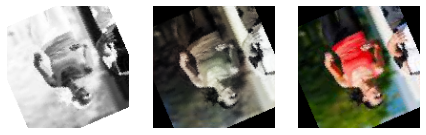

Epoch 1651 	 Loss: min = 0.002484171884134412; average = 0.0028999836795264855; max = 0.0033618342131376266
Epoch 1652 	 Loss: min = 0.0023847706615924835; average = 0.0029964209388708696; max = 0.00428201025351882
Epoch 1653 	 Loss: min = 0.002468713326379657; average = 0.0029056778585072607; max = 0.003573467954993248
Epoch 1654 	 Loss: min = 0.0023891846649348736; average = 0.0029047853749943897; max = 0.003988857846707106
Epoch 1655 	 Loss: min = 0.002398828975856304; average = 0.003040790485101752; max = 0.0039780340157449245


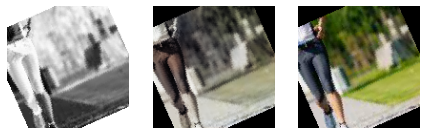

Epoch 1656 	 Loss: min = 0.002314796671271324; average = 0.0029786215745843947; max = 0.0036421790719032288
Epoch 1657 	 Loss: min = 0.0023035560734570026; average = 0.0028958440088899806; max = 0.004141516983509064
Epoch 1658 	 Loss: min = 0.002136299852281809; average = 0.002887707349145785; max = 0.0033575668931007385
Epoch 1659 	 Loss: min = 0.0025320276618003845; average = 0.0028370652289595455; max = 0.003149573225528002
Epoch 1660 	 Loss: min = 0.0022973136510699987; average = 0.002827691816492006; max = 0.003470129333436489


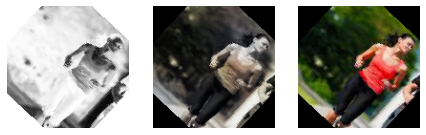

Epoch 1661 	 Loss: min = 0.0023514251224696636; average = 0.0027527799684321508; max = 0.003442725632339716
Epoch 1662 	 Loss: min = 0.0021533172111958265; average = 0.0028291705675655976; max = 0.0035669729113578796
Epoch 1663 	 Loss: min = 0.002374481875449419; average = 0.002848738426109776; max = 0.0035103983245790005
Epoch 1664 	 Loss: min = 0.002397791249677539; average = 0.002899239887483418; max = 0.003810068592429161
Epoch 1665 	 Loss: min = 0.0024833246134221554; average = 0.0031579227943439037; max = 0.004282211419194937


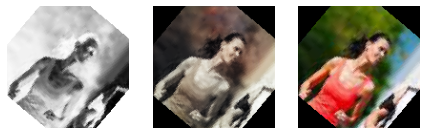

Epoch 1666 	 Loss: min = 0.0024601398035883904; average = 0.0028888105880469084; max = 0.003319988027215004
Epoch 1667 	 Loss: min = 0.0024956665001809597; average = 0.0029706179484492168; max = 0.003379330039024353
Epoch 1668 	 Loss: min = 0.0024786910507827997; average = 0.0028823902102885768; max = 0.003417909611016512
Epoch 1669 	 Loss: min = 0.002359474776312709; average = 0.00279992469586432; max = 0.003229155670851469
Epoch 1670 	 Loss: min = 0.0023551248013973236; average = 0.0028323557635303587; max = 0.003846351522952318


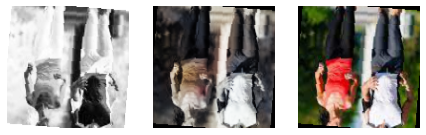

Epoch 1671 	 Loss: min = 0.0023980909027159214; average = 0.002941143495263532; max = 0.005209681577980518
Epoch 1672 	 Loss: min = 0.0023354238364845514; average = 0.0030048845073906705; max = 0.0037086184602230787
Epoch 1673 	 Loss: min = 0.002209432888776064; average = 0.0028857076686108485; max = 0.004261324182152748
Epoch 1674 	 Loss: min = 0.0023895036429166794; average = 0.0028446936630643904; max = 0.0034848477225750685
Epoch 1675 	 Loss: min = 0.002319994382560253; average = 0.0028147660341346636; max = 0.0032725073397159576


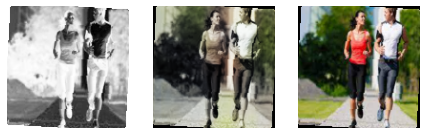

Epoch 1676 	 Loss: min = 0.0023207261692732573; average = 0.0028141405491624027; max = 0.003199991537258029
Epoch 1677 	 Loss: min = 0.002378682140260935; average = 0.002840075991116464; max = 0.003489387920126319
Epoch 1678 	 Loss: min = 0.002471364103257656; average = 0.0027906836330657825; max = 0.0031781650613993406
Epoch 1679 	 Loss: min = 0.0023890933953225613; average = 0.0028305017185630277; max = 0.004713991656899452
Epoch 1680 	 Loss: min = 0.0024535642005503178; average = 0.0029207932529971004; max = 0.0036170415114611387


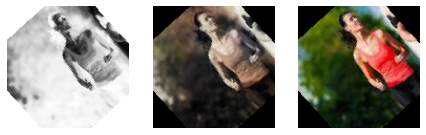

Epoch 1681 	 Loss: min = 0.0023169456981122494; average = 0.0027564605697989464; max = 0.0034823839087039232
Epoch 1682 	 Loss: min = 0.0025344158057123423; average = 0.0029774165159324184; max = 0.0036467979662120342
Epoch 1683 	 Loss: min = 0.0022479596082121134; average = 0.002799441499519162; max = 0.0031511324923485518
Epoch 1684 	 Loss: min = 0.0022538278717547655; average = 0.0027497338160173967; max = 0.0031914254650473595
Epoch 1685 	 Loss: min = 0.00243533868342638; average = 0.0028601286467164755; max = 0.003741423599421978


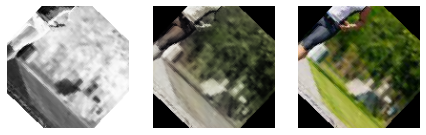

Epoch 1686 	 Loss: min = 0.002310468815267086; average = 0.0027426265442045406; max = 0.003256091382354498
Epoch 1687 	 Loss: min = 0.0021046302281320095; average = 0.0027934292738791555; max = 0.003230105619877577
Epoch 1688 	 Loss: min = 0.002216511406004429; average = 0.0029018132481724024; max = 0.004247123375535011
Epoch 1689 	 Loss: min = 0.002234733197838068; average = 0.0030155107233440503; max = 0.0048156557604670525
Epoch 1690 	 Loss: min = 0.0024746558628976345; average = 0.003004975165822543; max = 0.003943498712033033


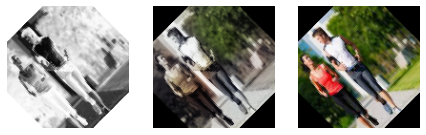

Epoch 1691 	 Loss: min = 0.0023759989999234676; average = 0.002880124418879859; max = 0.0035148835740983486
Epoch 1692 	 Loss: min = 0.0024351002648472786; average = 0.0028123481024522334; max = 0.0033252618741244078
Epoch 1693 	 Loss: min = 0.002071729861199856; average = 0.0028531671850942075; max = 0.00355888856574893
Epoch 1694 	 Loss: min = 0.00235294783487916; average = 0.0028179613582324237; max = 0.0032550753094255924
Epoch 1695 	 Loss: min = 0.002391570247709751; average = 0.0028158097848063335; max = 0.00332848122343421


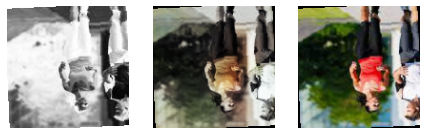

Epoch 1696 	 Loss: min = 0.002156119793653488; average = 0.0028007036744384095; max = 0.003986968193203211
Epoch 1697 	 Loss: min = 0.0025537977926433086; average = 0.003041154210222885; max = 0.00386390695348382
Epoch 1698 	 Loss: min = 0.002581753535196185; average = 0.002992326728417538; max = 0.0035046464763581753
Epoch 1699 	 Loss: min = 0.002494917716830969; average = 0.0027697851037373766; max = 0.0033284174278378487
Epoch 1700 	 Loss: min = 0.002481251722201705; average = 0.0028454266721382737; max = 0.0033923531882464886


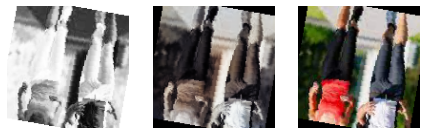

Epoch 1701 	 Loss: min = 0.00243580574169755; average = 0.002938769874162972; max = 0.0037252637557685375
Epoch 1702 	 Loss: min = 0.0021758899092674255; average = 0.0028932892018929124; max = 0.0035360190086066723
Epoch 1703 	 Loss: min = 0.0025221402756869793; average = 0.003008155501447618; max = 0.0037847773637622595
Epoch 1704 	 Loss: min = 0.002262333407998085; average = 0.0028660144744208083; max = 0.00407497538253665
Epoch 1705 	 Loss: min = 0.0024724153336137533; average = 0.002952761817141436; max = 0.0038577034138143063


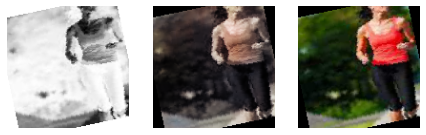

Epoch 1706 	 Loss: min = 0.0023514442145824432; average = 0.00287540077988524; max = 0.0038380492478609085
Epoch 1707 	 Loss: min = 0.002349084708839655; average = 0.002856514125596732; max = 0.003620601026341319
Epoch 1708 	 Loss: min = 0.0022068386897444725; average = 0.0026661583106033504; max = 0.0029437998309731483
Epoch 1709 	 Loss: min = 0.0023872056044638157; average = 0.002925996348494664; max = 0.0035968394950032234
Epoch 1710 	 Loss: min = 0.0022839258890599012; average = 0.0028980823699384928; max = 0.0042340634390711784


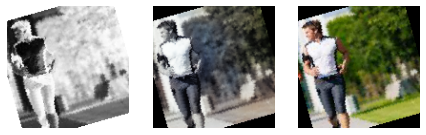

Epoch 1711 	 Loss: min = 0.0025093876756727695; average = 0.0028929743129992858; max = 0.00335653661750257
Epoch 1712 	 Loss: min = 0.002385320607572794; average = 0.0028392330132192; max = 0.003941154107451439
Epoch 1713 	 Loss: min = 0.0021167462691664696; average = 0.00283524880069308; max = 0.003497358178719878
Epoch 1714 	 Loss: min = 0.002248502103611827; average = 0.002806809716275893; max = 0.003599599003791809
Epoch 1715 	 Loss: min = 0.002492923755198717; average = 0.0029731390241067857; max = 0.0036153867840766907


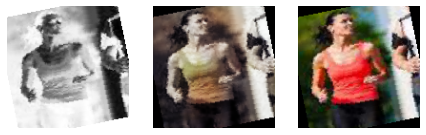

Epoch 1716 	 Loss: min = 0.0024510712828487158; average = 0.0028307183674769476; max = 0.003367215860635042
Epoch 1717 	 Loss: min = 0.002335539786145091; average = 0.0027849469042848796; max = 0.0032101902179419994
Epoch 1718 	 Loss: min = 0.0022815405391156673; average = 0.0027843290445161983; max = 0.00355733884498477
Epoch 1719 	 Loss: min = 0.002317887730896473; average = 0.0029325783834792674; max = 0.003625859273597598
Epoch 1720 	 Loss: min = 0.0024221488274633884; average = 0.002952045004349202; max = 0.003516863565891981


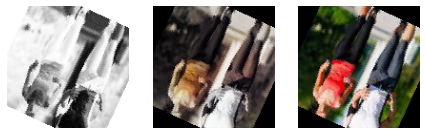

Epoch 1721 	 Loss: min = 0.0023201587609946728; average = 0.002944611944258213; max = 0.003996315412223339
Epoch 1722 	 Loss: min = 0.0025449590757489204; average = 0.003043700475245714; max = 0.004147757776081562
Epoch 1723 	 Loss: min = 0.00249239569529891; average = 0.0030084810277912766; max = 0.004005216993391514
Epoch 1724 	 Loss: min = 0.0023909921292215586; average = 0.002951881804619916; max = 0.00384876923635602
Epoch 1725 	 Loss: min = 0.002441531978547573; average = 0.0027853348292410374; max = 0.003615390509366989


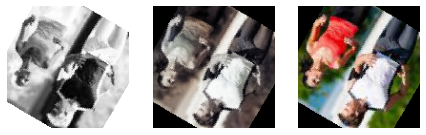

Epoch 1726 	 Loss: min = 0.002255468862131238; average = 0.0026802405627677217; max = 0.003325809258967638
Epoch 1727 	 Loss: min = 0.0024900902062654495; average = 0.0028015187999699265; max = 0.0031008049845695496
Epoch 1728 	 Loss: min = 0.0022346987389028072; average = 0.0028303112922003493; max = 0.0035955067723989487
Epoch 1729 	 Loss: min = 0.002228445839136839; average = 0.002747173246461898; max = 0.0032750554382801056
Epoch 1730 	 Loss: min = 0.0023693491239100695; average = 0.002740618758252822; max = 0.0030907061882317066


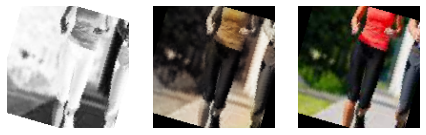

Epoch 1731 	 Loss: min = 0.002333252225071192; average = 0.0028263791027711704; max = 0.003589862957596779
Epoch 1732 	 Loss: min = 0.002529791323468089; average = 0.002782701820251532; max = 0.003387643024325371
Epoch 1733 	 Loss: min = 0.002367581706494093; average = 0.0028815385012421757; max = 0.0038501881062984467
Epoch 1734 	 Loss: min = 0.0023064666893333197; average = 0.002734521040110849; max = 0.003061387687921524
Epoch 1735 	 Loss: min = 0.002453054767102003; average = 0.0028759384294971824; max = 0.003808259032666683


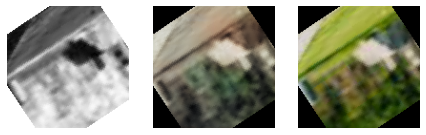

Epoch 1736 	 Loss: min = 0.0022866185754537582; average = 0.0027787944563897327; max = 0.0032019871287047863
Epoch 1737 	 Loss: min = 0.00215804111212492; average = 0.002974121438455768; max = 0.0040563857182860374
Epoch 1738 	 Loss: min = 0.0025973396841436625; average = 0.0031758345721755177; max = 0.0047665806487202644
Epoch 1739 	 Loss: min = 0.002431511878967285; average = 0.0031531682034255937; max = 0.004555970896035433
Epoch 1740 	 Loss: min = 0.002435800153762102; average = 0.002939173296908848; max = 0.0038242998998612165


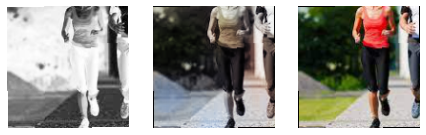

Epoch 1741 	 Loss: min = 0.0025765616446733475; average = 0.0030394985078601167; max = 0.004266850184649229
Epoch 1742 	 Loss: min = 0.0023912859614938498; average = 0.002884552231989801; max = 0.0039441813714802265
Epoch 1743 	 Loss: min = 0.0021756072528660297; average = 0.002740364652709104; max = 0.0035162835847586393
Epoch 1744 	 Loss: min = 0.00241677975282073; average = 0.002987504078191705; max = 0.004103740211576223
Epoch 1745 	 Loss: min = 0.0024571064859628677; average = 0.002819149027345702; max = 0.003300079610198736


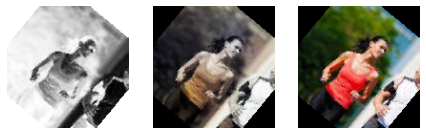

Epoch 1746 	 Loss: min = 0.0023428089916706085; average = 0.0027992023387923837; max = 0.003614444751292467
Epoch 1747 	 Loss: min = 0.0021469788625836372; average = 0.002806160264299251; max = 0.003355539869517088
Epoch 1748 	 Loss: min = 0.0025026043877005577; average = 0.0029619963752338663; max = 0.004180278163403273
Epoch 1749 	 Loss: min = 0.002380343386903405; average = 0.002956037860712968; max = 0.003921982832252979
Epoch 1750 	 Loss: min = 0.0023772125132381916; average = 0.0028696322406176478; max = 0.0037998612970113754


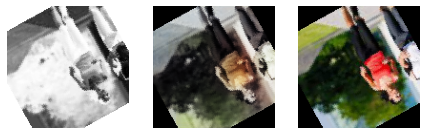

Epoch 1751 	 Loss: min = 0.0025158210191875696; average = 0.0028084625664632767; max = 0.0031091677956283092
Epoch 1752 	 Loss: min = 0.0023818432819098234; average = 0.0028222217079019174; max = 0.003788929432630539
Epoch 1753 	 Loss: min = 0.0024573353584855795; average = 0.002888185772462748; max = 0.003352425992488861
Epoch 1754 	 Loss: min = 0.0024101065937429667; average = 0.0028373748355079442; max = 0.003382942406460643
Epoch 1755 	 Loss: min = 0.002301338594406843; average = 0.002836210172972642; max = 0.0035225492902100086


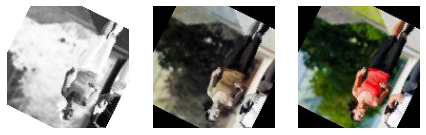

Epoch 1756 	 Loss: min = 0.002405458362773061; average = 0.0028020215540891513; max = 0.0033629131503403187
Epoch 1757 	 Loss: min = 0.0024545821361243725; average = 0.0027362957771401852; max = 0.0030088338535279036
Epoch 1758 	 Loss: min = 0.0023806262761354446; average = 0.0027473728550830856; max = 0.003711964702233672
Epoch 1759 	 Loss: min = 0.002379030454903841; average = 0.002936439763288945; max = 0.00378965912386775
Epoch 1760 	 Loss: min = 0.002414788119494915; average = 0.002833511374774389; max = 0.0034027020446956158


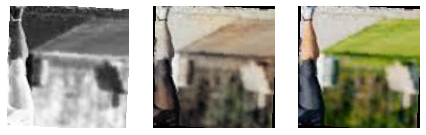

Epoch 1761 	 Loss: min = 0.002451119013130665; average = 0.002850683100405149; max = 0.003390856087207794
Epoch 1762 	 Loss: min = 0.002215973101556301; average = 0.0027220391057198867; max = 0.003302872646600008
Epoch 1763 	 Loss: min = 0.002323469612747431; average = 0.0028437700239010155; max = 0.00372408889234066
Epoch 1764 	 Loss: min = 0.0022083818912506104; average = 0.0027268902922514826; max = 0.0035823339130729437
Epoch 1765 	 Loss: min = 0.002398091135546565; average = 0.0027794174384325743; max = 0.0034588153939694166


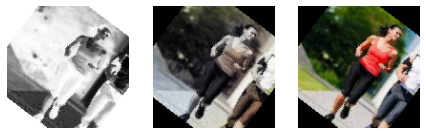

Epoch 1766 	 Loss: min = 0.0021914539393037558; average = 0.0027521245210664347; max = 0.0033352046739310026
Epoch 1767 	 Loss: min = 0.0021773658227175474; average = 0.002733462199103087; max = 0.0030430196784436703
Epoch 1768 	 Loss: min = 0.002446085913106799; average = 0.002932405986939557; max = 0.004053906537592411
Epoch 1769 	 Loss: min = 0.002365803113207221; average = 0.0030167634249664843; max = 0.003677750937640667
Epoch 1770 	 Loss: min = 0.0021831365302205086; average = 0.002833464735886082; max = 0.0037197850178927183


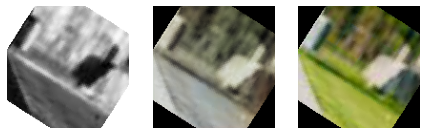

Epoch 1771 	 Loss: min = 0.0022312167566269636; average = 0.002885810870793648; max = 0.0037576104514300823
Epoch 1772 	 Loss: min = 0.002272074343636632; average = 0.002702621932257898; max = 0.0031655177008360624
Epoch 1773 	 Loss: min = 0.002289740601554513; average = 0.002810037578456104; max = 0.0037613813765347004
Epoch 1774 	 Loss: min = 0.0022519822232425213; average = 0.0027791415923275054; max = 0.0036697625182569027
Epoch 1775 	 Loss: min = 0.002367807785049081; average = 0.002751207764958963; max = 0.0033566318452358246


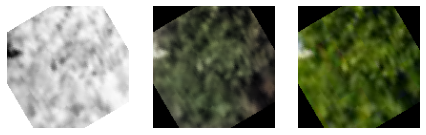

Epoch 1776 	 Loss: min = 0.0023365546949207783; average = 0.0027578098088270053; max = 0.003609962295740843
Epoch 1777 	 Loss: min = 0.0021779509261250496; average = 0.002871566219255328; max = 0.003973016515374184
Epoch 1778 	 Loss: min = 0.002210881095379591; average = 0.0027055866521550342; max = 0.0037155281752347946
Epoch 1779 	 Loss: min = 0.002451264066621661; average = 0.0027448302134871483; max = 0.003122946247458458
Epoch 1780 	 Loss: min = 0.002004899550229311; average = 0.0026585380837786943; max = 0.003411637619137764


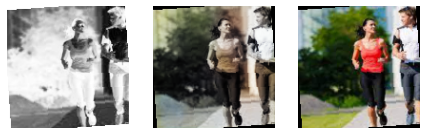

Epoch 1781 	 Loss: min = 0.0022672927007079124; average = 0.0027950105868512765; max = 0.0034054999705404043
Epoch 1782 	 Loss: min = 0.0023706667125225067; average = 0.0026924834528472275; max = 0.003082569222897291
Epoch 1783 	 Loss: min = 0.002423847559839487; average = 0.0029321431211428717; max = 0.003907383885234594
Epoch 1784 	 Loss: min = 0.0023198274429887533; average = 0.0028827927890233696; max = 0.003801693208515644
Epoch 1785 	 Loss: min = 0.0021364192944020033; average = 0.0027382587431930006; max = 0.003471044357866049


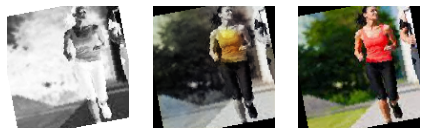

Epoch 1786 	 Loss: min = 0.002185417804867029; average = 0.0027491423388710245; max = 0.003288914216682315
Epoch 1787 	 Loss: min = 0.0023277662694454193; average = 0.002770074817817658; max = 0.0041007231920957565
Epoch 1788 	 Loss: min = 0.002481586067005992; average = 0.002937706740340218; max = 0.0034017518628388643
Epoch 1789 	 Loss: min = 0.00237222365103662; average = 0.0027469538035802543; max = 0.0032989508472383022
Epoch 1790 	 Loss: min = 0.002371513983234763; average = 0.0028138206544099376; max = 0.00378924747928977


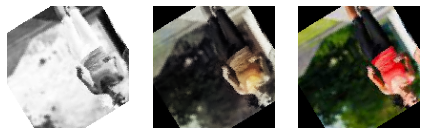

Epoch 1791 	 Loss: min = 0.002787287812680006; average = 0.00334886068594642; max = 0.005307530518621206
Epoch 1792 	 Loss: min = 0.002389737172052264; average = 0.002964276951388456; max = 0.0037748082540929317
Epoch 1793 	 Loss: min = 0.002467191545292735; average = 0.0030561877065338194; max = 0.0038328240625560284
Epoch 1794 	 Loss: min = 0.0023266971111297607; average = 0.0030270136485341936; max = 0.003719931235536933
Epoch 1795 	 Loss: min = 0.0022891820408403873; average = 0.0028602817765204236; max = 0.0036374356132000685


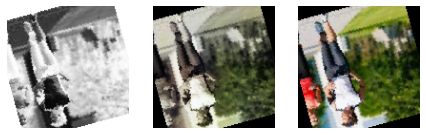

Epoch 1796 	 Loss: min = 0.0022329657804220915; average = 0.002915008706622757; max = 0.003656795946881175
Epoch 1797 	 Loss: min = 0.0022988058626651764; average = 0.002834806015016511; max = 0.0035136635415256023
Epoch 1798 	 Loss: min = 0.0023524537682533264; average = 0.002917720135883428; max = 0.004024098161607981
Epoch 1799 	 Loss: min = 0.002412146423012018; average = 0.002826047202688642; max = 0.0035264971666038036
Epoch 1800 	 Loss: min = 0.0023452946916222572; average = 0.002668171000550501; max = 0.0030096913687884808


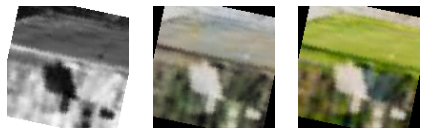

Epoch 1801 	 Loss: min = 0.002410412533208728; average = 0.002845037917722948; max = 0.0038172262720763683
Epoch 1802 	 Loss: min = 0.002161797834560275; average = 0.002872866331017576; max = 0.003885135054588318
Epoch 1803 	 Loss: min = 0.002288305200636387; average = 0.002823791845003143; max = 0.0038665819447487593
Epoch 1804 	 Loss: min = 0.0024527674540877342; average = 0.0029933028999948874; max = 0.0048719425685703754
Epoch 1805 	 Loss: min = 0.002517763525247574; average = 0.002894534118240699; max = 0.003689588513225317


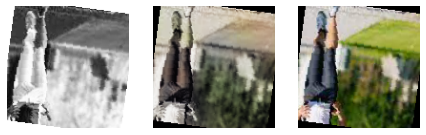

Epoch 1806 	 Loss: min = 0.0022001718170940876; average = 0.0030396489310078323; max = 0.00403019180521369
Epoch 1807 	 Loss: min = 0.002269631950184703; average = 0.002793154591927305; max = 0.0031596384942531586
Epoch 1808 	 Loss: min = 0.002265537390485406; average = 0.002825887262588367; max = 0.003724295413121581
Epoch 1809 	 Loss: min = 0.002176383975893259; average = 0.002766230682027526; max = 0.0033180757891386747
Epoch 1810 	 Loss: min = 0.00244776695035398; average = 0.0027995957352686673; max = 0.0032812475692480803


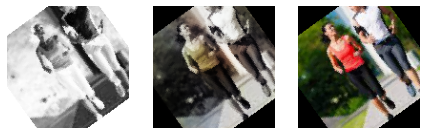

Epoch 1811 	 Loss: min = 0.0023481789976358414; average = 0.0029978228703839704; max = 0.003762863576412201
Epoch 1812 	 Loss: min = 0.0023025767877697945; average = 0.0027879906847374514; max = 0.0033439563121646643
Epoch 1813 	 Loss: min = 0.0022017029114067554; average = 0.0027675968885887414; max = 0.003558953059837222
Epoch 1814 	 Loss: min = 0.0022484012879431248; average = 0.0027726318658096716; max = 0.0037926367949694395
Epoch 1815 	 Loss: min = 0.0022769097704440355; average = 0.002827395321219228; max = 0.0036193865817040205


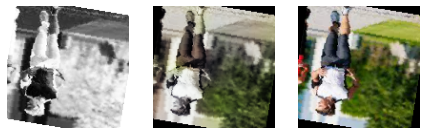

Epoch 1816 	 Loss: min = 0.0022179174702614546; average = 0.002763506694464013; max = 0.004077908582985401
Epoch 1817 	 Loss: min = 0.0023765861988067627; average = 0.002776428678771481; max = 0.003539418336004019
Epoch 1818 	 Loss: min = 0.0022455998696386814; average = 0.002704734040889889; max = 0.0034715801011770964
Epoch 1819 	 Loss: min = 0.0021836902014911175; average = 0.0027921582077397034; max = 0.003913300111889839
Epoch 1820 	 Loss: min = 0.0022708543110638857; average = 0.0027205385704291984; max = 0.0032215730752795935


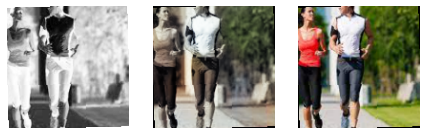

Epoch 1821 	 Loss: min = 0.0021953897085040808; average = 0.002805612195516005; max = 0.0036779604852199554
Epoch 1822 	 Loss: min = 0.0022938584443181753; average = 0.0027589730016188696; max = 0.0031121743377298117
Epoch 1823 	 Loss: min = 0.0023512085899710655; average = 0.002850263423169963; max = 0.0036069201305508614
Epoch 1824 	 Loss: min = 0.002124146092683077; average = 0.002781112867523916; max = 0.0035221544094383717
Epoch 1825 	 Loss: min = 0.002247156808152795; average = 0.002842066387529485; max = 0.003786292625591159


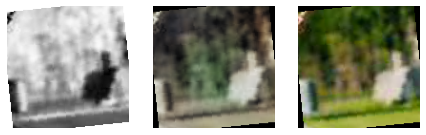

Epoch 1826 	 Loss: min = 0.0022332172375172377; average = 0.002660845886566676; max = 0.0031492665875703096
Epoch 1827 	 Loss: min = 0.002242120448499918; average = 0.0027512069063959643; max = 0.004171657841652632
Epoch 1828 	 Loss: min = 0.002142148558050394; average = 0.002636398625327274; max = 0.0032939526718109846
Epoch 1829 	 Loss: min = 0.0022330484353005886; average = 0.002581878303317353; max = 0.003007876453921199
Epoch 1830 	 Loss: min = 0.0022371686063706875; average = 0.0029074330668663606; max = 0.003962396644055843


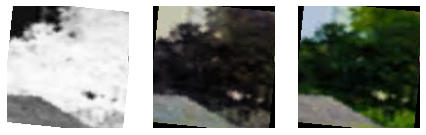

Epoch 1831 	 Loss: min = 0.0022785840556025505; average = 0.002761371710221283; max = 0.0036005661822855473
Epoch 1832 	 Loss: min = 0.0021865933667868376; average = 0.0026816048921318725; max = 0.003062383970245719
Epoch 1833 	 Loss: min = 0.0024164749775081873; average = 0.00279431720264256; max = 0.003391064703464508
Epoch 1834 	 Loss: min = 0.00250946800224483; average = 0.0028417126304702833; max = 0.0038284710608422756
Epoch 1835 	 Loss: min = 0.0021086521446704865; average = 0.0028081748314434662; max = 0.0036067122127860785


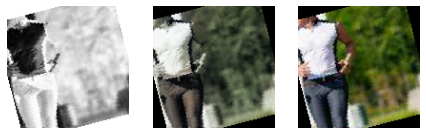

Epoch 1836 	 Loss: min = 0.002150994259864092; average = 0.0027155235584359616; max = 0.0034534733276814222
Epoch 1837 	 Loss: min = 0.002349416259676218; average = 0.002720088552450761; max = 0.0034917513839900494
Epoch 1838 	 Loss: min = 0.0023734583519399166; average = 0.00266247391118668; max = 0.003071945859119296
Epoch 1839 	 Loss: min = 0.002216150751337409; average = 0.002648399822646752; max = 0.0032130812760442495
Epoch 1840 	 Loss: min = 0.0023743691854178905; average = 0.002758228962193243; max = 0.0032563842833042145


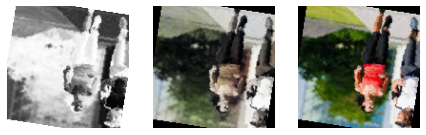

Epoch 1841 	 Loss: min = 0.0022456313017755747; average = 0.0026518850499996915; max = 0.003055759472772479
Epoch 1842 	 Loss: min = 0.0022277964744716883; average = 0.002631999523146078; max = 0.0032459083013236523
Epoch 1843 	 Loss: min = 0.002300872001796961; average = 0.0026983901916537434; max = 0.003879128722473979
Epoch 1844 	 Loss: min = 0.002301681786775589; average = 0.0027724420797312632; max = 0.003242767881602049
Epoch 1845 	 Loss: min = 0.0023660403676331043; average = 0.0027647259121295065; max = 0.003241904778406024


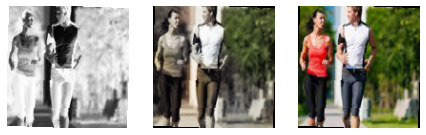

Epoch 1846 	 Loss: min = 0.002317612525075674; average = 0.002922021914855577; max = 0.004085882101207972
Epoch 1847 	 Loss: min = 0.002367741195484996; average = 0.0027734363975469023; max = 0.0033206313382834196
Epoch 1848 	 Loss: min = 0.002627717796713114; average = 0.0031771511276019737; max = 0.004161718767136335
Epoch 1849 	 Loss: min = 0.0023917388170957565; average = 0.002904738299548626; max = 0.0035547036677598953
Epoch 1850 	 Loss: min = 0.0023487000726163387; average = 0.002909031347371638; max = 0.0038135310169309378


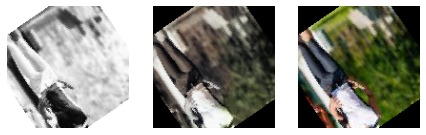

Epoch 1851 	 Loss: min = 0.002260053064674139; average = 0.002756923422566615; max = 0.004075928591191769
Epoch 1852 	 Loss: min = 0.002233053557574749; average = 0.0028170423465780914; max = 0.003255705814808607
Epoch 1853 	 Loss: min = 0.0022956051398068666; average = 0.0027099391154479235; max = 0.0030965167097747326
Epoch 1854 	 Loss: min = 0.0021829786710441113; average = 0.0028091226558899507; max = 0.0034104501828551292
Epoch 1855 	 Loss: min = 0.0021767716389149427; average = 0.002675673007615842; max = 0.003182323183864355


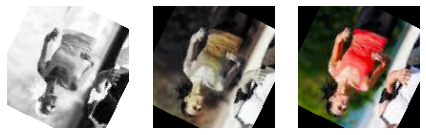

Epoch 1856 	 Loss: min = 0.0023509208112955093; average = 0.002755531619186513; max = 0.00326211703941226
Epoch 1857 	 Loss: min = 0.0022084403317421675; average = 0.0026564258587313816; max = 0.0032891673035919666
Epoch 1858 	 Loss: min = 0.002389678033068776; average = 0.0029623677110066637; max = 0.005376475863158703
Epoch 1859 	 Loss: min = 0.0023206097539514303; average = 0.002844742455636151; max = 0.00356621528044343
Epoch 1860 	 Loss: min = 0.002131368964910507; average = 0.002748348910245113; max = 0.003915004897862673


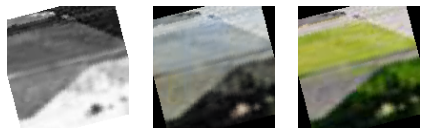

Epoch 1861 	 Loss: min = 0.0020673051476478577; average = 0.00273463963821996; max = 0.003501456929370761
Epoch 1862 	 Loss: min = 0.0023193133529275656; average = 0.0026683432515710592; max = 0.0029883168172091246
Epoch 1863 	 Loss: min = 0.0023834765888750553; average = 0.0028142175870016217; max = 0.003711763769388199
Epoch 1864 	 Loss: min = 0.002393234521150589; average = 0.0027286669210297987; max = 0.003839287906885147
Epoch 1865 	 Loss: min = 0.0022119570057839155; average = 0.0026419593777973205; max = 0.003306846832856536


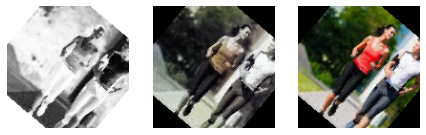

Epoch 1866 	 Loss: min = 0.002251510275527835; average = 0.002746267302427441; max = 0.003349532838910818
Epoch 1867 	 Loss: min = 0.0023073358461260796; average = 0.002702953774132766; max = 0.003386933356523514
Epoch 1868 	 Loss: min = 0.002275684615597129; average = 0.0026719461602624506; max = 0.003286301624029875
Epoch 1869 	 Loss: min = 0.0022930626291781664; average = 0.002726412654737942; max = 0.003246044274419546
Epoch 1870 	 Loss: min = 0.0023426187690347433; average = 0.0028527839749585837; max = 0.003510100534185767


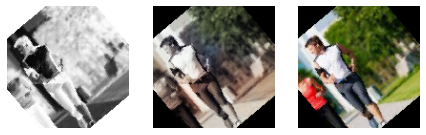

Epoch 1871 	 Loss: min = 0.0022545834071934223; average = 0.0026973598287440836; max = 0.0032167243771255016
Epoch 1872 	 Loss: min = 0.0021153497509658337; average = 0.002672022703336552; max = 0.0032616888638585806
Epoch 1873 	 Loss: min = 0.0023543969728052616; average = 0.0028414420085027814; max = 0.0038119310047477484
Epoch 1874 	 Loss: min = 0.002328220522031188; average = 0.0027840385300805792; max = 0.004196925088763237
Epoch 1875 	 Loss: min = 0.0022001012694090605; average = 0.002738716240855865; max = 0.0030880426056683064


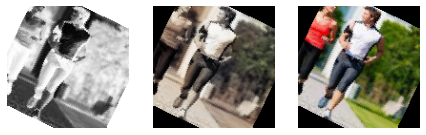

Epoch 1876 	 Loss: min = 0.0022398296277970076; average = 0.002719439013162628; max = 0.003391617676243186
Epoch 1877 	 Loss: min = 0.0021770750172436237; average = 0.002801897731842473; max = 0.004145090468227863
Epoch 1878 	 Loss: min = 0.0021313056349754333; average = 0.0028364566969685256; max = 0.003677351400256157
Epoch 1879 	 Loss: min = 0.0022727572359144688; average = 0.002752130720182322; max = 0.0036965522449463606
Epoch 1880 	 Loss: min = 0.0025184396654367447; average = 0.0032014199096011; max = 0.004789877217262983


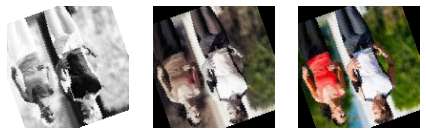

Epoch 1881 	 Loss: min = 0.0023158248513936996; average = 0.002968411994515918; max = 0.004031646065413952
Epoch 1882 	 Loss: min = 0.002277594758197665; average = 0.002812896913383156; max = 0.003685455769300461
Epoch 1883 	 Loss: min = 0.0023289613891392946; average = 0.0028716688830172643; max = 0.004405002109706402
Epoch 1884 	 Loss: min = 0.0021276248153299093; average = 0.002740477619227022; max = 0.0037174196913838387
Epoch 1885 	 Loss: min = 0.0022112238220870495; average = 0.002798162371618673; max = 0.0033536083064973354


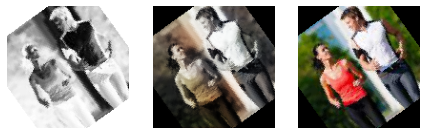

Epoch 1886 	 Loss: min = 0.002230147598311305; average = 0.002608826762298122; max = 0.0028244364075362682
Epoch 1887 	 Loss: min = 0.002046743407845497; average = 0.002817459579091519; max = 0.0036065150052309036
Epoch 1888 	 Loss: min = 0.0023063381668180227; average = 0.002685192841454409; max = 0.003240184858441353
Epoch 1889 	 Loss: min = 0.002318054437637329; average = 0.002720946751651354; max = 0.0033967928029596806
Epoch 1890 	 Loss: min = 0.0022757169790565968; average = 0.002817444154061377; max = 0.003853464499115944


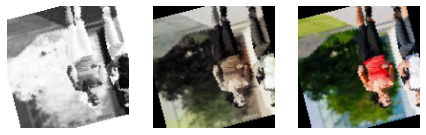

Epoch 1891 	 Loss: min = 0.0022743435110896826; average = 0.0028101144853280857; max = 0.0033129153307527304
Epoch 1892 	 Loss: min = 0.0019462620839476585; average = 0.0026597634569043294; max = 0.003251221962273121
Epoch 1893 	 Loss: min = 0.0022716261446475983; average = 0.0026974260254064575; max = 0.0031782169826328754
Epoch 1894 	 Loss: min = 0.0023087270092219114; average = 0.002776777037070133; max = 0.003398273838683963
Epoch 1895 	 Loss: min = 0.0024119364097714424; average = 0.0027795099740615115; max = 0.0034617739729583263


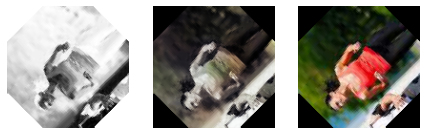

Epoch 1896 	 Loss: min = 0.002154015935957432; average = 0.0026277306606061757; max = 0.0030752765014767647
Epoch 1897 	 Loss: min = 0.0020545325241982937; average = 0.0026616709656082094; max = 0.003388200653716922
Epoch 1898 	 Loss: min = 0.0020914997439831495; average = 0.0026397681212984025; max = 0.0032949429005384445
Epoch 1899 	 Loss: min = 0.0022173840552568436; average = 0.00259290992107708; max = 0.002904947381466627
Epoch 1900 	 Loss: min = 0.0022968281991779804; average = 0.0026995815278496593; max = 0.0033889575861394405


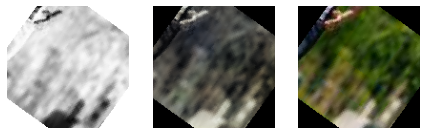

Epoch 1901 	 Loss: min = 0.0023798474576324224; average = 0.00276157891494222; max = 0.0034623383544385433
Epoch 1902 	 Loss: min = 0.002304034074768424; average = 0.0029646476032212377; max = 0.004312062636017799
Epoch 1903 	 Loss: min = 0.0023497631773352623; average = 0.0029246505291666836; max = 0.003647846868261695
Epoch 1904 	 Loss: min = 0.0022823296021670103; average = 0.002816811000229791; max = 0.0033843256533145905
Epoch 1905 	 Loss: min = 0.0022450508549809456; average = 0.0026007312699221075; max = 0.003139025066047907


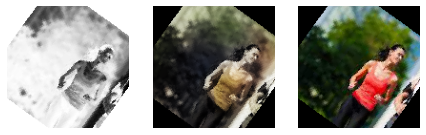

Epoch 1906 	 Loss: min = 0.00244745216332376; average = 0.00269148891675286; max = 0.0029972949996590614
Epoch 1907 	 Loss: min = 0.001925923046655953; average = 0.002675180548976641; max = 0.0029705516062676907
Epoch 1908 	 Loss: min = 0.002344917505979538; average = 0.00271935154160019; max = 0.0031627658754587173
Epoch 1909 	 Loss: min = 0.0023246905766427517; average = 0.0027442665450507775; max = 0.0033453763462603092
Epoch 1910 	 Loss: min = 0.0022521528881043196; average = 0.0028190443117637187; max = 0.003806376364082098


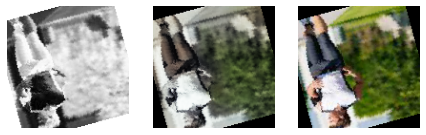

Epoch 1911 	 Loss: min = 0.0021988395601511; average = 0.0026822146610356867; max = 0.0036574117839336395
Epoch 1912 	 Loss: min = 0.00231074052862823; average = 0.0027188470849068835; max = 0.0035489541478455067
Epoch 1913 	 Loss: min = 0.002270839177072048; average = 0.0026795451558427885; max = 0.003224968910217285
Epoch 1914 	 Loss: min = 0.002280038082972169; average = 0.002635315671795979; max = 0.0032194959931075573
Epoch 1915 	 Loss: min = 0.0021672328002750874; average = 0.0025922971544787288; max = 0.0029557417146861553


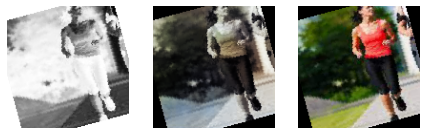

Epoch 1916 	 Loss: min = 0.0022053660359233618; average = 0.002704800179344602; max = 0.003183595836162567
Epoch 1917 	 Loss: min = 0.00227398332208395; average = 0.0027711112634278834; max = 0.003425511298701167
Epoch 1918 	 Loss: min = 0.002204530406743288; average = 0.0027442333957878873; max = 0.004349167924374342
Epoch 1919 	 Loss: min = 0.0023241708986461163; average = 0.0027845829317811877; max = 0.0032448708079755306
Epoch 1920 	 Loss: min = 0.0022669618483632803; average = 0.00279655605845619; max = 0.003759845159947872


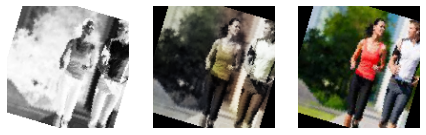

Epoch 1921 	 Loss: min = 0.0022728012409061193; average = 0.0027275581524008885; max = 0.0032598115503787994
Epoch 1922 	 Loss: min = 0.0023689232766628265; average = 0.0028496419836301357; max = 0.00397080322727561
Epoch 1923 	 Loss: min = 0.0022442711051553488; average = 0.0027086714981123805; max = 0.0031402558088302612
Epoch 1924 	 Loss: min = 0.0022029823157936335; average = 0.0026504322595428675; max = 0.002986473497003317
Epoch 1925 	 Loss: min = 0.002176288515329361; average = 0.002665984138729982; max = 0.003056352725252509


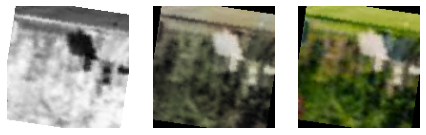

Epoch 1926 	 Loss: min = 0.0023858374916017056; average = 0.002708660773350857; max = 0.0035026157274842262
Epoch 1927 	 Loss: min = 0.0020744893699884415; average = 0.0025674248608993366; max = 0.003316247370094061
Epoch 1928 	 Loss: min = 0.0023680226877331734; average = 0.002748954822891392; max = 0.003242849139496684
Epoch 1929 	 Loss: min = 0.0021091129165142775; average = 0.002801059978082776; max = 0.0036114759277552366
Epoch 1930 	 Loss: min = 0.0023868156131356955; average = 0.0027093280223198235; max = 0.0032265465706586838


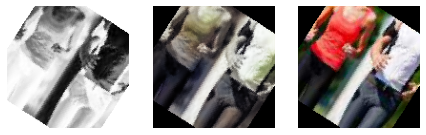

Epoch 1931 	 Loss: min = 0.0022471658885478973; average = 0.0027996811986668035; max = 0.0033955969847738743
Epoch 1932 	 Loss: min = 0.0024114770349115133; average = 0.002763910320936702; max = 0.0034958524629473686
Epoch 1933 	 Loss: min = 0.0022070081904530525; average = 0.0027163737977389246; max = 0.0038217457477003336
Epoch 1934 	 Loss: min = 0.0022222106344997883; average = 0.002671281879884191; max = 0.0032115867361426353
Epoch 1935 	 Loss: min = 0.002185527002438903; average = 0.0027244958182564005; max = 0.0032389499247074127


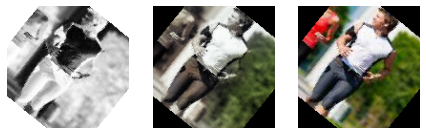

Epoch 1936 	 Loss: min = 0.00231004785746336; average = 0.0027646955131785944; max = 0.00340905855409801
Epoch 1937 	 Loss: min = 0.0020989642944186926; average = 0.002826338415616192; max = 0.004443329758942127
Epoch 1938 	 Loss: min = 0.002329246373847127; average = 0.002694171867915429; max = 0.0034927192609757185
Epoch 1939 	 Loss: min = 0.001978646032512188; average = 0.0027253466396359727; max = 0.0038865588139742613
Epoch 1940 	 Loss: min = 0.002136663533747196; average = 0.0026664778124541044; max = 0.0031468262895941734


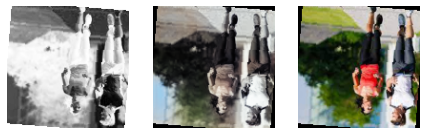

Epoch 1941 	 Loss: min = 0.0021711464505642653; average = 0.0026145869051106274; max = 0.0029450985603034496
Epoch 1942 	 Loss: min = 0.0019736490212380886; average = 0.002644824970047921; max = 0.003420590190216899
Epoch 1943 	 Loss: min = 0.002274820115417242; average = 0.002766247998806648; max = 0.003420516848564148
Epoch 1944 	 Loss: min = 0.002249999437481165; average = 0.002685481114895083; max = 0.003062815871089697
Epoch 1945 	 Loss: min = 0.0022398103028535843; average = 0.0028111570718465373; max = 0.0035072274040430784


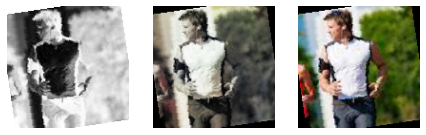

Epoch 1946 	 Loss: min = 0.002295983489602804; average = 0.002696743293199688; max = 0.003515693126246333
Epoch 1947 	 Loss: min = 0.0022040694020688534; average = 0.0026256214769091457; max = 0.0032739373855292797
Epoch 1948 	 Loss: min = 0.002272409852594137; average = 0.0027002283313777298; max = 0.003353703301399946
Epoch 1949 	 Loss: min = 0.0020864466205239296; average = 0.0027215324516873807; max = 0.003626795019954443
Epoch 1950 	 Loss: min = 0.002338860649615526; average = 0.002824494891683571; max = 0.003873468143865466


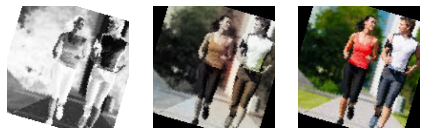

Epoch 1951 	 Loss: min = 0.0024162381887435913; average = 0.002784132564556785; max = 0.003240525256842375
Epoch 1952 	 Loss: min = 0.002307840855792165; average = 0.0026705660129664466; max = 0.0034338347613811493
Epoch 1953 	 Loss: min = 0.0022736850660294294; average = 0.0026247419737046584; max = 0.0030261168722063303
Epoch 1954 	 Loss: min = 0.002369461115449667; average = 0.0026487138820812106; max = 0.00326222600415349
Epoch 1955 	 Loss: min = 0.0020406136754900217; average = 0.0025667939335107803; max = 0.002991337329149246


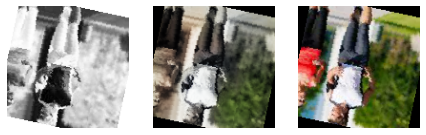

Epoch 1956 	 Loss: min = 0.00229218159802258; average = 0.0026642947923392057; max = 0.00319490535184741
Epoch 1957 	 Loss: min = 0.002117821015417576; average = 0.002865713628125377; max = 0.003855096874758601
Epoch 1958 	 Loss: min = 0.002194149885326624; average = 0.002683718965272419; max = 0.0033521687146276236
Epoch 1959 	 Loss: min = 0.0021779616363346577; average = 0.002667636625119485; max = 0.0030266009271144867
Epoch 1960 	 Loss: min = 0.002339794998988509; average = 0.0026463796821190044; max = 0.003163665533065796


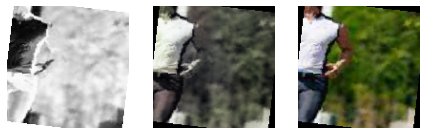

Epoch 1961 	 Loss: min = 0.0021263821981847286; average = 0.002726074220845476; max = 0.003283323720097542
Epoch 1962 	 Loss: min = 0.002290683565661311; average = 0.0028482426423579454; max = 0.005171117838472128
Epoch 1963 	 Loss: min = 0.0021222690120339394; average = 0.0026716631109593436; max = 0.0030628074891865253
Epoch 1964 	 Loss: min = 0.0022409730590879917; average = 0.0027569826634135097; max = 0.0034116655588150024
Epoch 1965 	 Loss: min = 0.0020753806456923485; average = 0.002859563086531125; max = 0.004285605624318123


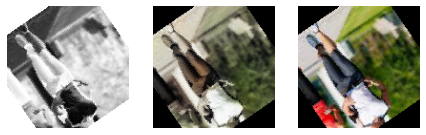

Epoch 1966 	 Loss: min = 0.002253458136692643; average = 0.002660048601683229; max = 0.003270489629358053
Epoch 1967 	 Loss: min = 0.0021539777517318726; average = 0.002614883182104677; max = 0.003245650790631771
Epoch 1968 	 Loss: min = 0.00231822207570076; average = 0.0026402776275062934; max = 0.0031136958859860897
Epoch 1969 	 Loss: min = 0.0022470566909760237; average = 0.0026613645895849913; max = 0.003363782074302435
Epoch 1970 	 Loss: min = 0.0023932624608278275; average = 0.0027759667282225564; max = 0.0037521475460380316


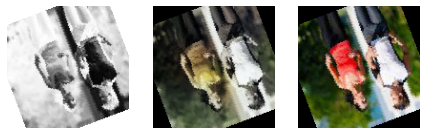

Epoch 1971 	 Loss: min = 0.0024951016530394554; average = 0.0029313637205632403; max = 0.003918453119695187
Epoch 1972 	 Loss: min = 0.0022054114378988743; average = 0.0026633737579686567; max = 0.00336190196685493
Epoch 1973 	 Loss: min = 0.0023134788498282433; average = 0.002595933896373026; max = 0.0028555449098348618
Epoch 1974 	 Loss: min = 0.002190057188272476; average = 0.0026807043614098802; max = 0.0034857471473515034
Epoch 1975 	 Loss: min = 0.002077938988804817; average = 0.002642282794113271; max = 0.0029956642538309097


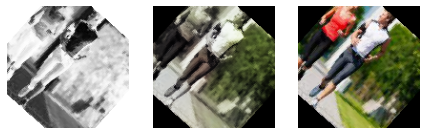

Epoch 1976 	 Loss: min = 0.0021997415460646152; average = 0.0026820348866749555; max = 0.003240219783037901
Epoch 1977 	 Loss: min = 0.002163119614124298; average = 0.0026945002464344725; max = 0.0034572023432701826
Epoch 1978 	 Loss: min = 0.0024085266049951315; average = 0.002761128271231428; max = 0.004038554150611162
Epoch 1979 	 Loss: min = 0.002176745096221566; average = 0.002665847263415344; max = 0.003387617878615856
Epoch 1980 	 Loss: min = 0.0021957033313810825; average = 0.0025870132812997326; max = 0.0028214287012815475


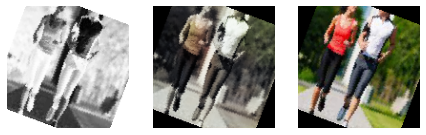

Epoch 1981 	 Loss: min = 0.002032740507274866; average = 0.0026509413291933015; max = 0.0037489417009055614
Epoch 1982 	 Loss: min = 0.002197751309722662; average = 0.0025885993818519637; max = 0.0029775495640933514
Epoch 1983 	 Loss: min = 0.0020612203516066074; average = 0.0024913848465075716; max = 0.0027600470930337906
Epoch 1984 	 Loss: min = 0.002330420073121786; average = 0.002813880317262374; max = 0.004050666932016611
Epoch 1985 	 Loss: min = 0.0021028395276516676; average = 0.0026509043527767062; max = 0.003565640887245536


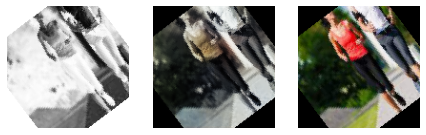

Epoch 1986 	 Loss: min = 0.002109288005158305; average = 0.002637183148181066; max = 0.0033056014217436314
Epoch 1987 	 Loss: min = 0.0022560458164662123; average = 0.002726881968555972; max = 0.0032463285606354475
Epoch 1988 	 Loss: min = 0.0021318988874554634; average = 0.002781223534839228; max = 0.003941715694963932
Epoch 1989 	 Loss: min = 0.002309068338945508; average = 0.0027158484153915197; max = 0.003361060284078121
Epoch 1990 	 Loss: min = 0.0022495086304843426; average = 0.002642530540470034; max = 0.003372112289071083


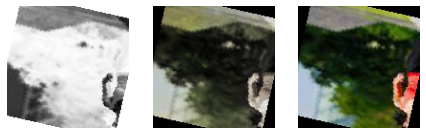

Epoch 1991 	 Loss: min = 0.0022839223966002464; average = 0.0025636443606344983; max = 0.00303841196000576
Epoch 1992 	 Loss: min = 0.002341542625799775; average = 0.002830681492923759; max = 0.003567332401871681
Epoch 1993 	 Loss: min = 0.002254512393847108; average = 0.002727371800574474; max = 0.003498732578009367
Epoch 1994 	 Loss: min = 0.002278677187860012; average = 0.002714557485887781; max = 0.0036571077071130276
Epoch 1995 	 Loss: min = 0.0020495480857789516; average = 0.002565208822488785; max = 0.003098132787272334


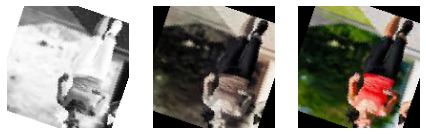

Epoch 1996 	 Loss: min = 0.002092448528856039; average = 0.00258229993050918; max = 0.0030271185096353292
Epoch 1997 	 Loss: min = 0.0022742273285984993; average = 0.002561525456258096; max = 0.0028719869442284107
Epoch 1998 	 Loss: min = 0.0022938239853829145; average = 0.002630245580803603; max = 0.0033677273895591497
Epoch 1999 	 Loss: min = 0.002174163004383445; average = 0.002698599608265795; max = 0.0031562973745167255
Epoch 2000 	 Loss: min = 0.002186961006373167; average = 0.0026579786062939093; max = 0.003625930054113269


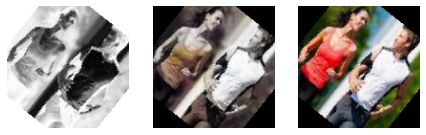

Epoch 2001 	 Loss: min = 0.0022369425278156996; average = 0.0026238423452014104; max = 0.003280602628365159
Epoch 2002 	 Loss: min = 0.00211237627081573; average = 0.002610310650197789; max = 0.0032790459226816893
Epoch 2003 	 Loss: min = 0.002261534333229065; average = 0.002587513576145284; max = 0.0031972634606063366
Epoch 2004 	 Loss: min = 0.002213787753134966; average = 0.002573548219515942; max = 0.0033426349982619286
Epoch 2005 	 Loss: min = 0.002178655005991459; average = 0.002638264835695736; max = 0.00476445397362113


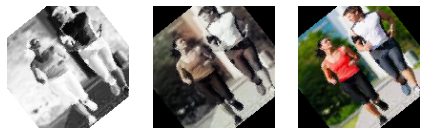

Epoch 2006 	 Loss: min = 0.0022908335085958242; average = 0.0026265004562446848; max = 0.003096332773566246
Epoch 2007 	 Loss: min = 0.0021489800419658422; average = 0.002796068656607531; max = 0.003885481972247362
Epoch 2008 	 Loss: min = 0.0022081290371716022; average = 0.0026038481591967866; max = 0.0033031534403562546
Epoch 2009 	 Loss: min = 0.0023023621179163456; average = 0.0028504741057986394; max = 0.0034454509150236845
Epoch 2010 	 Loss: min = 0.0023159084375947714; average = 0.002775532178930007; max = 0.0036204024218022823


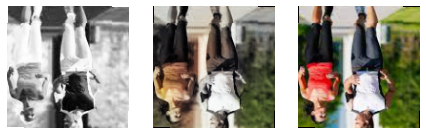

Epoch 2011 	 Loss: min = 0.002208389574661851; average = 0.0027416138036642224; max = 0.0034572966396808624
Epoch 2012 	 Loss: min = 0.0023488434962928295; average = 0.002742931537795812; max = 0.0034717663656920195
Epoch 2013 	 Loss: min = 0.0020143494475632906; average = 0.0025754388043424115; max = 0.003107372671365738
Epoch 2014 	 Loss: min = 0.002105340361595154; average = 0.0025721194251673296; max = 0.003203792031854391
Epoch 2015 	 Loss: min = 0.002055693417787552; average = 0.0025850684905890375; max = 0.003084649797528982


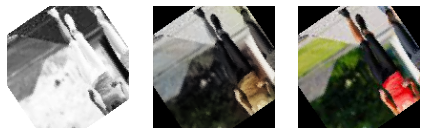

Epoch 2016 	 Loss: min = 0.002178078517317772; average = 0.002717697832849808; max = 0.0032531917095184326
Epoch 2017 	 Loss: min = 0.0023632138036191463; average = 0.0027726552361855283; max = 0.0037205058615654707
Epoch 2018 	 Loss: min = 0.00197808351367712; average = 0.0026024813705589622; max = 0.0030344240367412567
Epoch 2019 	 Loss: min = 0.002162766410037875; average = 0.0025773518427740782; max = 0.0031285728327929974
Epoch 2020 	 Loss: min = 0.0022521645296365023; average = 0.0026579996338114142; max = 0.0034250456374138594


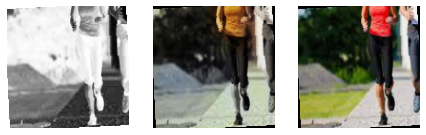

Epoch 2021 	 Loss: min = 0.002335594268515706; average = 0.0026829743874259293; max = 0.003007047576829791
Epoch 2022 	 Loss: min = 0.0022286307066679; average = 0.00267034383432474; max = 0.0032193202059715986
Epoch 2023 	 Loss: min = 0.0023299152962863445; average = 0.0025822352181421593; max = 0.0029658875428140163
Epoch 2024 	 Loss: min = 0.0023383318912237883; average = 0.00268598337424919; max = 0.0033177323639392853
Epoch 2025 	 Loss: min = 0.0021912131924182177; average = 0.0026129850739380345; max = 0.0030608181841671467


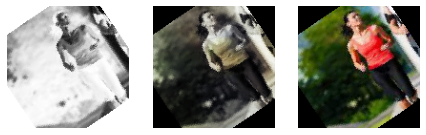

Epoch 2026 	 Loss: min = 0.002048240043222904; average = 0.0025898713793139905; max = 0.0031633812468498945
Epoch 2027 	 Loss: min = 0.0019553881138563156; average = 0.00251886312616989; max = 0.002953641815111041
Epoch 2028 	 Loss: min = 0.002208469435572624; average = 0.002544571805628948; max = 0.0032381878700107336
Epoch 2029 	 Loss: min = 0.002046148991212249; average = 0.002653833871590905; max = 0.00319712795317173
Epoch 2030 	 Loss: min = 0.0021908869966864586; average = 0.002633405980304815; max = 0.003270608838647604


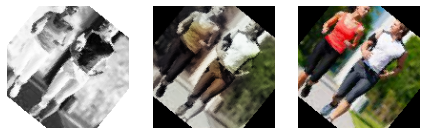

Epoch 2031 	 Loss: min = 0.002233677078038454; average = 0.002609766015666537; max = 0.003080744296312332
Epoch 2032 	 Loss: min = 0.0021156873553991318; average = 0.002691199682885781; max = 0.0037025203928351402
Epoch 2033 	 Loss: min = 0.0022301464341580868; average = 0.002618069585878402; max = 0.0033011785708367825
Epoch 2034 	 Loss: min = 0.0019844055641442537; average = 0.002606445850688033; max = 0.0033185495994985104
Epoch 2035 	 Loss: min = 0.0022723970469087362; average = 0.002729160085436888; max = 0.00323273753747344


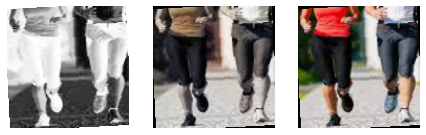

Epoch 2036 	 Loss: min = 0.0022695125080645084; average = 0.002925940847489983; max = 0.004482402931898832
Epoch 2037 	 Loss: min = 0.0022836122661828995; average = 0.0026059400552185252; max = 0.0029616865795105696
Epoch 2038 	 Loss: min = 0.002077405108138919; average = 0.0025897243758663535; max = 0.003113121259957552
Epoch 2039 	 Loss: min = 0.0020981691777706146; average = 0.0026767563686007634; max = 0.0036070439964532852
Epoch 2040 	 Loss: min = 0.002263015601783991; average = 0.0026134136569453403; max = 0.003232216229662299


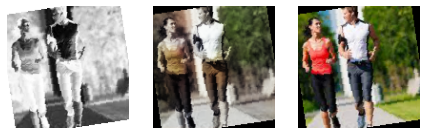

Epoch 2041 	 Loss: min = 0.0021683743689209223; average = 0.0025769265630515292; max = 0.0031400411389768124
Epoch 2042 	 Loss: min = 0.002253968734294176; average = 0.0028783915477106348; max = 0.004537208005785942
Epoch 2043 	 Loss: min = 0.0022433348931372166; average = 0.0026675307599361986; max = 0.004237140063196421
Epoch 2044 	 Loss: min = 0.0021079792641103268; average = 0.002680553268874064; max = 0.003257816657423973
Epoch 2045 	 Loss: min = 0.002190221566706896; average = 0.002549906916101463; max = 0.003082843031734228


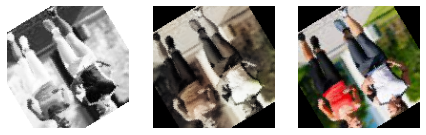

Epoch 2046 	 Loss: min = 0.0019532793667167425; average = 0.0025106166576733813; max = 0.0029808932449668646
Epoch 2047 	 Loss: min = 0.0021936355624347925; average = 0.0026356282469350845; max = 0.003068051766604185
Epoch 2048 	 Loss: min = 0.002105895895510912; average = 0.002700667333556339; max = 0.0036132324021309614
Epoch 2049 	 Loss: min = 0.002023437526077032; average = 0.0025590483710402623; max = 0.0033333636820316315
Epoch 2050 	 Loss: min = 0.002285407390445471; average = 0.002710815839236602; max = 0.003289600368589163


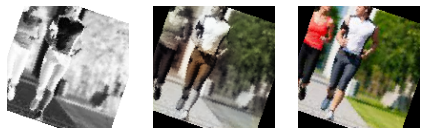

Epoch 2051 	 Loss: min = 0.002239474095404148; average = 0.002579108811914921; max = 0.003229796886444092
Epoch 2052 	 Loss: min = 0.002242553513497114; average = 0.0026506157009862363; max = 0.003608632367104292
Epoch 2053 	 Loss: min = 0.0023438031785190105; average = 0.0026249532675137743; max = 0.0031603090465068817
Epoch 2054 	 Loss: min = 0.0022229058668017387; average = 0.0026546390872681513; max = 0.0034888971131294966
Epoch 2055 	 Loss: min = 0.002139992779120803; average = 0.002596350765088573; max = 0.0037942989729344845


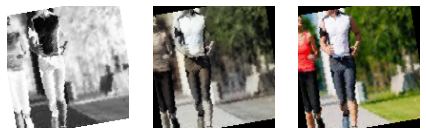

Epoch 2056 	 Loss: min = 0.0020780356135219336; average = 0.00272361739189364; max = 0.0038905772380530834
Epoch 2057 	 Loss: min = 0.0022296360693871975; average = 0.002681485697394237; max = 0.003831281093880534
Epoch 2058 	 Loss: min = 0.002308610361069441; average = 0.00295905998791568; max = 0.004244339652359486
Epoch 2059 	 Loss: min = 0.0019273370271548629; average = 0.0026004913888755254; max = 0.003272084053605795
Epoch 2060 	 Loss: min = 0.002057598205283284; average = 0.002597207552753389; max = 0.0034884752240031958


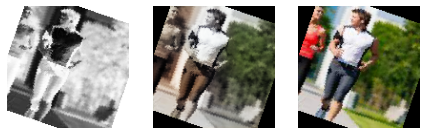

Epoch 2061 	 Loss: min = 0.0021624553482979536; average = 0.0026324176869820803; max = 0.003323449520394206
Epoch 2062 	 Loss: min = 0.0019676208030432463; average = 0.002647453366080299; max = 0.003219886450096965
Epoch 2063 	 Loss: min = 0.002023249864578247; average = 0.0026329298998462036; max = 0.003221012419089675
Epoch 2064 	 Loss: min = 0.002273457357659936; average = 0.0028728124452754855; max = 0.004207320977002382
Epoch 2065 	 Loss: min = 0.0020715342834591866; average = 0.0026465892733540386; max = 0.0038281488232314587


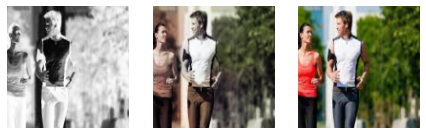

Epoch 2066 	 Loss: min = 0.0023202700540423393; average = 0.002769838902167976; max = 0.003687687683850527
Epoch 2067 	 Loss: min = 0.0022231866605579853; average = 0.0026656784175429493; max = 0.0035141906701028347
Epoch 2068 	 Loss: min = 0.002142569050192833; average = 0.0026022653037216514; max = 0.0040763309225440025
Epoch 2069 	 Loss: min = 0.002095745876431465; average = 0.0027291262813378125; max = 0.004049560520797968
Epoch 2070 	 Loss: min = 0.002231755992397666; average = 0.002615780249470845; max = 0.0033748182468116283


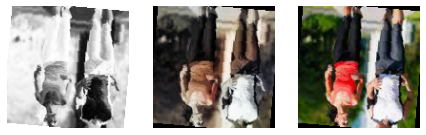

Epoch 2071 	 Loss: min = 0.002082465449348092; average = 0.0025519551272736862; max = 0.0031330157071352005
Epoch 2072 	 Loss: min = 0.002445437014102936; average = 0.002681018697330728; max = 0.003619158174842596
Epoch 2073 	 Loss: min = 0.0019714958034455776; average = 0.002512703082174994; max = 0.0031107596587389708
Epoch 2074 	 Loss: min = 0.0020568561740219593; average = 0.0026147831813432276; max = 0.003179022576659918
Epoch 2075 	 Loss: min = 0.0021832063794136047; average = 0.002618857950437814; max = 0.0032430251594632864


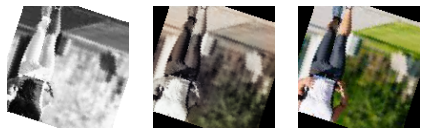

Epoch 2076 	 Loss: min = 0.0023012044839560986; average = 0.0027032977232011035; max = 0.003812317503616214
Epoch 2077 	 Loss: min = 0.001987171359360218; average = 0.0025447459775023162; max = 0.0032554769422858953
Epoch 2078 	 Loss: min = 0.002101816004142165; average = 0.0025710542395245284; max = 0.0035117287188768387
Epoch 2079 	 Loss: min = 0.0019765410106629133; average = 0.0025869007367873564; max = 0.0034388115163892508
Epoch 2080 	 Loss: min = 0.0022283883299678564; average = 0.002525558360503055; max = 0.003348377300426364


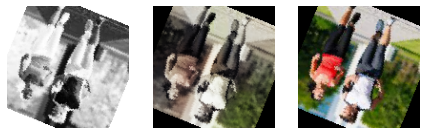

Epoch 2081 	 Loss: min = 0.0022839801385998726; average = 0.0025778516428545117; max = 0.002951798029243946
Epoch 2082 	 Loss: min = 0.0021803812123835087; average = 0.0026540598773863167; max = 0.003756239078938961
Epoch 2083 	 Loss: min = 0.0022607455030083656; average = 0.0025514963344903663; max = 0.003156875027343631
Epoch 2084 	 Loss: min = 0.002045269589871168; average = 0.002421964571112767; max = 0.0028678893577307463
Epoch 2085 	 Loss: min = 0.0021285105030983686; average = 0.0024719774664845318; max = 0.0030557746067643166


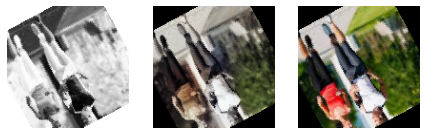

Epoch 2086 	 Loss: min = 0.002231094753369689; average = 0.002623907959787175; max = 0.0034074902068823576
Epoch 2087 	 Loss: min = 0.002109496621415019; average = 0.0026715882995631546; max = 0.0036371303722262383
Epoch 2088 	 Loss: min = 0.0021418705582618713; average = 0.002517975590308197; max = 0.00296559720300138
Epoch 2089 	 Loss: min = 0.002168758772313595; average = 0.0024852790375007316; max = 0.003013397566974163
Epoch 2090 	 Loss: min = 0.0020295358262956142; average = 0.0025349556817673147; max = 0.0031692394986748695


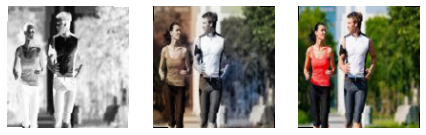

Epoch 2091 	 Loss: min = 0.002138582058250904; average = 0.002495152351912111; max = 0.002903275191783905
Epoch 2092 	 Loss: min = 0.0022753961384296417; average = 0.0025700763653730974; max = 0.0030501370783895254
Epoch 2093 	 Loss: min = 0.002179610077291727; average = 0.0024941746960394084; max = 0.0029923985712230206
Epoch 2094 	 Loss: min = 0.00216035358607769; average = 0.0025251252518501133; max = 0.0028092588763684034
Epoch 2095 	 Loss: min = 0.0023167121689766645; average = 0.0027187957166461274; max = 0.0031623400282114744


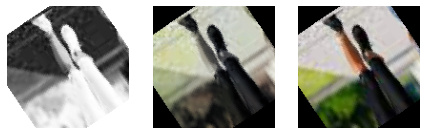

Epoch 2096 	 Loss: min = 0.0021117916330695152; average = 0.002600567400804721; max = 0.0033093129750341177
Epoch 2097 	 Loss: min = 0.002013014629483223; average = 0.0024589440727140754; max = 0.003222417552024126
Epoch 2098 	 Loss: min = 0.0022107758559286594; average = 0.0026794987497851253; max = 0.0032982805278152227
Epoch 2099 	 Loss: min = 0.002247193828225136; average = 0.002676948337466456; max = 0.0038131107576191425
Epoch 2100 	 Loss: min = 0.002144323894754052; average = 0.0026473250036360696; max = 0.002981062512844801


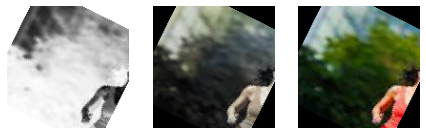

Epoch 2101 	 Loss: min = 0.002084382576867938; average = 0.002593393699498847; max = 0.0033025075681507587
Epoch 2102 	 Loss: min = 0.002050180919468403; average = 0.002550831835833378; max = 0.003113875864073634
Epoch 2103 	 Loss: min = 0.002225778764113784; average = 0.0026937973161693662; max = 0.003083533374592662
Epoch 2104 	 Loss: min = 0.0021760803647339344; average = 0.0026421186921652406; max = 0.0031647407449781895
Epoch 2105 	 Loss: min = 0.0018524433253332973; average = 0.0026011587542598136; max = 0.003208720125257969


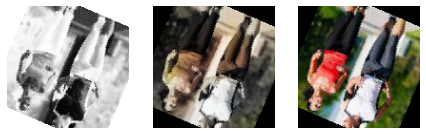

Epoch 2106 	 Loss: min = 0.002185114426538348; average = 0.0025260501133743674; max = 0.0031333635561168194
Epoch 2107 	 Loss: min = 0.002228404628112912; average = 0.0026309048698749393; max = 0.003146946430206299
Epoch 2108 	 Loss: min = 0.0021628648974001408; average = 0.0026599696720950305; max = 0.00328863225877285
Epoch 2109 	 Loss: min = 0.002252597827464342; average = 0.002666287764441222; max = 0.003678996115922928
Epoch 2110 	 Loss: min = 0.002274568658322096; average = 0.0026195129903499037; max = 0.0031336788088083267


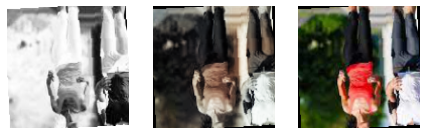

Epoch 2111 	 Loss: min = 0.002209453145042062; average = 0.0026314792630728334; max = 0.0033330104779452085
Epoch 2112 	 Loss: min = 0.002209786092862487; average = 0.0025130618596449494; max = 0.0033044698648154736
Epoch 2113 	 Loss: min = 0.0022480827756226063; average = 0.0026437880733283237; max = 0.003480603452771902
Epoch 2114 	 Loss: min = 0.0023838733322918415; average = 0.0026942444092128426; max = 0.0031697750091552734
Epoch 2115 	 Loss: min = 0.0021367596928030252; average = 0.002608729380881414; max = 0.003521614708006382


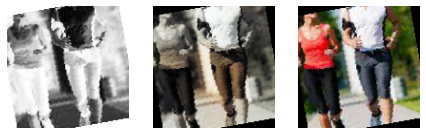

Epoch 2116 	 Loss: min = 0.002208293415606022; average = 0.002559768778155558; max = 0.002959407400339842
Epoch 2117 	 Loss: min = 0.0022020095493644476; average = 0.0025650308380136266; max = 0.002917067613452673
Epoch 2118 	 Loss: min = 0.00216305791400373; average = 0.002445760095724836; max = 0.0030460625421255827
Epoch 2119 	 Loss: min = 0.0021481008734554052; average = 0.0024861790152499452; max = 0.00300382892601192
Epoch 2120 	 Loss: min = 0.002154118847101927; average = 0.002421424724161625; max = 0.00280554685741663


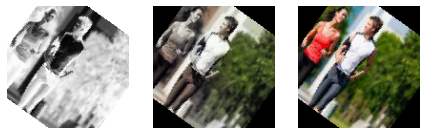

Epoch 2121 	 Loss: min = 0.0021670209243893623; average = 0.0026694897969719023; max = 0.003582108300179243
Epoch 2122 	 Loss: min = 0.002168460749089718; average = 0.002611569798318669; max = 0.003106093732640147
Epoch 2123 	 Loss: min = 0.002191028092056513; average = 0.0025687786692287773; max = 0.003332895692437887
Epoch 2124 	 Loss: min = 0.0021013752557337284; average = 0.0025823084579315037; max = 0.003129207296296954
Epoch 2125 	 Loss: min = 0.0022631094325333834; average = 0.0024679971538716927; max = 0.0029984961729496717


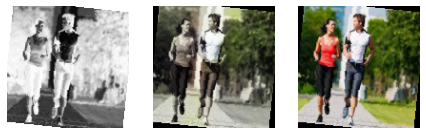

Epoch 2126 	 Loss: min = 0.002098939847201109; average = 0.0024378595262533054; max = 0.0027583797927945852
Epoch 2127 	 Loss: min = 0.0019440881442278624; average = 0.0024125908239511773; max = 0.0030338410288095474
Epoch 2128 	 Loss: min = 0.0021958700381219387; average = 0.0025871398829622194; max = 0.003088500816375017
Epoch 2129 	 Loss: min = 0.0020926634315401316; average = 0.002579086212790571; max = 0.0029650849755853415
Epoch 2130 	 Loss: min = 0.0020576966926455498; average = 0.002624155778903514; max = 0.0033369576558470726


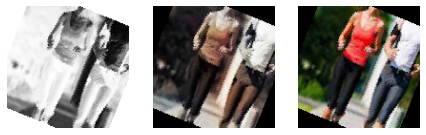

Epoch 2131 	 Loss: min = 0.0021577998995780945; average = 0.002691228102776222; max = 0.0031175760086625814
Epoch 2132 	 Loss: min = 0.002112752292305231; average = 0.002685464292881079; max = 0.003374909982085228
Epoch 2133 	 Loss: min = 0.001967014279216528; average = 0.002697197880479507; max = 0.0034187943674623966
Epoch 2134 	 Loss: min = 0.0023275373969227076; average = 0.0026694739353843033; max = 0.003257539588958025
Epoch 2135 	 Loss: min = 0.002196153625845909; average = 0.0025861945032374933; max = 0.0030550360679626465


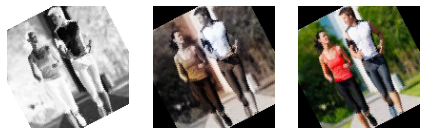

Epoch 2136 	 Loss: min = 0.002282331231981516; average = 0.002698372394661419; max = 0.0033777139615267515
Epoch 2137 	 Loss: min = 0.0020297879818826914; average = 0.002661289880052209; max = 0.004253944847732782
Epoch 2138 	 Loss: min = 0.002118340227752924; average = 0.0025174565089400858; max = 0.003239088226109743
Epoch 2139 	 Loss: min = 0.0021486226469278336; average = 0.002740663767326623; max = 0.0043005384504795074
Epoch 2140 	 Loss: min = 0.0022542530205100775; average = 0.002624562941491604; max = 0.0031575390603393316


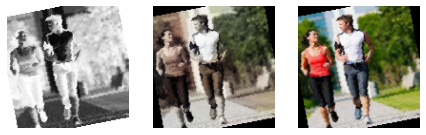

Epoch 2141 	 Loss: min = 0.0020440486259758472; average = 0.0025190919841406867; max = 0.0035547446459531784
Epoch 2142 	 Loss: min = 0.00204460509121418; average = 0.0025879556487780064; max = 0.004346572794020176
Epoch 2143 	 Loss: min = 0.0022397811990231276; average = 0.0025392574461875483; max = 0.002897904720157385
Epoch 2144 	 Loss: min = 0.0023046110291033983; average = 0.0025936991441994905; max = 0.003160580527037382
Epoch 2145 	 Loss: min = 0.0021552161779254675; average = 0.002436586728435941; max = 0.002904285443946719


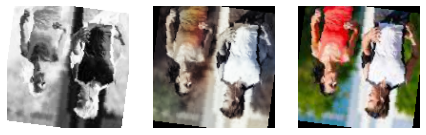

Epoch 2146 	 Loss: min = 0.0020880333613604307; average = 0.0024640322371851653; max = 0.0030946102924644947
Epoch 2147 	 Loss: min = 0.002187669277191162; average = 0.0026029053406091407; max = 0.0037899711169302464
Epoch 2148 	 Loss: min = 0.002110984642058611; average = 0.002507416080334224; max = 0.003068429883569479
Epoch 2149 	 Loss: min = 0.00216754712164402; average = 0.0025484340148977935; max = 0.002980124903842807
Epoch 2150 	 Loss: min = 0.002337696496397257; average = 0.00267664750572294; max = 0.003210345981642604


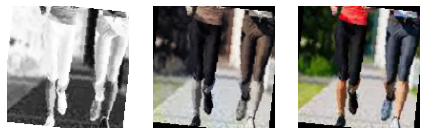

Epoch 2151 	 Loss: min = 0.002118044765666127; average = 0.00253435448394157; max = 0.0030275993049144745
Epoch 2152 	 Loss: min = 0.0021773329935967922; average = 0.0026355444424552843; max = 0.0033288225531578064
Epoch 2153 	 Loss: min = 0.0021543269976973534; average = 0.0026526528235990554; max = 0.0034470590762794018
Epoch 2154 	 Loss: min = 0.002227324992418289; average = 0.0025886606599669904; max = 0.002961722668260336
Epoch 2155 	 Loss: min = 0.0019468138925731182; average = 0.0025259117101086304; max = 0.002962803468108177


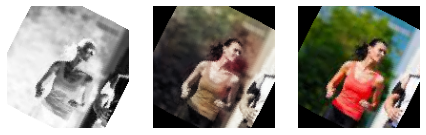

Epoch 2156 	 Loss: min = 0.0020773857831954956; average = 0.0026781974447658285; max = 0.0038352427072823048
Epoch 2157 	 Loss: min = 0.002205940429121256; average = 0.0024958761932794005; max = 0.0029279550071805716
Epoch 2158 	 Loss: min = 0.002202728297561407; average = 0.0027031503996113315; max = 0.003846991341561079
Epoch 2159 	 Loss: min = 0.0021622672211378813; average = 0.0025684990250738338; max = 0.002932110335677862
Epoch 2160 	 Loss: min = 0.0021696272306144238; average = 0.002560976878157817; max = 0.0029514115303754807


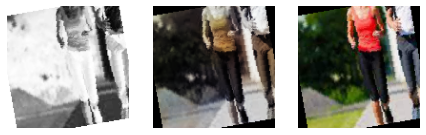

Epoch 2161 	 Loss: min = 0.0019906272646039724; average = 0.0025604723778087646; max = 0.0037268472369760275
Epoch 2162 	 Loss: min = 0.0020508458837866783; average = 0.002498383619240485; max = 0.0031847506761550903
Epoch 2163 	 Loss: min = 0.0018503812607377768; average = 0.0024631754349684343; max = 0.0032576373778283596
Epoch 2164 	 Loss: min = 0.0020871879532933235; average = 0.002609479270176962; max = 0.003244210733100772
Epoch 2165 	 Loss: min = 0.0021173690911382437; average = 0.002533548205974512; max = 0.0031803473830223083


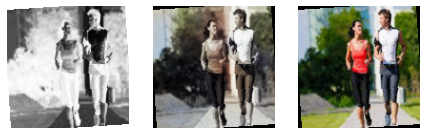

Epoch 2166 	 Loss: min = 0.002177569782361388; average = 0.0026640502037480474; max = 0.003127812873572111
Epoch 2167 	 Loss: min = 0.002152168657630682; average = 0.0025424764316994697; max = 0.003420430701225996
Epoch 2168 	 Loss: min = 0.002172008855268359; average = 0.0026392326108179986; max = 0.003953910432755947
Epoch 2169 	 Loss: min = 0.0023405645042657852; average = 0.0026925695565296337; max = 0.0035042553208768368
Epoch 2170 	 Loss: min = 0.002251597121357918; average = 0.002750311221461743; max = 0.003442581743001938


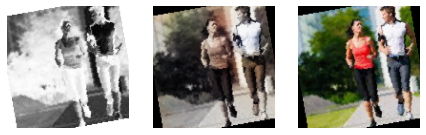

Epoch 2171 	 Loss: min = 0.0022596754133701324; average = 0.0026645648904377595; max = 0.0032560627441853285
Epoch 2172 	 Loss: min = 0.0021877530962228775; average = 0.002544744114857167; max = 0.002982335863634944
Epoch 2173 	 Loss: min = 0.0022099334746599197; average = 0.0026848981069633737; max = 0.0034072508569806814
Epoch 2174 	 Loss: min = 0.0020894163753837347; average = 0.0025218318041879684; max = 0.003109896322712302
Epoch 2175 	 Loss: min = 0.0022231386974453926; average = 0.002670064175617881; max = 0.0037764818407595158


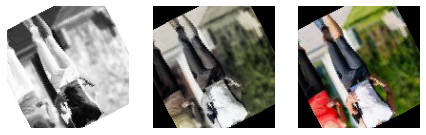

Epoch 2176 	 Loss: min = 0.002142100129276514; average = 0.0026136833912460133; max = 0.0032714419066905975
Epoch 2177 	 Loss: min = 0.002173304557800293; average = 0.0024973899562610313; max = 0.0033077793195843697
Epoch 2178 	 Loss: min = 0.0020786391105502844; average = 0.0025943237269530073; max = 0.003393543651327491
Epoch 2179 	 Loss: min = 0.0021196589805185795; average = 0.0024891577195376158; max = 0.002945487853139639
Epoch 2180 	 Loss: min = 0.0021163802593946457; average = 0.0024895065143937245; max = 0.0032876490149646997


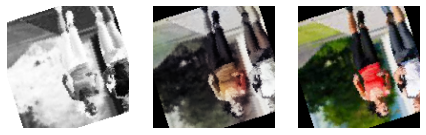

Epoch 2181 	 Loss: min = 0.0021317368373274803; average = 0.0026754811697173864; max = 0.0037195910699665546
Epoch 2182 	 Loss: min = 0.0019793042447417974; average = 0.0026825797540368512; max = 0.003163115819916129
Epoch 2183 	 Loss: min = 0.002034003846347332; average = 0.002489707199856639; max = 0.0030389497987926006
Epoch 2184 	 Loss: min = 0.002069228095933795; average = 0.002574239784735255; max = 0.0031900478061288595
Epoch 2185 	 Loss: min = 0.002076156437397003; average = 0.0024658766051288694; max = 0.003334600944072008


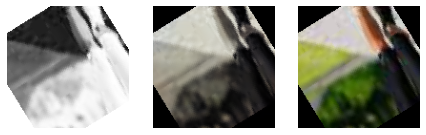

Epoch 2186 	 Loss: min = 0.0022209251765161753; average = 0.0024743992398725823; max = 0.003164017340168357
Epoch 2187 	 Loss: min = 0.0021436396054923534; average = 0.002515964355552569; max = 0.0027264761738479137
Epoch 2188 	 Loss: min = 0.0020889826118946075; average = 0.0026725364150479436; max = 0.0036849945317953825
Epoch 2189 	 Loss: min = 0.002136742928996682; average = 0.0025329943164251745; max = 0.002984558464959264
Epoch 2190 	 Loss: min = 0.002024800283834338; average = 0.0024705799587536603; max = 0.002806661184877157


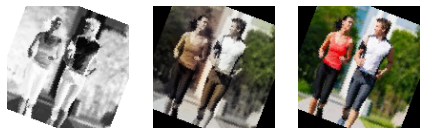

Epoch 2191 	 Loss: min = 0.0020418555941432714; average = 0.0025547099066898227; max = 0.003016827628016472
Epoch 2192 	 Loss: min = 0.00204433873295784; average = 0.002572490120655857; max = 0.0036808522418141365
Epoch 2193 	 Loss: min = 0.0020237425342202187; average = 0.002597161670564674; max = 0.0032114635687321424
Epoch 2194 	 Loss: min = 0.002138545736670494; average = 0.002598345236037858; max = 0.003033996559679508
Epoch 2195 	 Loss: min = 0.002004462294280529; average = 0.002486888086423278; max = 0.002866956405341625


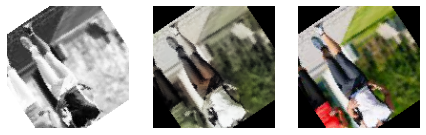

Epoch 2196 	 Loss: min = 0.0020832004956901073; average = 0.002475258690537885; max = 0.0030361886601895094
Epoch 2197 	 Loss: min = 0.0021408977918326855; average = 0.002481624745996669; max = 0.002960880985483527
Epoch 2198 	 Loss: min = 0.0021525851916521788; average = 0.002474048364092596; max = 0.00291330530308187
Epoch 2199 	 Loss: min = 0.002127045998349786; average = 0.0024040898570092395; max = 0.0027743885293602943
Epoch 2200 	 Loss: min = 0.002341628773137927; average = 0.002577821011072956; max = 0.00299016572535038


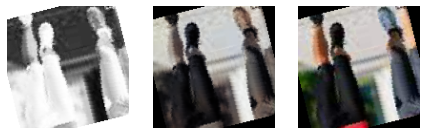

Epoch 2201 	 Loss: min = 0.002016521990299225; average = 0.002474046515999362; max = 0.002853183774277568
Epoch 2202 	 Loss: min = 0.0022543040104210377; average = 0.0026764206268126145; max = 0.00385248102247715
Epoch 2203 	 Loss: min = 0.00212366646155715; average = 0.0026400293136248365; max = 0.003267441876232624
Epoch 2204 	 Loss: min = 0.002088924404233694; average = 0.0024694731255294755; max = 0.003166595473885536
Epoch 2205 	 Loss: min = 0.002074257005006075; average = 0.0024080519506242126; max = 0.002920275554060936


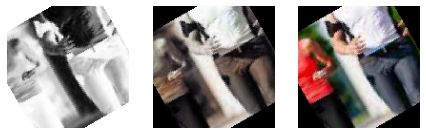

Epoch 2206 	 Loss: min = 0.002073872834444046; average = 0.002539140114095062; max = 0.0030476264655590057
Epoch 2207 	 Loss: min = 0.0020157797262072563; average = 0.0026939911913359538; max = 0.0036712358705699444
Epoch 2208 	 Loss: min = 0.00221998430788517; average = 0.002576567916548811; max = 0.003145359456539154
Epoch 2209 	 Loss: min = 0.0021189579274505377; average = 0.0025924363144440576; max = 0.0032591503113508224
Epoch 2210 	 Loss: min = 0.0020798412151634693; average = 0.002633115276694298; max = 0.003420342458412051


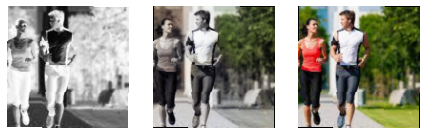

Epoch 2211 	 Loss: min = 0.0022220308892428875; average = 0.002624580098199658; max = 0.0031590014696121216
Epoch 2212 	 Loss: min = 0.002032953780144453; average = 0.0025546993128955364; max = 0.003035111352801323
Epoch 2213 	 Loss: min = 0.0021180007606744766; average = 0.0025002959446283057; max = 0.00303813349455595
Epoch 2214 	 Loss: min = 0.002179292030632496; average = 0.002441127653582953; max = 0.0027623497880995274
Epoch 2215 	 Loss: min = 0.002151454333215952; average = 0.0025928711402229965; max = 0.003301347605884075


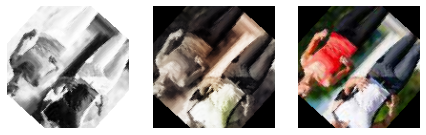

Epoch 2216 	 Loss: min = 0.0020324629731476307; average = 0.002536077721742913; max = 0.0031983274966478348
Epoch 2217 	 Loss: min = 0.0021750261075794697; average = 0.002656913857208565; max = 0.003397626569494605
Epoch 2218 	 Loss: min = 0.0020915837958455086; average = 0.002411161010968499; max = 0.002883878303691745
Epoch 2219 	 Loss: min = 0.0020198372658342123; average = 0.002509592304704711; max = 0.0035659451968967915
Epoch 2220 	 Loss: min = 0.00202704849652946; average = 0.0024157425650628284; max = 0.0027145198546350002


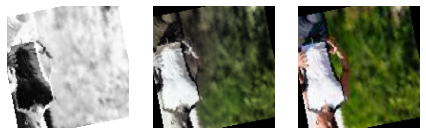

Epoch 2221 	 Loss: min = 0.0020509078167378902; average = 0.0026676278066588566; max = 0.0034302263520658016
Epoch 2222 	 Loss: min = 0.0018960218876600266; average = 0.0024628027458675206; max = 0.0028375990223139524
Epoch 2223 	 Loss: min = 0.0019344714237377048; average = 0.002635455304698553; max = 0.003555250819772482
Epoch 2224 	 Loss: min = 0.0020925961434841156; average = 0.00243974183104001; max = 0.0030915557872503996
Epoch 2225 	 Loss: min = 0.0020740011241286993; average = 0.0025384048058185726; max = 0.004137675277888775


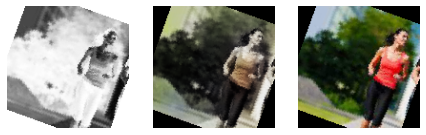

Epoch 2226 	 Loss: min = 0.002057003788650036; average = 0.0025269287871196866; max = 0.0035347696393728256
Epoch 2227 	 Loss: min = 0.002170819090679288; average = 0.0024805546272546053; max = 0.0029868409037590027
Epoch 2228 	 Loss: min = 0.0020734674762934446; average = 0.0025457756855757907; max = 0.003296100301668048
Epoch 2229 	 Loss: min = 0.0020088597666472197; average = 0.0026735882711363956; max = 0.0032467085402458906
Epoch 2230 	 Loss: min = 0.001981328707188368; average = 0.002533401202526875; max = 0.0031229506712406874


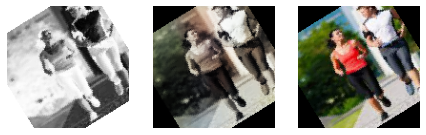

Epoch 2231 	 Loss: min = 0.0018673123558983207; average = 0.0024329193620360456; max = 0.0030678086914122105
Epoch 2232 	 Loss: min = 0.0021539898589253426; average = 0.002467801547027193; max = 0.0032654551323503256
Epoch 2233 	 Loss: min = 0.0021328055299818516; average = 0.002537348249461502; max = 0.002965411636978388
Epoch 2234 	 Loss: min = 0.002080640522763133; average = 0.0027023688453482464; max = 0.003922219388186932
Epoch 2235 	 Loss: min = 0.0021072884555906057; average = 0.0025842678151093423; max = 0.0039011656772345304


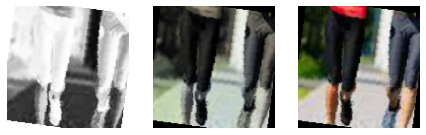

Epoch 2236 	 Loss: min = 0.00212352117523551; average = 0.002623771200887859; max = 0.0035396821331232786
Epoch 2237 	 Loss: min = 0.002162679098546505; average = 0.0024718256900087; max = 0.0031911414116621017
Epoch 2238 	 Loss: min = 0.002162559423595667; average = 0.0024359933740925044; max = 0.003088544588536024
Epoch 2239 	 Loss: min = 0.002183799399062991; average = 0.0025181722303386778; max = 0.003449014388024807
Epoch 2240 	 Loss: min = 0.0018835410010069609; average = 0.002480392635334283; max = 0.0033363753464072943


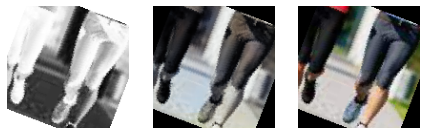

Epoch 2241 	 Loss: min = 0.002229089383035898; average = 0.0025405418855370954; max = 0.003250713227316737
Epoch 2242 	 Loss: min = 0.0022171868477016687; average = 0.0025096601457335055; max = 0.003047684207558632
Epoch 2243 	 Loss: min = 0.0020879562944173813; average = 0.0025010351091623306; max = 0.002842517103999853
Epoch 2244 	 Loss: min = 0.002041444182395935; average = 0.0025510441773803905; max = 0.003145261202007532
Epoch 2245 	 Loss: min = 0.0021673119626939297; average = 0.002460454124957323; max = 0.003268025815486908


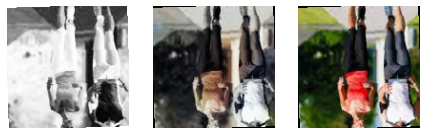

Epoch 2246 	 Loss: min = 0.0020861972589045763; average = 0.002382868740824051; max = 0.0028885870706290007
Epoch 2247 	 Loss: min = 0.0019870391115546227; average = 0.0024735866609262303; max = 0.0031681316904723644
Epoch 2248 	 Loss: min = 0.001958750654011965; average = 0.002583986453828402; max = 0.003985565155744553
Epoch 2249 	 Loss: min = 0.002084138570353389; average = 0.0024744778784224764; max = 0.0028768861666321754
Epoch 2250 	 Loss: min = 0.001965116709470749; average = 0.002766167905065231; max = 0.003625615267083049


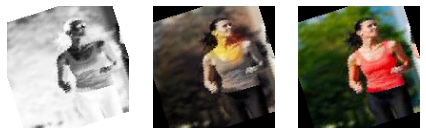

Epoch 2251 	 Loss: min = 0.002164384350180626; average = 0.002504872580175288; max = 0.0032034735195338726
Epoch 2252 	 Loss: min = 0.0022559426724910736; average = 0.0026699362933868542; max = 0.003386312397196889
Epoch 2253 	 Loss: min = 0.002139507792890072; average = 0.002831145888194442; max = 0.0040730880573391914
Epoch 2254 	 Loss: min = 0.0021830261684954166; average = 0.00262159742123913; max = 0.003219590289518237
Epoch 2255 	 Loss: min = 0.0020469992887228727; average = 0.002530151017708704; max = 0.003273868467658758


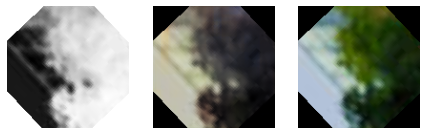

Epoch 2256 	 Loss: min = 0.002173407468944788; average = 0.002591143231256865; max = 0.003054703352972865
Epoch 2257 	 Loss: min = 0.0020598992705345154; average = 0.002560650900704786; max = 0.003311681095510721
Epoch 2258 	 Loss: min = 0.0022210050374269485; average = 0.0025341234722873196; max = 0.0036300411447882652
Epoch 2259 	 Loss: min = 0.0019549899734556675; average = 0.002461632961058058; max = 0.003275888739153743
Epoch 2260 	 Loss: min = 0.0018957837019115686; average = 0.0026977585803251714; max = 0.0031606187112629414


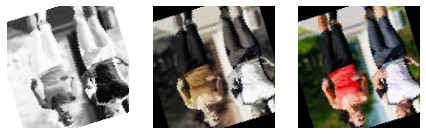

Epoch 2261 	 Loss: min = 0.0019161466043442488; average = 0.0025002273177960888; max = 0.0038737989962100983
Epoch 2262 	 Loss: min = 0.002256381791085005; average = 0.002570280703366734; max = 0.0032888161949813366
Epoch 2263 	 Loss: min = 0.0021914690732955933; average = 0.002537461419706233; max = 0.0031915835570544004
Epoch 2264 	 Loss: min = 0.0020645104814320803; average = 0.0025235034991055727; max = 0.0033498730044811964
Epoch 2265 	 Loss: min = 0.0020376010797917843; average = 0.0024909622297855094; max = 0.0032301617320626974


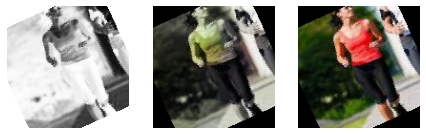

Epoch 2266 	 Loss: min = 0.002063825260847807; average = 0.0024272955633932725; max = 0.002739060204476118
Epoch 2267 	 Loss: min = 0.002203006763011217; average = 0.0024880088021745905; max = 0.0028212561737746
Epoch 2268 	 Loss: min = 0.0019057141616940498; average = 0.0024871395871741697; max = 0.0030574097763746977
Epoch 2269 	 Loss: min = 0.00215647229924798; average = 0.002600457417429425; max = 0.0037683770060539246
Epoch 2270 	 Loss: min = 0.002230746205896139; average = 0.002428449603030458; max = 0.0027070885989814997


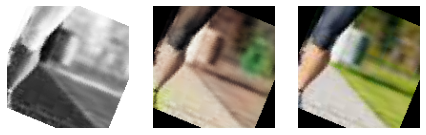

Epoch 2271 	 Loss: min = 0.0020921193063259125; average = 0.002376839503995143; max = 0.0029636125545948744
Epoch 2272 	 Loss: min = 0.002125689759850502; average = 0.00242329751199577; max = 0.0030023453291505575
Epoch 2273 	 Loss: min = 0.0020198258571326733; average = 0.002377318902290426; max = 0.002669952344149351
Epoch 2274 	 Loss: min = 0.0020600021816790104; average = 0.0025585154653526843; max = 0.003009780077263713
Epoch 2275 	 Loss: min = 0.0021642863284796476; average = 0.002510829595848918; max = 0.002974745584651828


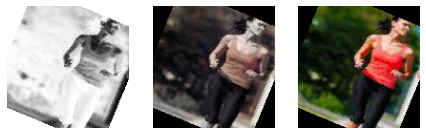

Epoch 2276 	 Loss: min = 0.0021169090177863836; average = 0.0024897584808059037; max = 0.002992133144289255
Epoch 2277 	 Loss: min = 0.0020166528411209583; average = 0.0023977149685379118; max = 0.003135217120870948
Epoch 2278 	 Loss: min = 0.001965208910405636; average = 0.002419389769784175; max = 0.002800907474011183
Epoch 2279 	 Loss: min = 0.001979369670152664; average = 0.0024444432056043297; max = 0.003215550910681486
Epoch 2280 	 Loss: min = 0.002077124547213316; average = 0.0025285823503509164; max = 0.0037580428179353476


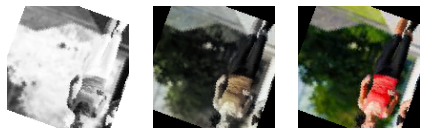

Epoch 2281 	 Loss: min = 0.0021191774867475033; average = 0.0025541650247760117; max = 0.002984373364597559
Epoch 2282 	 Loss: min = 0.0018713383469730616; average = 0.002610869807540439; max = 0.003707856871187687
Epoch 2283 	 Loss: min = 0.0018452238291501999; average = 0.0024990436068037525; max = 0.0030990445520728827
Epoch 2284 	 Loss: min = 0.0018276817863807082; average = 0.0025606963827158324; max = 0.003203275380656123
Epoch 2285 	 Loss: min = 0.002190006896853447; average = 0.002430350345093757; max = 0.0028362919110804796


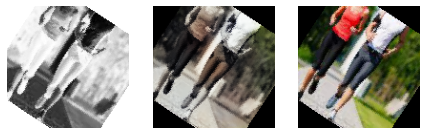

Epoch 2286 	 Loss: min = 0.0019455603323876858; average = 0.0025563043891452253; max = 0.003355718217790127
Epoch 2287 	 Loss: min = 0.0020324753131717443; average = 0.00251804493018426; max = 0.0033096380066126585
Epoch 2288 	 Loss: min = 0.0019790111109614372; average = 0.002374150266405195; max = 0.003090513404458761
Epoch 2289 	 Loss: min = 0.0018935685511678457; average = 0.0023755457950755954; max = 0.002750496845692396
Epoch 2290 	 Loss: min = 0.001970637356862426; average = 0.0025447062944294885; max = 0.00353414798155427


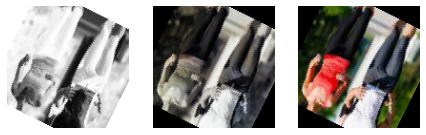

Epoch 2291 	 Loss: min = 0.001996512059122324; average = 0.002486833167495206; max = 0.003268569242209196
Epoch 2292 	 Loss: min = 0.0020860950462520123; average = 0.0025085559755098075; max = 0.0028699995018541813
Epoch 2293 	 Loss: min = 0.0022052747663110495; average = 0.002591005453723483; max = 0.002888206858187914
Epoch 2294 	 Loss: min = 0.0021566927898675203; average = 0.0025947057001758367; max = 0.0035581085830926895
Epoch 2295 	 Loss: min = 0.002111715730279684; average = 0.0025770893844310194; max = 0.0030212532728910446


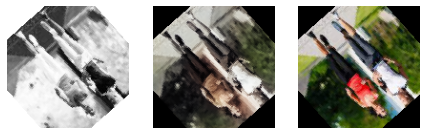

Epoch 2296 	 Loss: min = 0.0020505478605628014; average = 0.002511467449949123; max = 0.0028955391608178616
Epoch 2297 	 Loss: min = 0.002020347397774458; average = 0.0025138480123132467; max = 0.0029257764108479023
Epoch 2298 	 Loss: min = 0.002083408646285534; average = 0.0023642559826839715; max = 0.0028975196182727814
Epoch 2299 	 Loss: min = 0.0020089971367269754; average = 0.0024679390771780163; max = 0.002906292211264372
Epoch 2300 	 Loss: min = 0.0022062878124415874; average = 0.002489779653842561; max = 0.002980519086122513


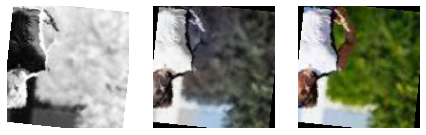

Epoch 2301 	 Loss: min = 0.0020814323797822; average = 0.0024384457065025344; max = 0.0028683338314294815
Epoch 2302 	 Loss: min = 0.0020910317543894053; average = 0.0025274408981204033; max = 0.0037151463329792023
Epoch 2303 	 Loss: min = 0.0020016662310808897; average = 0.002406160769169219; max = 0.0029220448341220617
Epoch 2304 	 Loss: min = 0.002173537854105234; average = 0.002433030414977111; max = 0.0027747005224227905
Epoch 2305 	 Loss: min = 0.0021201518829911947; average = 0.0026822590734809637; max = 0.004170605912804604


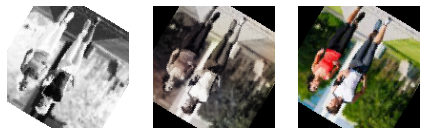

Epoch 2306 	 Loss: min = 0.002164869336411357; average = 0.0025995547766797245; max = 0.0031242265831679106
Epoch 2307 	 Loss: min = 0.0021449937485158443; average = 0.002583136680186726; max = 0.0031402641907334328
Epoch 2308 	 Loss: min = 0.002151623833924532; average = 0.0025540372589603066; max = 0.003113148733973503
Epoch 2309 	 Loss: min = 0.001858217641711235; average = 0.002506594857550226; max = 0.002988174557685852
Epoch 2310 	 Loss: min = 0.0021375170908868313; average = 0.002512292136088945; max = 0.0030497077386826277


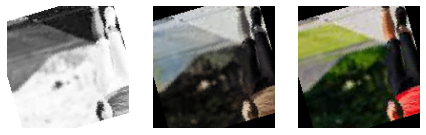

Epoch 2311 	 Loss: min = 0.0020172635558992624; average = 0.0025389184447703883; max = 0.00348195293918252
Epoch 2312 	 Loss: min = 0.0021684267558157444; average = 0.0024131251557264477; max = 0.002767866011708975
Epoch 2313 	 Loss: min = 0.0020625214092433453; average = 0.0026498102088226005; max = 0.003707051044330001
Epoch 2314 	 Loss: min = 0.002210234059020877; average = 0.0026310999965062365; max = 0.003072066232562065
Epoch 2315 	 Loss: min = 0.002226357813924551; average = 0.0024895685055525973; max = 0.003258454380556941


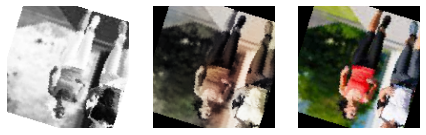

Epoch 2316 	 Loss: min = 0.002080342499539256; average = 0.0023796961904736236; max = 0.0029940165113657713
Epoch 2317 	 Loss: min = 0.0019368830835446715; average = 0.002407638785371091; max = 0.0029754377901554108
Epoch 2318 	 Loss: min = 0.002115397248417139; average = 0.0025244396383641288; max = 0.0036064512096345425
Epoch 2319 	 Loss: min = 0.0021098973229527473; average = 0.002490436105290428; max = 0.00290679931640625
Epoch 2320 	 Loss: min = 0.0021685692481696606; average = 0.0024904956808313727; max = 0.0029292579274624586


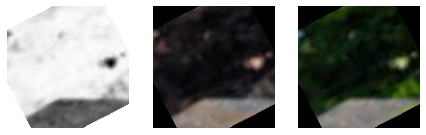

Epoch 2321 	 Loss: min = 0.0019796371925622225; average = 0.0023991963535081595; max = 0.002680831588804722
Epoch 2322 	 Loss: min = 0.002111104317009449; average = 0.002590338495792821; max = 0.003446171060204506
Epoch 2323 	 Loss: min = 0.0021110931411385536; average = 0.0024131451355060562; max = 0.0029807528480887413
Epoch 2324 	 Loss: min = 0.002202243311330676; average = 0.002462553617078811; max = 0.002884521149098873
Epoch 2325 	 Loss: min = 0.0021806787699460983; average = 0.00255678356916178; max = 0.0030126431956887245


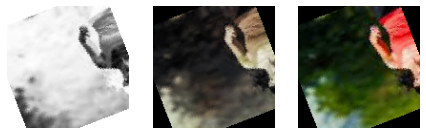

Epoch 2326 	 Loss: min = 0.0020731990225613117; average = 0.002397358533926308; max = 0.002753565786406398
Epoch 2327 	 Loss: min = 0.0020788570400327444; average = 0.002445407342747785; max = 0.0028141457587480545
Epoch 2328 	 Loss: min = 0.0019586021080613136; average = 0.0024173177225748077; max = 0.0031230333261191845
Epoch 2329 	 Loss: min = 0.0022495342418551445; average = 0.0025899487227434292; max = 0.003412403166294098
Epoch 2330 	 Loss: min = 0.0020715221762657166; average = 0.0023897875944385305; max = 0.0026889038272202015


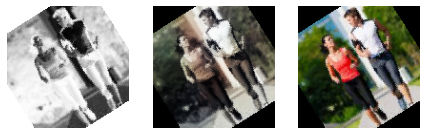

Epoch 2331 	 Loss: min = 0.0021403071004897356; average = 0.0025073007709579542; max = 0.002924784552305937
Epoch 2332 	 Loss: min = 0.001993658486753702; average = 0.0025477715680608526; max = 0.0036649710964411497
Epoch 2333 	 Loss: min = 0.001973062288016081; average = 0.002427968502161093; max = 0.0029520101379603148
Epoch 2334 	 Loss: min = 0.0020264035556465387; average = 0.0025162039673887193; max = 0.0030715875327587128
Epoch 2335 	 Loss: min = 0.0021387035958468914; average = 0.0026013780006906018; max = 0.0034118876792490482


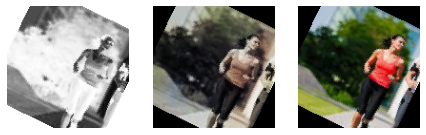

Epoch 2336 	 Loss: min = 0.0018666530959308147; average = 0.0023657584897591732; max = 0.002850361866876483
Epoch 2337 	 Loss: min = 0.0021508235950022936; average = 0.0025383731408510357; max = 0.0031936517916619778
Epoch 2338 	 Loss: min = 0.002073585754260421; average = 0.002576896848040633; max = 0.0032299794256687164
Epoch 2339 	 Loss: min = 0.002050688024610281; average = 0.0024347485887119547; max = 0.0035656820982694626
Epoch 2340 	 Loss: min = 0.001979619963094592; average = 0.0024519002035958692; max = 0.0029034074395895004


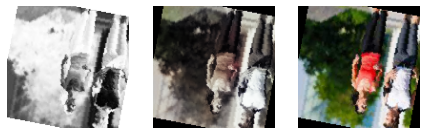

Epoch 2341 	 Loss: min = 0.002038009464740753; average = 0.002535099149099551; max = 0.003288084641098976
Epoch 2342 	 Loss: min = 0.0018109576776623726; average = 0.0024174516438506544; max = 0.003289921907708049
Epoch 2343 	 Loss: min = 0.0021241046488285065; average = 0.0024161721958080307; max = 0.0027956347912549973
Epoch 2344 	 Loss: min = 0.0021722842939198017; average = 0.0024310587759828195; max = 0.0029539165552705526
Epoch 2345 	 Loss: min = 0.002090499736368656; average = 0.0026276780699845403; max = 0.003488739486783743


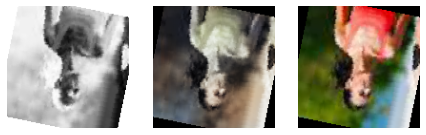

Epoch 2346 	 Loss: min = 0.002059856429696083; average = 0.002566378825576976; max = 0.0035246992483735085
Epoch 2347 	 Loss: min = 0.0019572374876588583; average = 0.00256062627886422; max = 0.003257281146943569
Epoch 2348 	 Loss: min = 0.002144313883036375; average = 0.002506190096028149; max = 0.0028749005869030952
Epoch 2349 	 Loss: min = 0.002108161337673664; average = 0.0026258885191055015; max = 0.0042279502376914024
Epoch 2350 	 Loss: min = 0.0020475969649851322; average = 0.0025142202503047884; max = 0.003726661205291748


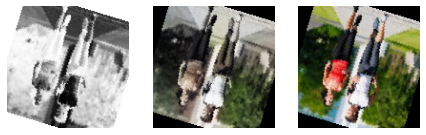

Epoch 2351 	 Loss: min = 0.002059660851955414; average = 0.0024727046984480694; max = 0.0033285829704254866
Epoch 2352 	 Loss: min = 0.0022482078056782484; average = 0.0026122400886379182; max = 0.003276793984696269
Epoch 2353 	 Loss: min = 0.0020605619065463543; average = 0.0025433495902689174; max = 0.0034180739894509315
Epoch 2354 	 Loss: min = 0.0021524217445403337; average = 0.0025143843959085643; max = 0.0031085133086889982
Epoch 2355 	 Loss: min = 0.0019307918846607208; average = 0.002408105501672253; max = 0.0029413211159408092


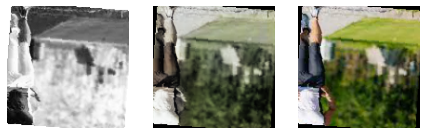

Epoch 2356 	 Loss: min = 0.0019097737967967987; average = 0.0025205450074281543; max = 0.0037853531539440155
Epoch 2357 	 Loss: min = 0.002109784632921219; average = 0.0025169541186187416; max = 0.003007288556545973
Epoch 2358 	 Loss: min = 0.002252180129289627; average = 0.0027069462812505662; max = 0.003576591145247221
Epoch 2359 	 Loss: min = 0.002005751710385084; average = 0.0024881219724193215; max = 0.0031914152204990387
Epoch 2360 	 Loss: min = 0.0019158876966685057; average = 0.0024305076512973756; max = 0.003126615658402443


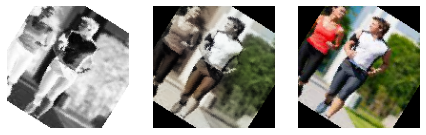

Epoch 2361 	 Loss: min = 0.0021175260189920664; average = 0.0024842946004355326; max = 0.0029626123141497374
Epoch 2362 	 Loss: min = 0.001984009752050042; average = 0.0024334299814654514; max = 0.002823340240865946
Epoch 2363 	 Loss: min = 0.0020086185541003942; average = 0.0024998175649670884; max = 0.0041212355718016624
Epoch 2364 	 Loss: min = 0.0019586076959967613; average = 0.0024731260491535068; max = 0.0028977170586586
Epoch 2365 	 Loss: min = 0.0021471246145665646; average = 0.00242835191602353; max = 0.0027174546848982573


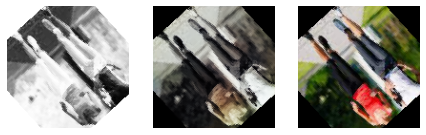

Epoch 2366 	 Loss: min = 0.0021448261104524136; average = 0.002573059347923845; max = 0.003820435842499137
Epoch 2367 	 Loss: min = 0.0019835212733596563; average = 0.002502455245121382; max = 0.002984563587233424
Epoch 2368 	 Loss: min = 0.0021486503537744284; average = 0.002457217633491382; max = 0.002959479345008731
Epoch 2369 	 Loss: min = 0.0020633141975849867; average = 0.0023951039038365707; max = 0.003043533768504858
Epoch 2370 	 Loss: min = 0.0020565062295645475; average = 0.0024882156867533922; max = 0.0028241206891834736


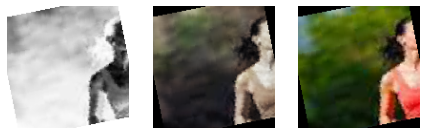

Epoch 2371 	 Loss: min = 0.0018833004869520664; average = 0.002429362357361242; max = 0.002885138150304556
Epoch 2372 	 Loss: min = 0.0020248782820999622; average = 0.0023755226720822975; max = 0.0028415401466190815
Epoch 2373 	 Loss: min = 0.00213829567655921; average = 0.002426587321679108; max = 0.002803266979753971
Epoch 2374 	 Loss: min = 0.002014666795730591; average = 0.002598265098640695; max = 0.0030157463625073433
Epoch 2375 	 Loss: min = 0.0019370252266526222; average = 0.0025087068788707256; max = 0.003694751998409629


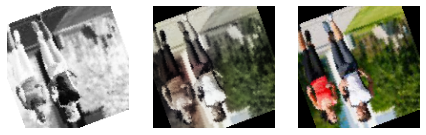

Epoch 2376 	 Loss: min = 0.0019309204071760178; average = 0.0025432905240450054; max = 0.0032109459862113
Epoch 2377 	 Loss: min = 0.0020796542521566153; average = 0.002606644295156002; max = 0.003676516469568014
Epoch 2378 	 Loss: min = 0.0020107137970626354; average = 0.0023920230160001665; max = 0.0028336604591459036
Epoch 2379 	 Loss: min = 0.002073117531836033; average = 0.002466034595272504; max = 0.003265183884650469
Epoch 2380 	 Loss: min = 0.001962417270988226; average = 0.0024054449604591355; max = 0.0031408960931003094


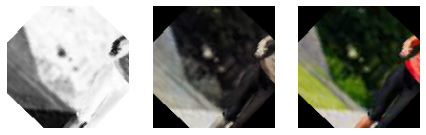

Epoch 2381 	 Loss: min = 0.0020272342953830957; average = 0.0024183793284464628; max = 0.0034274766221642494
Epoch 2382 	 Loss: min = 0.002044238615781069; average = 0.0024112166720442474; max = 0.0030204260256141424
Epoch 2383 	 Loss: min = 0.00211614603176713; average = 0.0024195794976549223; max = 0.0027785832062363625
Epoch 2384 	 Loss: min = 0.002121225232258439; average = 0.002359769612667151; max = 0.0029282502364367247
Epoch 2385 	 Loss: min = 0.0018135387217625976; average = 0.002352857634832617; max = 0.0027709342539310455


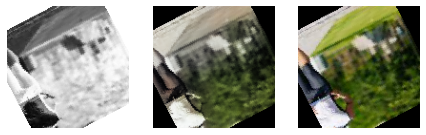

Epoch 2386 	 Loss: min = 0.0020913882181048393; average = 0.0025432990805711597; max = 0.0030155943240970373
Epoch 2387 	 Loss: min = 0.0019726569298654795; average = 0.0024483706074533984; max = 0.003748680930584669
Epoch 2388 	 Loss: min = 0.0019923795480281115; average = 0.0024617484741611406; max = 0.0029585768934339285
Epoch 2389 	 Loss: min = 0.0020904475823044777; average = 0.0023928716545924544; max = 0.002756956499069929
Epoch 2390 	 Loss: min = 0.002134152455255389; average = 0.002531781210564077; max = 0.0028316364623606205


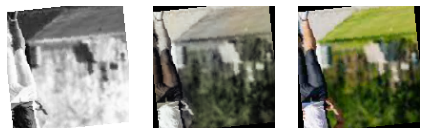

Epoch 2391 	 Loss: min = 0.0021950192749500275; average = 0.0029194883682066575; max = 0.0038763917982578278
Epoch 2392 	 Loss: min = 0.0020935162901878357; average = 0.0024713985330890864; max = 0.002841094508767128
Epoch 2393 	 Loss: min = 0.002079928992316127; average = 0.002456512986100279; max = 0.003013572422787547
Epoch 2394 	 Loss: min = 0.002033478580415249; average = 0.002434765119687654; max = 0.0030085546895861626
Epoch 2395 	 Loss: min = 0.001927599310874939; average = 0.002350923343328759; max = 0.0030153649859130383


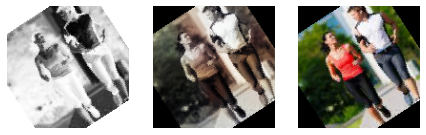

Epoch 2396 	 Loss: min = 0.0020856554619967937; average = 0.002654880314366892; max = 0.003745154244825244
Epoch 2397 	 Loss: min = 0.0018782917177304626; average = 0.0023806196622899733; max = 0.0029364447109401226
Epoch 2398 	 Loss: min = 0.002103919629007578; average = 0.0024289622233482078; max = 0.0027386657893657684
Epoch 2399 	 Loss: min = 0.001911473460495472; average = 0.0023872047822806053; max = 0.0032633780501782894
Epoch 2400 	 Loss: min = 0.0018829924520105124; average = 0.0023677274875808507; max = 0.0029920581728219986


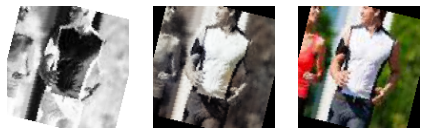

Epoch 2401 	 Loss: min = 0.001960866153240204; average = 0.0023982929560588673; max = 0.00314088212326169
Epoch 2402 	 Loss: min = 0.002047720830887556; average = 0.0024325080739799887; max = 0.002895915415138006
Epoch 2403 	 Loss: min = 0.0019704378210008144; average = 0.002432704670354724; max = 0.00325002521276474
Epoch 2404 	 Loss: min = 0.0021332078613340855; average = 0.002360538623179309; max = 0.002558549400418997
Epoch 2405 	 Loss: min = 0.001967946533113718; average = 0.0024653489963384345; max = 0.0030862409621477127


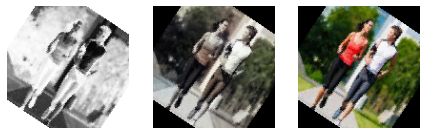

Epoch 2406 	 Loss: min = 0.002109730150550604; average = 0.0023967486195033416; max = 0.0028265146538615227
Epoch 2407 	 Loss: min = 0.0018153497949242592; average = 0.0023487858852604404; max = 0.0028559137135744095
Epoch 2408 	 Loss: min = 0.0019783535972237587; average = 0.0023917671060189605; max = 0.0026730457320809364
Epoch 2409 	 Loss: min = 0.002018896397203207; average = 0.0024902318109525368; max = 0.003185491543263197
Epoch 2410 	 Loss: min = 0.00204365118406713; average = 0.00232492973736953; max = 0.0026970289181917906


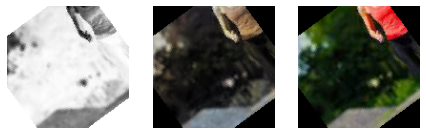

Epoch 2411 	 Loss: min = 0.0019445441430434585; average = 0.0023697307406109758; max = 0.0029454915784299374
Epoch 2412 	 Loss: min = 0.0020419289357960224; average = 0.002397671341896057; max = 0.002855493687093258
Epoch 2413 	 Loss: min = 0.0018958667060360312; average = 0.0024024478552746587; max = 0.0028991680592298508
Epoch 2414 	 Loss: min = 0.0020024531986564398; average = 0.002428413223242387; max = 0.0030933041125535965
Epoch 2415 	 Loss: min = 0.002070996444672346; average = 0.0023905310808913782; max = 0.0029138147365301847


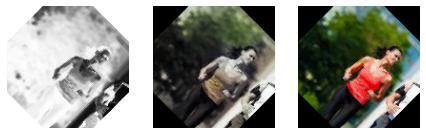

Epoch 2416 	 Loss: min = 0.0018678698688745499; average = 0.0023661857121624053; max = 0.0028001866303384304
Epoch 2417 	 Loss: min = 0.002024088753387332; average = 0.002416362884105183; max = 0.002778481226414442
Epoch 2418 	 Loss: min = 0.002050100127235055; average = 0.002530898404074833; max = 0.003102693473920226
Epoch 2419 	 Loss: min = 0.0018956786952912807; average = 0.0023681503371335566; max = 0.0027592461556196213
Epoch 2420 	 Loss: min = 0.002056634286418557; average = 0.002386155494605191; max = 0.002862890250980854


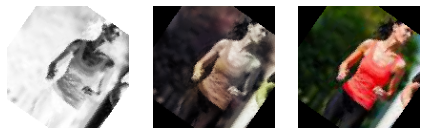

Epoch 2421 	 Loss: min = 0.002062777057290077; average = 0.002392813825281337; max = 0.0032645368482917547
Epoch 2422 	 Loss: min = 0.002003172878175974; average = 0.002595974496216513; max = 0.0035675643011927605
Epoch 2423 	 Loss: min = 0.002029980532824993; average = 0.0023980884725460783; max = 0.0027535816188901663
Epoch 2424 	 Loss: min = 0.0019457894377410412; average = 0.0024289866123581305; max = 0.0031889311503618956
Epoch 2425 	 Loss: min = 0.0021167106460779905; average = 0.00252141612872947; max = 0.0029710594099014997


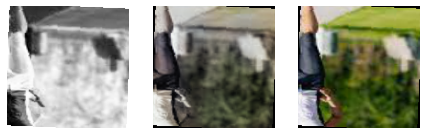

Epoch 2426 	 Loss: min = 0.0018662083894014359; average = 0.0024415917287115008; max = 0.0030130473896861076
Epoch 2427 	 Loss: min = 0.0020139180123806; average = 0.002377775206696242; max = 0.002961505204439163
Epoch 2428 	 Loss: min = 0.0021802508272230625; average = 0.0025032160338014364; max = 0.0034231063909828663
Epoch 2429 	 Loss: min = 0.0019188220612704754; average = 0.002393699687672779; max = 0.002785012824460864
Epoch 2430 	 Loss: min = 0.0019634633790701628; average = 0.002358847385039553; max = 0.0028484445065259933


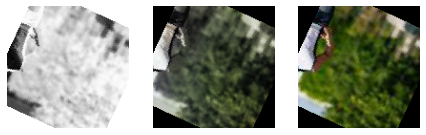

Epoch 2431 	 Loss: min = 0.001988711068406701; average = 0.002308575334609486; max = 0.0031659051310271025
Epoch 2432 	 Loss: min = 0.0019064312800765038; average = 0.002389856570516713; max = 0.002949210349470377
Epoch 2433 	 Loss: min = 0.0018567971419543028; average = 0.0024315795017173514; max = 0.0029990612529218197
Epoch 2434 	 Loss: min = 0.002243309747427702; average = 0.002541015390306711; max = 0.003062410280108452
Epoch 2435 	 Loss: min = 0.0018869101768359542; average = 0.0024533684700145386; max = 0.0035403985530138016


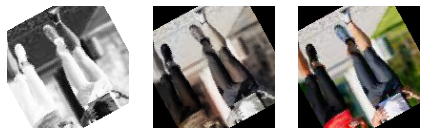

Epoch 2436 	 Loss: min = 0.0020201848819851875; average = 0.0025640991370892152; max = 0.003488789778202772
Epoch 2437 	 Loss: min = 0.00213792035356164; average = 0.002511318161850795; max = 0.002806585980579257
Epoch 2438 	 Loss: min = 0.002018556697294116; average = 0.0023965771833900362; max = 0.003090187907218933
Epoch 2439 	 Loss: min = 0.0019362452439963818; average = 0.0024381990515394136; max = 0.002987530082464218
Epoch 2440 	 Loss: min = 0.0020102558191865683; average = 0.0023660124570596963; max = 0.002852902514860034


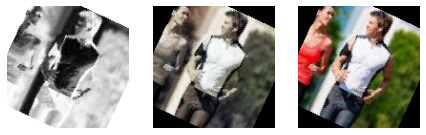

Epoch 2441 	 Loss: min = 0.0020440639927983284; average = 0.0024941685842350125; max = 0.0028743790462613106
Epoch 2442 	 Loss: min = 0.0019220284884795547; average = 0.002278052481415216; max = 0.002586887450888753
Epoch 2443 	 Loss: min = 0.002037702826783061; average = 0.0022730804048478603; max = 0.0026180497370660305
Epoch 2444 	 Loss: min = 0.0019140110816806555; average = 0.002446500409860164; max = 0.003160924417898059
Epoch 2445 	 Loss: min = 0.0020212954841554165; average = 0.0026404912350699306; max = 0.003381355432793498


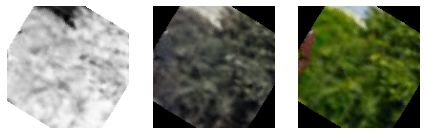

Epoch 2446 	 Loss: min = 0.002045911271125078; average = 0.0024329475563718006; max = 0.002940069418400526
Epoch 2447 	 Loss: min = 0.0020543038845062256; average = 0.002384296603850089; max = 0.0028729639016091824
Epoch 2448 	 Loss: min = 0.00213552825152874; average = 0.0024272662412840873; max = 0.0029892083257436752
Epoch 2449 	 Loss: min = 0.001994775142520666; average = 0.002489154605427757; max = 0.00329539249651134
Epoch 2450 	 Loss: min = 0.002116075251251459; average = 0.0023950839531607926; max = 0.0028172682505100965


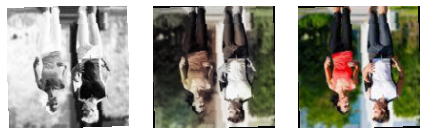

Epoch 2451 	 Loss: min = 0.0021559949964284897; average = 0.0025467192754149437; max = 0.0031317221000790596
Epoch 2452 	 Loss: min = 0.00202643359079957; average = 0.002512836523237638; max = 0.0034281290136277676
Epoch 2453 	 Loss: min = 0.0021654872689396143; average = 0.002368127243244089; max = 0.002694754395633936
Epoch 2454 	 Loss: min = 0.0019690010230988264; average = 0.002527684497181326; max = 0.0035196426324546337
Epoch 2455 	 Loss: min = 0.0020695715211331844; average = 0.002569596210378222; max = 0.003274190239608288


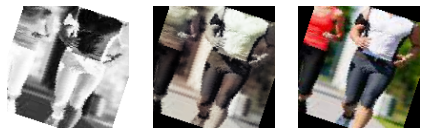

Epoch 2456 	 Loss: min = 0.0021212634164839983; average = 0.002559947723057121; max = 0.003173702396452427
Epoch 2457 	 Loss: min = 0.001975304912775755; average = 0.002416374394670129; max = 0.0032303084153681993
Epoch 2458 	 Loss: min = 0.002014739438891411; average = 0.0023550479527330026; max = 0.003040407318621874
Epoch 2459 	 Loss: min = 0.0020136479288339615; average = 0.002349264483200386; max = 0.003310029860585928
Epoch 2460 	 Loss: min = 0.0021388947498053312; average = 0.0024761079694144428; max = 0.003459794446825981


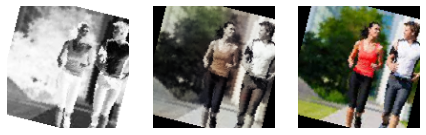

Epoch 2461 	 Loss: min = 0.002126450417563319; average = 0.002456917893141508; max = 0.0027834628708660603
Epoch 2462 	 Loss: min = 0.0021091941744089127; average = 0.002540419765864499; max = 0.004294301848858595
Epoch 2463 	 Loss: min = 0.0020423023961484432; average = 0.0025900669425027445; max = 0.003606704995036125
Epoch 2464 	 Loss: min = 0.0020383389201015234; average = 0.002528780241846107; max = 0.0031525790691375732
Epoch 2465 	 Loss: min = 0.002090123249217868; average = 0.002642820414621383; max = 0.0036763418465852737


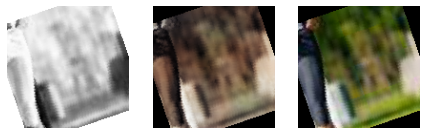

Epoch 2466 	 Loss: min = 0.0020345011726021767; average = 0.00241638466832228; max = 0.002956739626824856
Epoch 2467 	 Loss: min = 0.0023053500335663557; average = 0.0024959018192021176; max = 0.0028055484872311354
Epoch 2468 	 Loss: min = 0.0020726360380649567; average = 0.0024251804570667446; max = 0.00297368667088449
Epoch 2469 	 Loss: min = 0.0019397888099774718; average = 0.0023329151663347147; max = 0.0026600039564073086
Epoch 2470 	 Loss: min = 0.0020629088394343853; average = 0.0023901186214061454; max = 0.002652173861861229


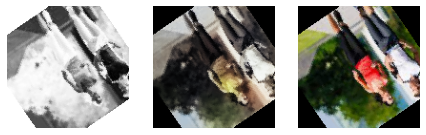

Epoch 2471 	 Loss: min = 0.0018878447590395808; average = 0.002483179654518608; max = 0.0036218389868736267
Epoch 2472 	 Loss: min = 0.001681043184362352; average = 0.0023316298975259997; max = 0.002634931355714798
Epoch 2473 	 Loss: min = 0.0019158864160999656; average = 0.0024137332875397988; max = 0.0030769433360546827
Epoch 2474 	 Loss: min = 0.0019790164660662413; average = 0.002384718769462779; max = 0.0029730084352195263
Epoch 2475 	 Loss: min = 0.0021404901053756475; average = 0.002421544078970328; max = 0.003008452244102955


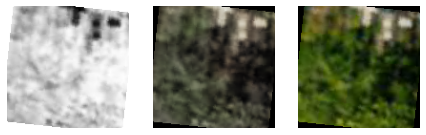

Epoch 2476 	 Loss: min = 0.0019790413789451122; average = 0.002421288227196783; max = 0.0032069417648017406
Epoch 2477 	 Loss: min = 0.0019546314142644405; average = 0.002446859798510559; max = 0.0036029480397701263
Epoch 2478 	 Loss: min = 0.0020433070603758097; average = 0.0023710443056188524; max = 0.003323100507259369
Epoch 2479 	 Loss: min = 0.0020315356086939573; average = 0.002468253587721847; max = 0.0028462547343224287
Epoch 2480 	 Loss: min = 0.0018941350281238556; average = 0.002334357486688532; max = 0.0030030570924282074


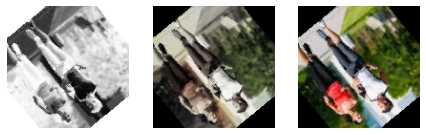

Epoch 2481 	 Loss: min = 0.0020263490732759237; average = 0.002364815416513011; max = 0.0028447583317756653
Epoch 2482 	 Loss: min = 0.0019004193600267172; average = 0.0023896454222267494; max = 0.0036732580047100782
Epoch 2483 	 Loss: min = 0.002089929999783635; average = 0.00246448369580321; max = 0.003293297253549099
Epoch 2484 	 Loss: min = 0.0020415466278791428; average = 0.0023290851822821423; max = 0.0029106405563652515
Epoch 2485 	 Loss: min = 0.0018090823432430625; average = 0.0024074230386759154; max = 0.0029408230911940336


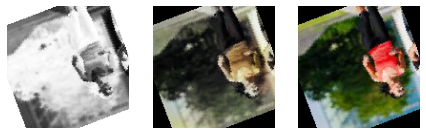

Epoch 2486 	 Loss: min = 0.0021434100344777107; average = 0.0024547229695599526; max = 0.003241609549149871
Epoch 2487 	 Loss: min = 0.0020100772380828857; average = 0.002440734169795178; max = 0.0031828004866838455
Epoch 2488 	 Loss: min = 0.002040420426055789; average = 0.002392076115938835; max = 0.0030154422856867313
Epoch 2489 	 Loss: min = 0.002022898755967617; average = 0.0024179933971026912; max = 0.0030730299185961485
Epoch 2490 	 Loss: min = 0.002104183891788125; average = 0.0023605276219313964; max = 0.002770972903817892


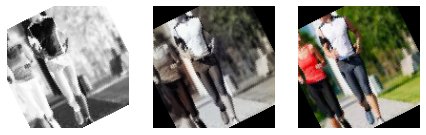

Epoch 2491 	 Loss: min = 0.0017806024989113212; average = 0.002549573175201658; max = 0.0036224292125552893
Epoch 2492 	 Loss: min = 0.0021927221678197384; average = 0.0027246283716522157; max = 0.0034301881678402424
Epoch 2493 	 Loss: min = 0.002133951522409916; average = 0.0025925572408596054; max = 0.0030265531968325377
Epoch 2494 	 Loss: min = 0.0019142169039696455; average = 0.002448686136631295; max = 0.0030080953147262335
Epoch 2495 	 Loss: min = 0.0021887733601033688; average = 0.002568111798609607; max = 0.003562352154403925


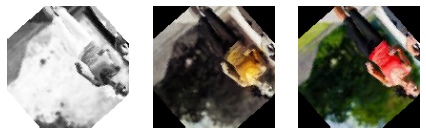

Epoch 2496 	 Loss: min = 0.0020134816877543926; average = 0.002602375519927591; max = 0.003371426835656166
Epoch 2497 	 Loss: min = 0.0018904213793575764; average = 0.002430324340821244; max = 0.0028138679917901754
Epoch 2498 	 Loss: min = 0.0019751887302845716; average = 0.002473756539984606; max = 0.003102213144302368
Epoch 2499 	 Loss: min = 0.0020549497567117214; average = 0.0024042902659857646; max = 0.003134890226647258


In [ ]:
PATH = "resNet.pt"

try:
  checkpoint = torch.load(PATH)
  resNet.load_state_dict(checkpoint['model_state_dict'])
  optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
  last_epoch = checkpoint['epoch']
  history = checkpoint['history']
  print('Loaded resNet')
except:
  history = {}
  last_epoch = 0

for epoch in range(last_epoch, num_epochs):
    cur_history = []
    for x, y in loader:
        # теперь сами:
        # 0. распакавать данные на нужное устройство
        x = x.to(device)
        y = y.to(device)

        # 1. сбросить градиент
        optimizer.zero_grad()

        # 2. прогнать данные через сеть
        pred = resNet(x)

        # 3. посчитать loss
        loss = criterion(pred, y)        

        # 4. залоггировать его куда-нибудь
        cur_history.append(loss.item())

        # 5. сделать .backward()
        loss.backward()

        # 6. optimizer.step()
        optimizer.step()
    
        # Освобождение памяти
        del pred
        del x
        del y
        torch.cuda.empty_cache() # Чтобы GPU не заполнялся мусором
    
    history[epoch] = np.average(cur_history)
    print(f'Epoch {epoch} \t Loss: min = {np.min(cur_history)}; average = {np.average(cur_history)}; max = {np.max(cur_history)}')
    # Off dropouts and batchNorm
    resNet.eval()

    if epoch % 5 == 0:
      plot_to_compare(resNet)

    # On dropouts and batchNorm
    resNet.train()

    # save checkpoint
    torch.save({'epoch': epoch + 1,
                'model_state_dict': resNet.state_dict(),
                'optimizer_state_dict': optimizer.state_dict(),
                'history': history,
                }, PATH)

## Loss graph

Text(0.5, 0, 'Epoch')

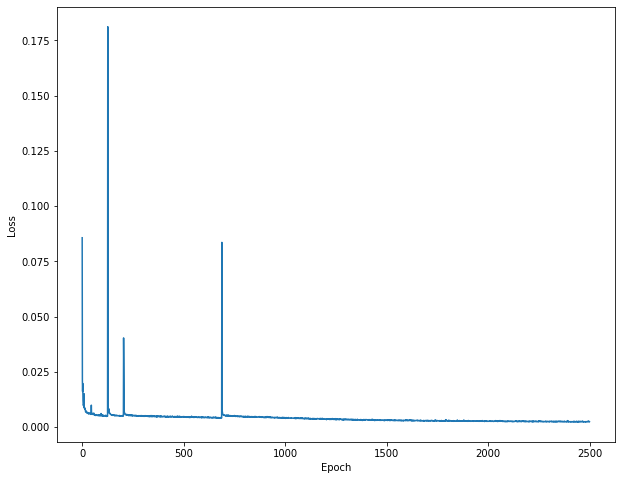

In [ ]:
lists = sorted(history.items()) # sorted by key, return a list of tuples
x, y = zip(*lists)

plt.figure(figsize=(10,8))
plt.plot(x, y)
plt.ylabel('Loss')
plt.xlabel('Epoch')

## Colorize image by ResNet model

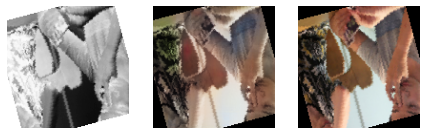

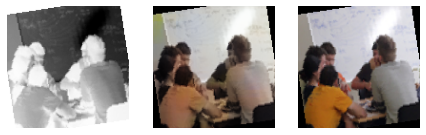

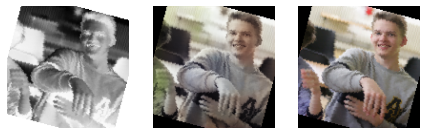

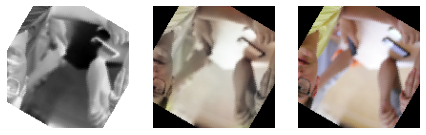

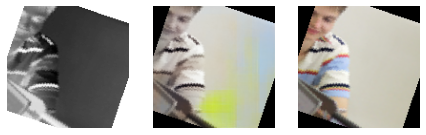

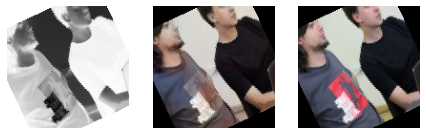

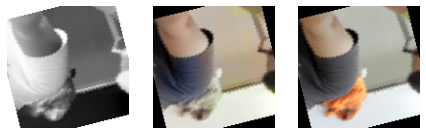

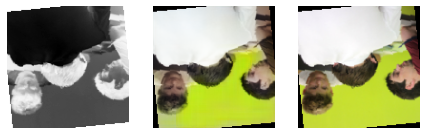

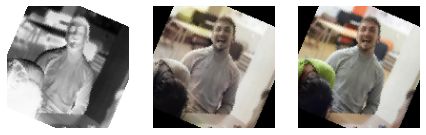

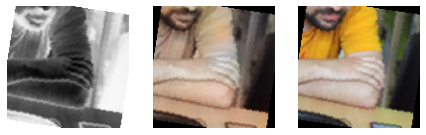

In [ ]:
for t in range(10):
    img_gray, img_true = dataset[t]
    resNet.eval()
    img_pred = resNet(img_gray.to(device).view(1, 1, 128, 128))
    img_pred = to_numpy_image(img_pred)
    # теперь это numpy-евский ndarray размера (128, 128, 3)
    plt.figure(figsize=(10,10))
    
    plt.subplot(141)
    plt.axis('off')
    plt.set_cmap('Greys')
    plt.imshow(img_gray.reshape((128, 128)))

    plt.subplot(142)
    plt.axis('off')
    plt.imshow(img_pred.reshape((128, 128, 3)))

    plt.subplot(143)
    plt.axis('off')
    plt.imshow(to_numpy_image(img_true))
    
    plt.show()

С ResNet полуаются тускловатые цвета, но лучше определяются границы элементов, и отсутствуют яркие блики

## *Тизер: adversarial loss

У нашего подхода к колоризации есть одна весьма существенная проблема: непонятно, как определять функцию потерь. Выясняется, что l1 или l2 в некоторых случаях даже являются принципиально неправильным выбором. Представьте, что у нас есть датасет фотографий с летнего лагеря, в котором все люди ходят в футболках двух разных цветов — например, красного и синего — интенсивность которых одинакова и неотличима на черно-белых версиях. Тогда наш лосс заставит сеть выбирать что-то «по середине» (в случае с l2 это будет среднее, а с l1 медиана), и, скорее всего, она сгенерирует что-то серое, в то время как она должна с какой-то вероятностью сгенерировать явно красную или явно синюю футболку.

Решение в следующем: выход (колоризованное изображение) кормить в другую сеть, которая учится определять «правдоподобность» раскраски. Помимо восстановления изображения с точки зрения какой-то меры близости, сети-генератору (колоризатору) нужно ещё и обмануть сеть-дискриминатор, а сети-дискриминатору нужно наоборот, учиться отличать настоящую колоризацию от нашей.

Подобные схемы с двумя состязяющимися сетями называют GAN-ам (Generative Adversarial Networks), о которых мы поговорим через занятие.